In [16]:
import nibabel
import os
from pathlib import Path
import numpy as np

In [17]:
def parse_labels(raw_csv_file, output_file):
    
    import csv
    csv_columns = ['run','trial','global time', 'run time', 'morph level', 'couple', 'response', 'response time']
    csv_file = output_file
    
    f = open(raw_csv_file)
    all_lines = f.readlines()
    
    to_be_added = []
    morph_level = None
    couple = None
    is_complete = False
    new_morph = False
    nb_item = 0
    nb_run = 0
    first_morph = True
    
    def get_indices(all_lines, to_find='Debut_run '):
        indices = []
        for count, line in enumerate(all_lines):
            if line.find(to_find) > -1:
                indices += [count]
        return indices + [len(all_lines)]
    
    run_starts = get_indices(all_lines, 'Debut_run ')
    
    for nb_run in range(len(run_starts) - 1):
        
        run_start = run_starts[nb_run]
        run_stop = run_starts[nb_run + 1]
        
        sub_lines = all_lines[run_start:run_stop]
        
        for line in sub_lines:
            if line.find('Synchro_IRM') > -1:
                global_t_start = int(line.split(',')[0])

        morph_starts = get_indices(sub_lines, 'MORPH')
        morph_starts += [run_stop - morph_starts[-1]]
        
        for nb_item in range(len(morph_starts)-1):
        
            morph_start = morph_starts[nb_item]
            morph_stop = morph_starts[nb_item + 1]
            response = 0
            response_time = None
        
            for line in sub_lines[morph_start:morph_stop]:
                if line.find('morph_') > -1:
                    file_name = line.split(',')[3].split(' ')[1]
                    file_name = file_name.split("\\")[2]
                    morph_level = int(file_name.split('_')[1])
                    couple = int(file_name.split('_')[2].split('.')[0])
                    t_start = int(line.split(',')[3].split(' ')[2])

                if line.find('bouton_1') > -1:
                    response = 1
                    response_time = int(line.split(',')[3].split(' ')[1]) + 500

            to_add = {'run' : nb_run + 1, 
                      'trial' : nb_item + 1,
                       'global time' : t_start, 
                       'run time' :  t_start - global_t_start,
                       'morph level' : morph_level,
                       'couple' : couple, 
                       'response' : response, 
                       'response time' : response_time}
            to_be_added += [to_add]

    try:
        with open(output_file, 'w') as csvfile:
            writer = csv.DictWriter(csvfile, fieldnames=csv_columns)
            writer.writeheader()
            for data in to_be_added:
                writer.writerow(data)
    except IOError:
        print("I/O error")

In [18]:
for file in os.listdir(Path("labels/raw")):
    parse_labels(Path("labels/raw") / file, Path("labels") / file)

In [19]:
def view_results(subject=1, run='all', return_data=False, do_plot=True):

    import pandas
    from pathlib import Path

    labels = pandas.read_csv(f'labels/labels_{subject}.csv')
    
    if run == 'all':
        x = labels['morph level']
        y = labels['response']
        z = labels['response time']
    elif run in range(1, 5):
        mask = labels['run'] == run
        x = labels[mask]['morph level']
        y = labels[mask]['response']
        z = labels[mask]['response time']
    
    import pylab as plt
    values, counts = np.unique(x, return_counts=True)

    results = {}
    results['response'] = {'mean' : np.zeros(len(values)), 'std' : np.zeros(len(values))}
    results['response_time'] = {'mean' : np.zeros(len(values)), 'std' : np.zeros(len(values))}
    for count, v in enumerate(values):
        mask = (x == v)
        results['response']['mean'][count] = np.mean(y[mask])
        results['response']['std'][count] = np.std(y[mask])/np.sqrt(np.sum(mask))

        results['response_time']['mean'][count] = np.mean(z[mask])
        results['response_time']['std'][count] = np.std(z[mask])/np.sqrt(np.sum(mask))

    if do_plot:
        fig, ax = plt.subplots(ncols=2, squeeze=False, figsize=(15,5))
        ax[0,0].plot(values, results['response']['mean'])
        ax[0,0].fill_between(values, results['response']['mean'] - results['response']['std'], 
                         results['response']['mean'] + results['response']['std'], alpha=0.25)
        ax[0,0].set_xlabel('% morph')
        ax[0,0].set_ylabel('response')

        ax[0,1].plot(values, results['response_time']['mean'])
        ax[0,1].fill_between(values, results['response_time']['mean'] - results['response_time']['std'], 
                         results['response_time']['mean'] + results['response_time']['std'], alpha=0.25)
        ax[0,1].set_xlabel('% morph')
        ax[0,1].set_ylabel('response time (ms)')
    
    if return_data:
        return results

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\1364467249.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(ncols=2, squeeze=False, figsize=(15,5))


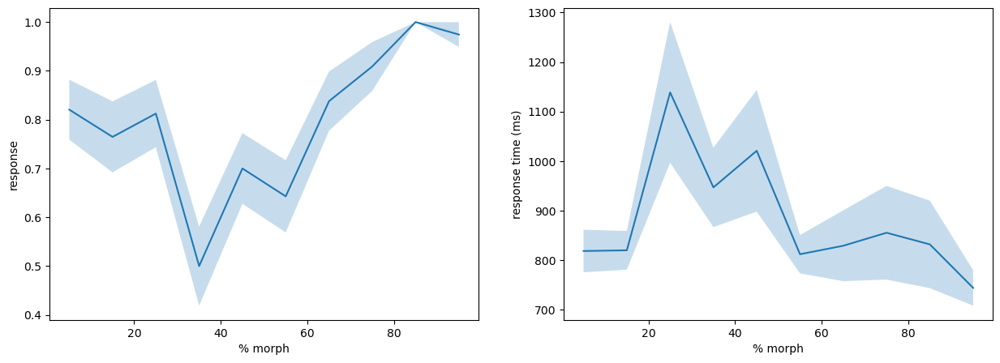

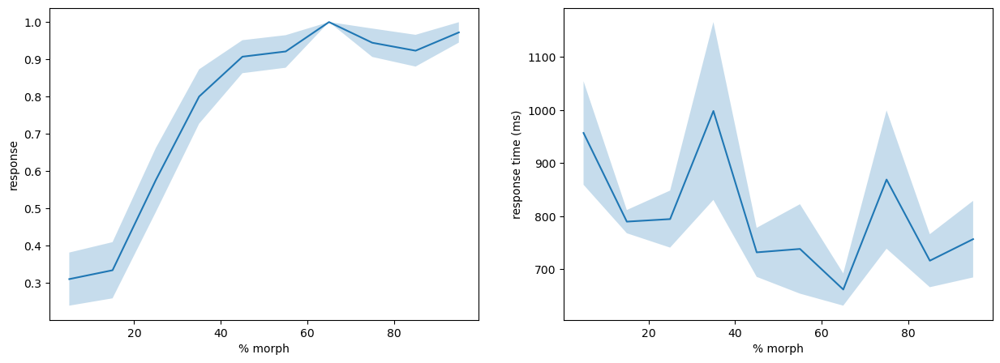

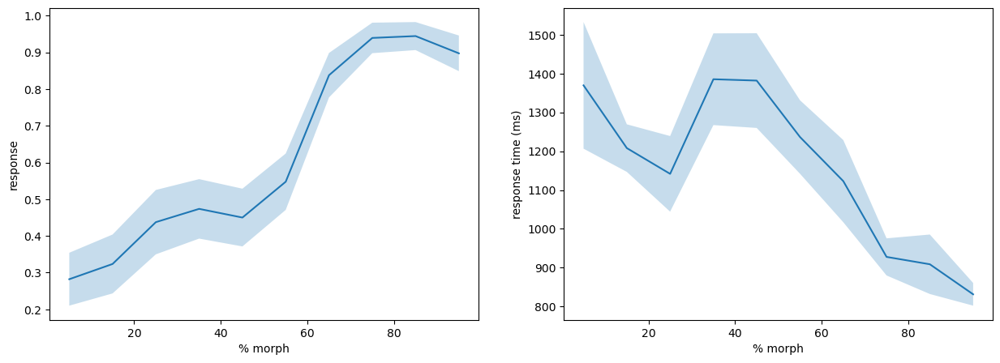

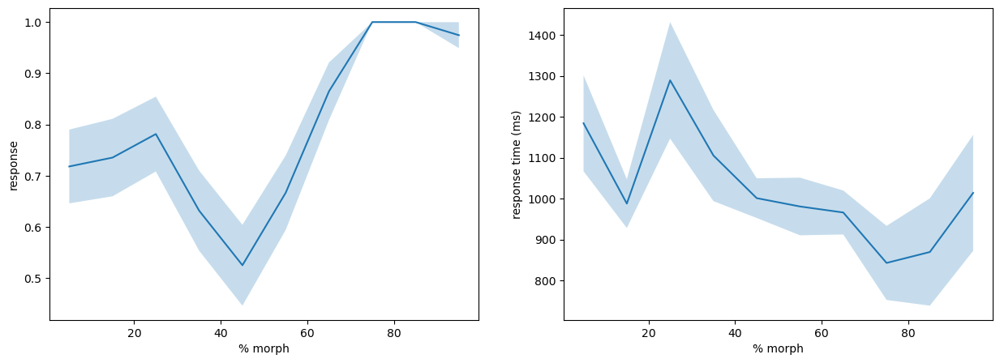

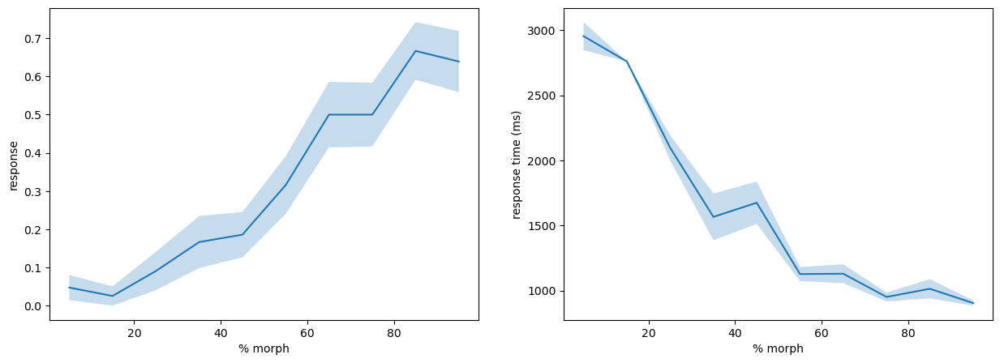

...

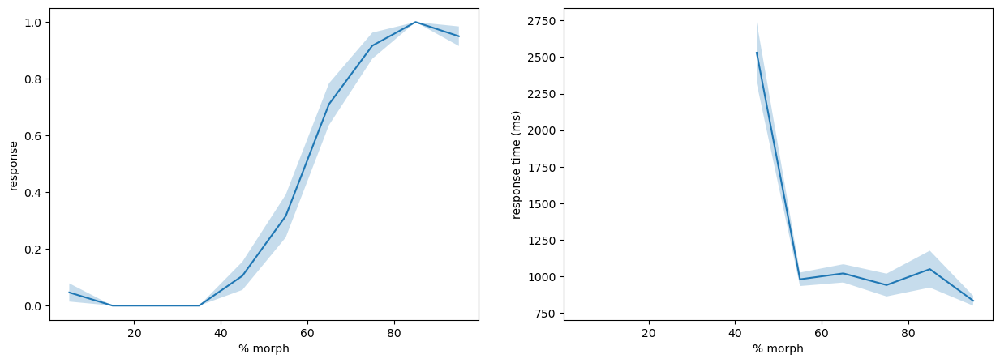

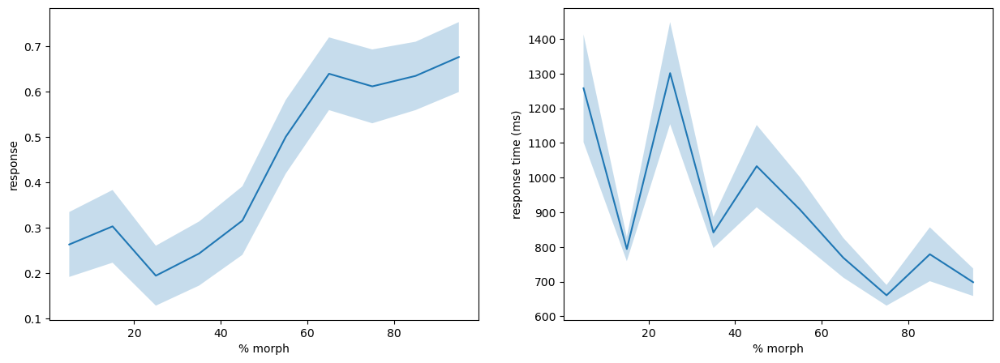

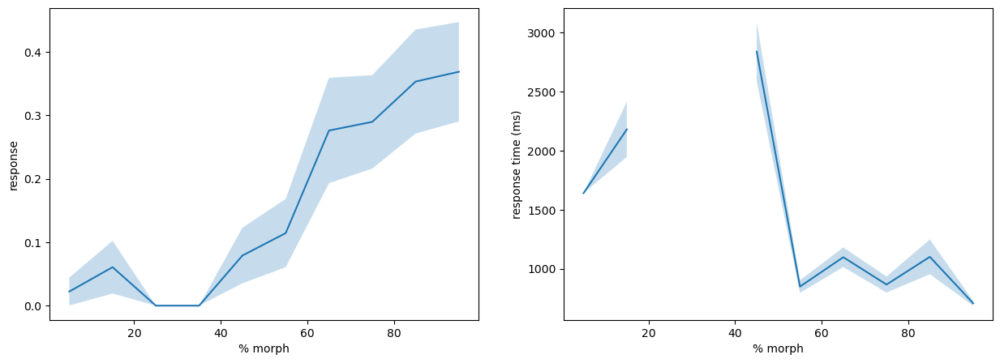

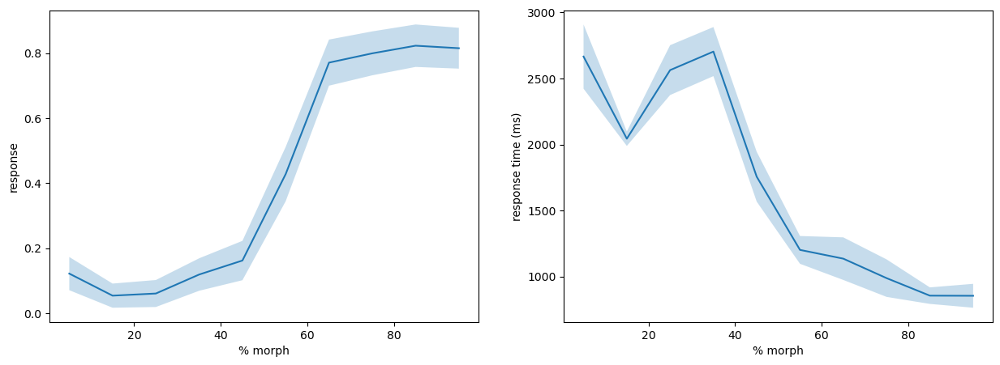

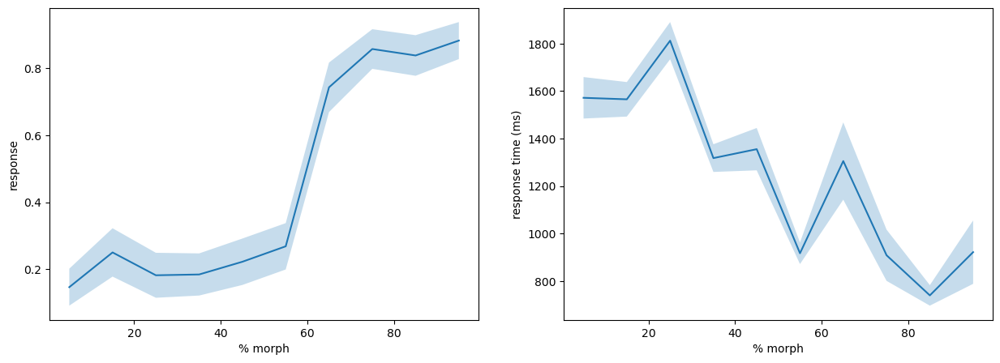

In [20]:
for i in range(1,26):
    view_results(subject=i, run='all', return_data=False, do_plot=True)

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


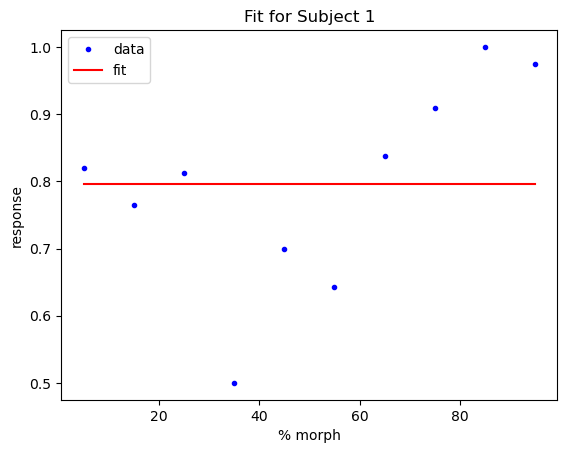

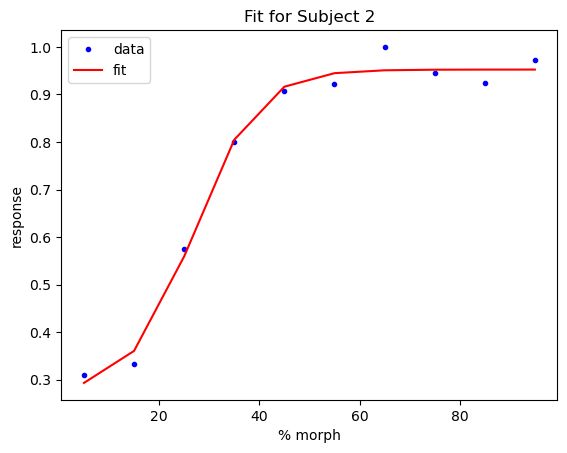

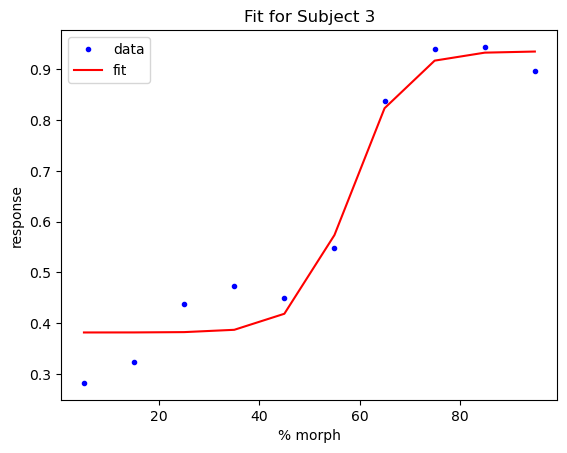

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


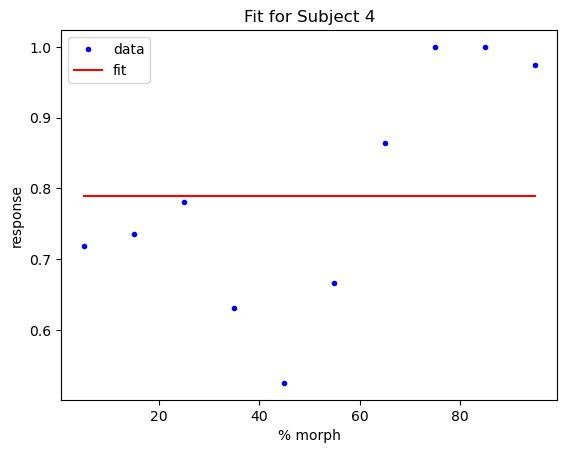

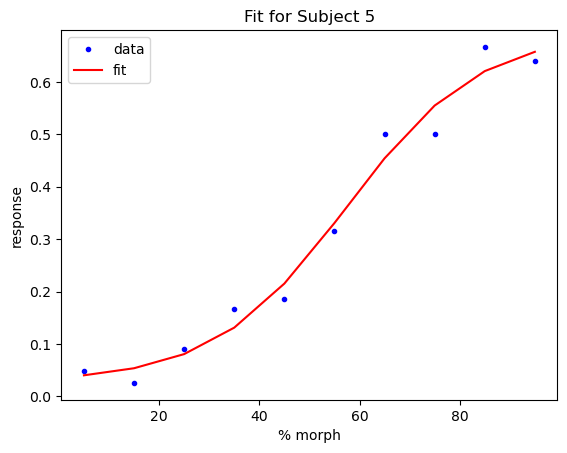

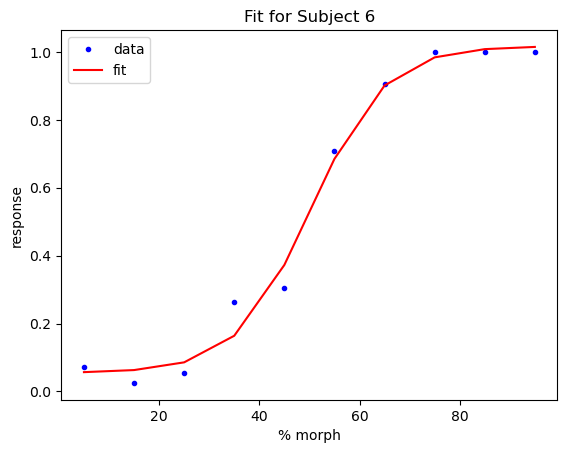

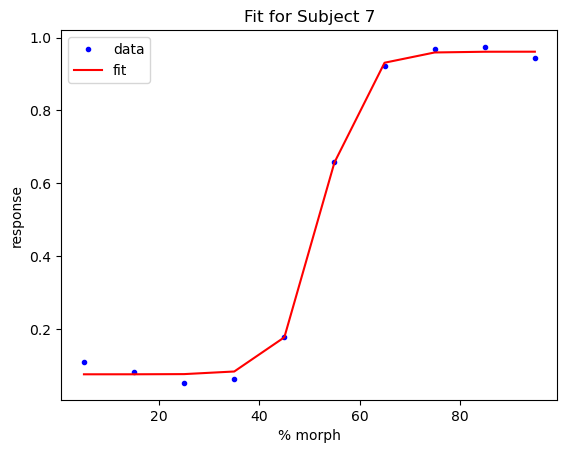

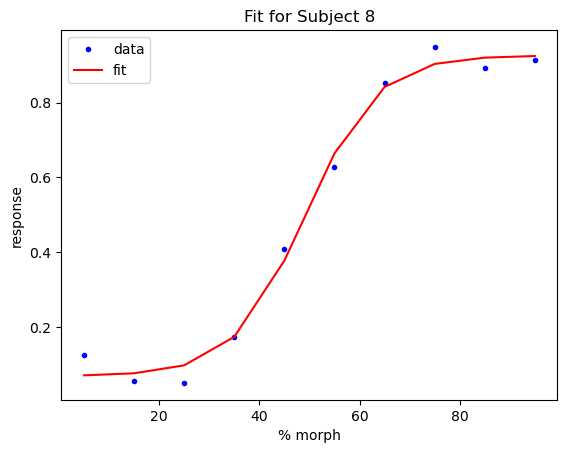

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\875490208.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


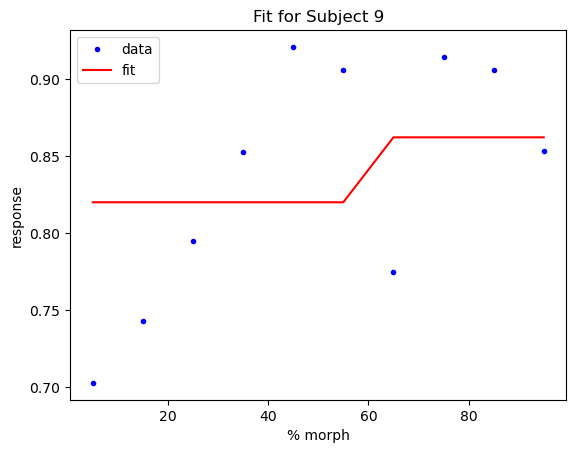

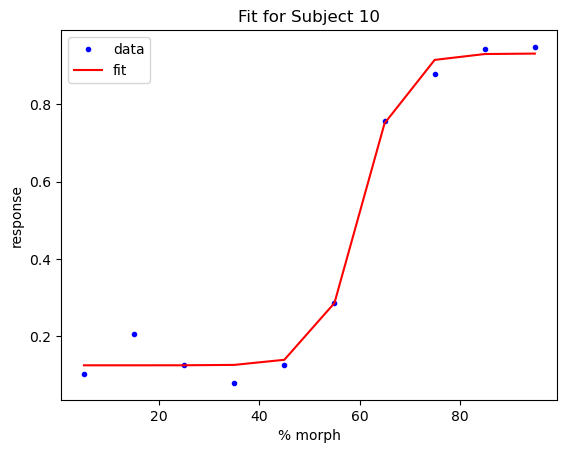

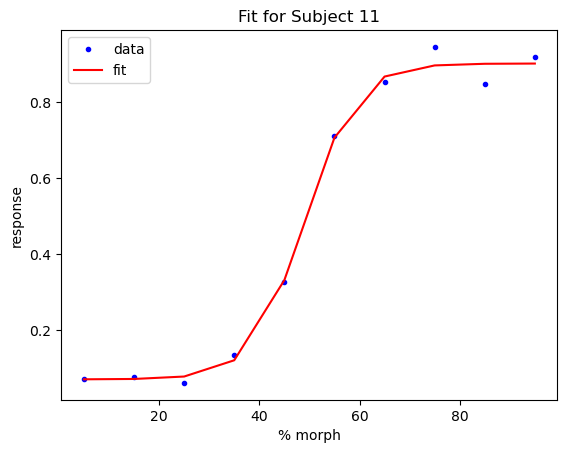

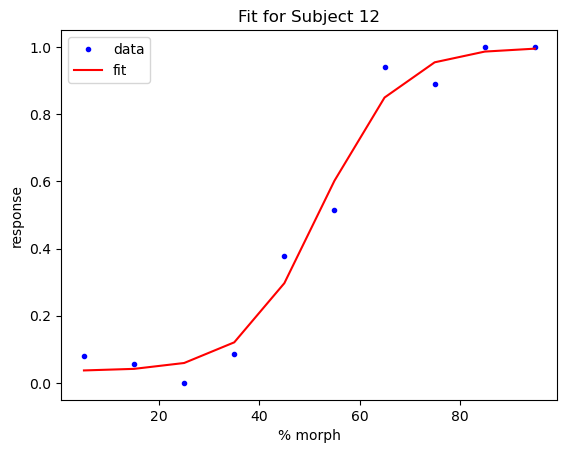

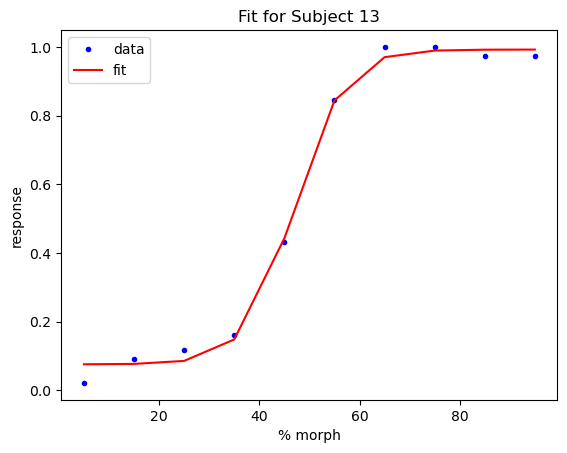

...

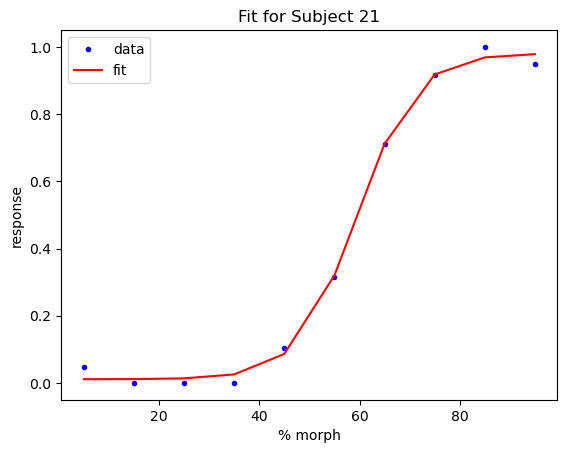

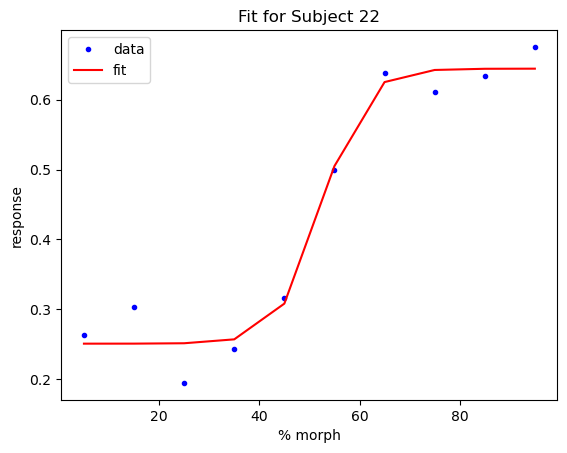

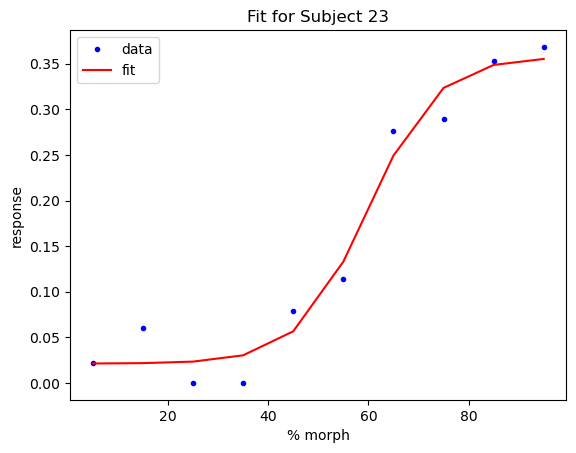

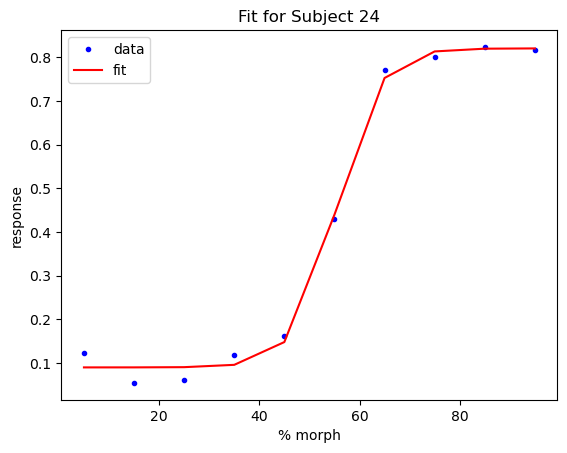

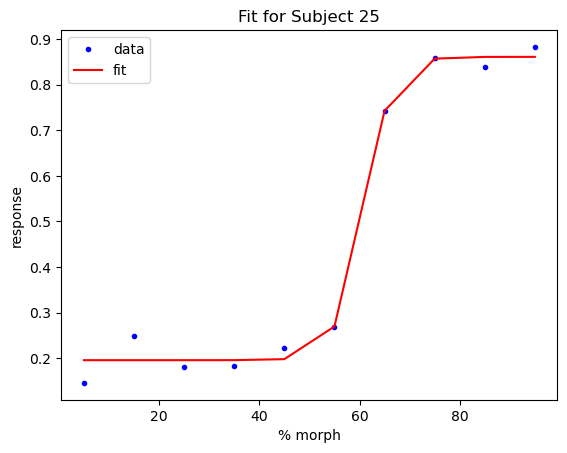

In [24]:
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import numpy as np

# Définir la fonction sigmoidale
def sigmoid(x, L, x0, k, b):
    y = L / (1 + np.exp(-k*(x-x0))) + b
    return y

# Boucle pour ajuster la fonction sigmoidale pour chaque sujet
for i in range(1, 26):
    results = view_results(i, return_data=True, do_plot=False)
    xdata = np.linspace(5, 95, 10)
    ydata = results['response']['mean']

    # Ajuster la fonction sigmoidale aux données
    p0 = [max(ydata), np.median(xdata), 1, min(ydata)]
    popt, pcov = curve_fit(sigmoid, xdata, ydata, p0)

    # Tracer les données et la courbe ajustée
    plt.plot(xdata, ydata, 'b.', label='data')
    plt.plot(xdata, sigmoid(xdata, *popt), 'r-', label='fit')
    plt.xlabel('% morph')
    plt.ylabel('response')
    plt.title(f'Fit for Subject {i}')
    plt.legend()
    plt.show()

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


Seuil d'inflexion pour les données 1 : 105.35185278956784


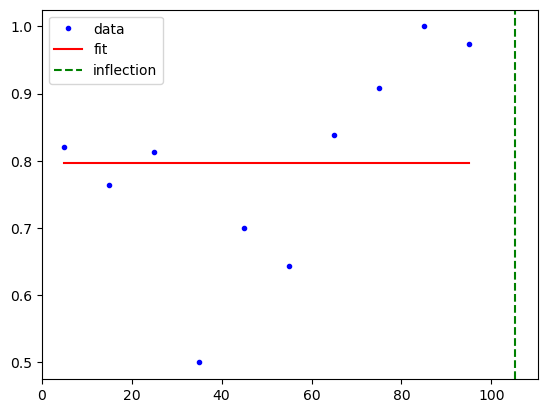

Seuil d'inflexion pour les données 2 : 26.996100054864463


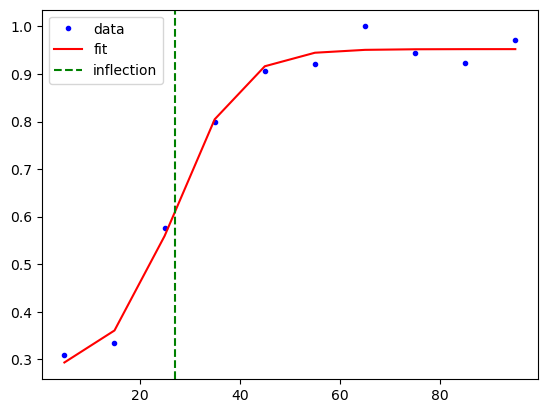

Seuil d'inflexion pour les données 3 : 58.16144435833213


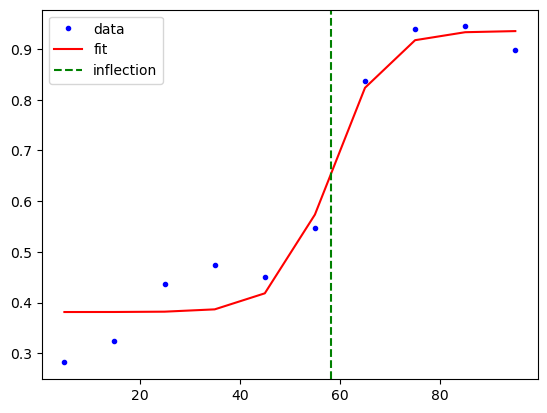

Seuil d'inflexion pour les données 4 : 103.07775210488234


C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


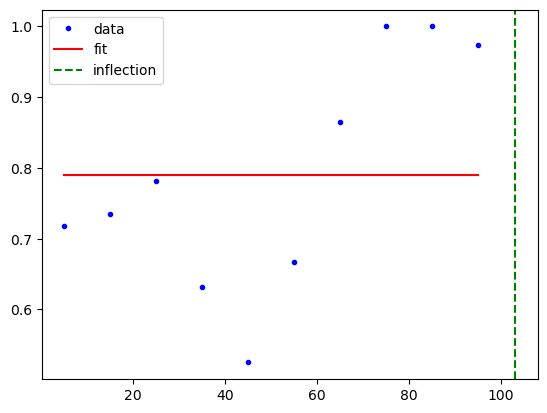

Seuil d'inflexion pour les données 5 : 57.39773911082459


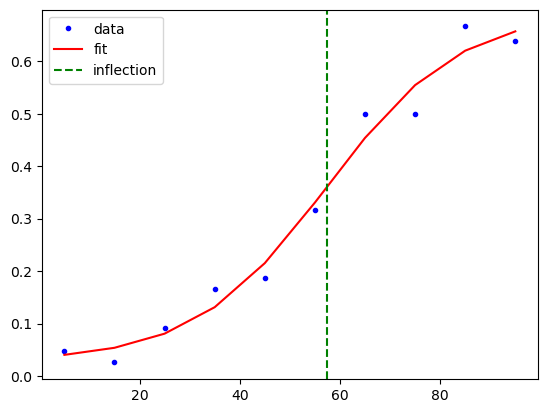

Seuil d'inflexion pour les données 6 : 50.24409872350616


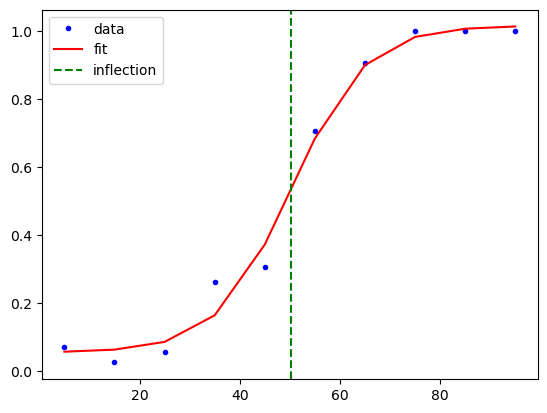

Seuil d'inflexion pour les données 7 : 52.59077215931989


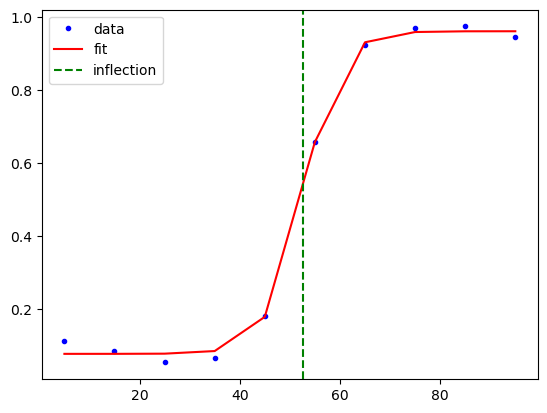

Seuil d'inflexion pour les données 8 : 49.12067042332128


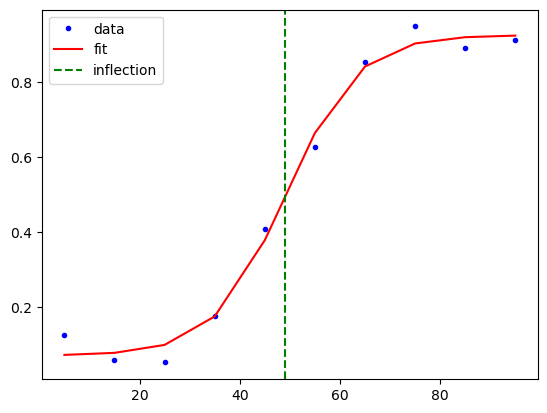

Seuil d'inflexion pour les données 9 : 58.980972609866086


C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\755106077.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


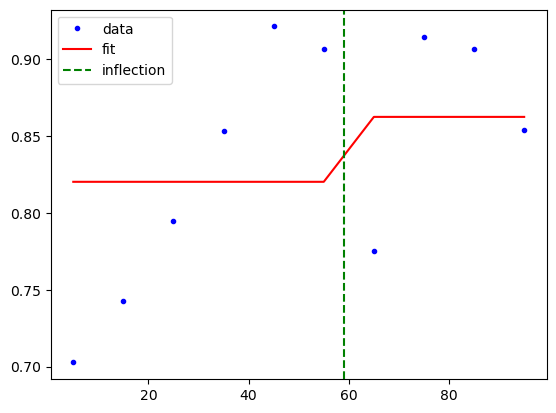

Seuil d'inflexion pour les données 10 : 60.273651207671016


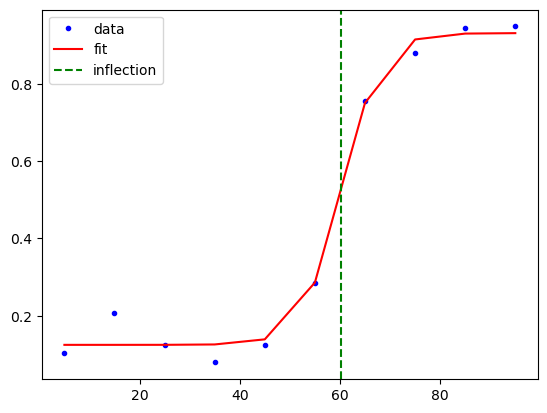

Seuil d'inflexion pour les données 11 : 48.97784573003228


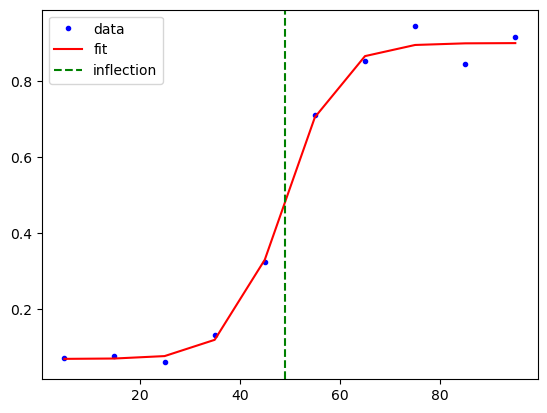

Seuil d'inflexion pour les données 12 : 52.34360302255799


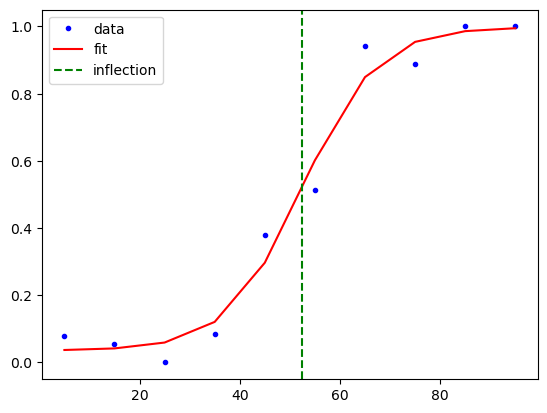

Seuil d'inflexion pour les données 13 : 46.97090448407191


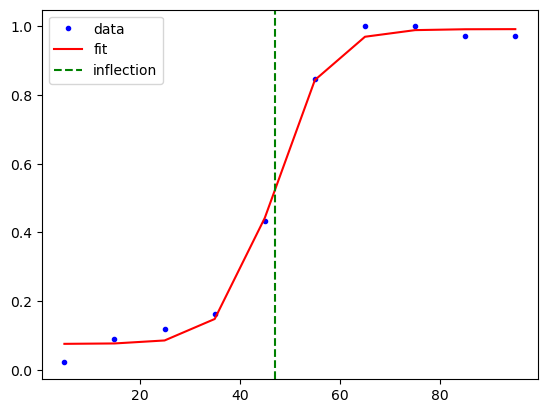

Seuil d'inflexion pour les données 14 : 50.91683141013044


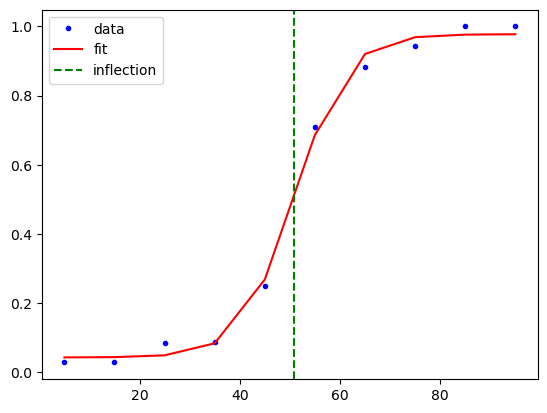

Seuil d'inflexion pour les données 15 : 34.594406651846434


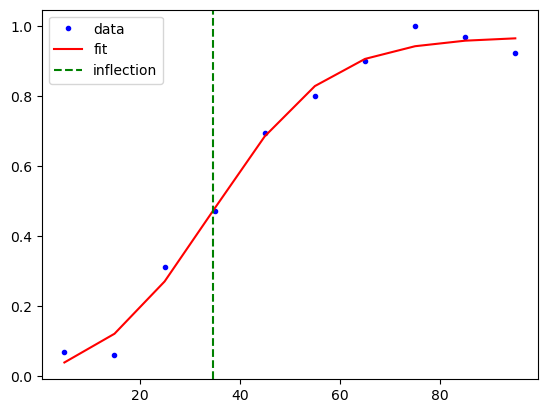

Seuil d'inflexion pour les données 16 : 51.514325933753554


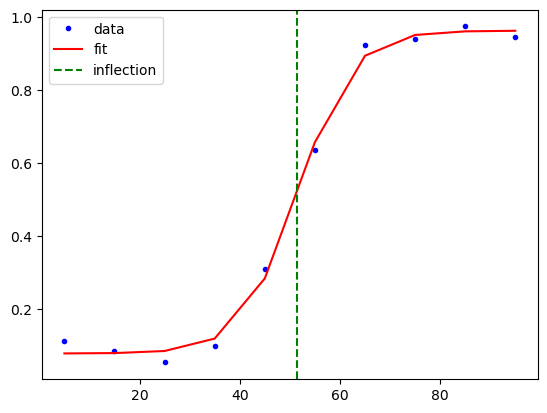

Seuil d'inflexion pour les données 17 : 42.337017867998355


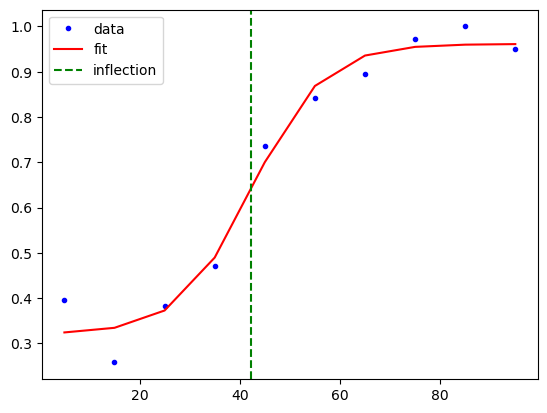

Seuil d'inflexion pour les données 18 : 53.56156318314507


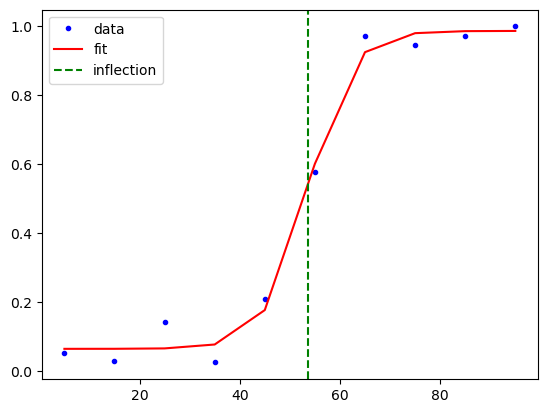

Seuil d'inflexion pour les données 19 : 49.547561533414346


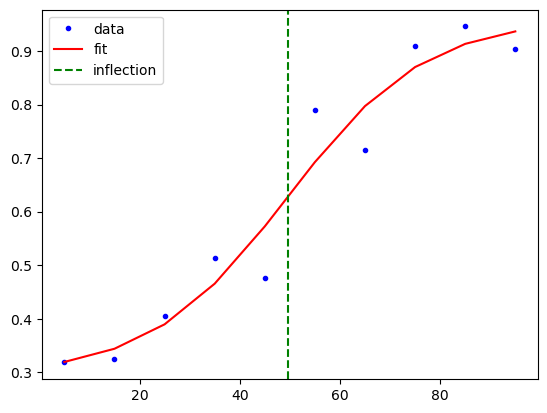

Seuil d'inflexion pour les données 20 : 45.40480648910708


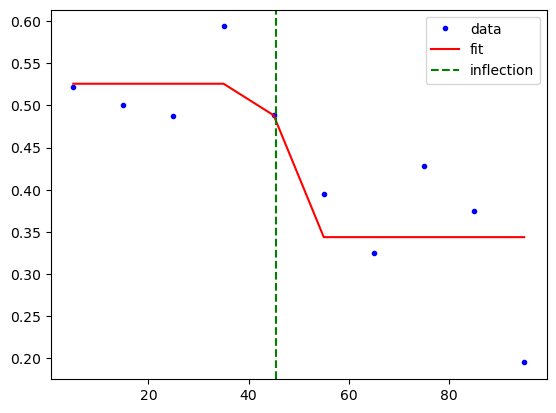

Seuil d'inflexion pour les données 21 : 59.42121603875495


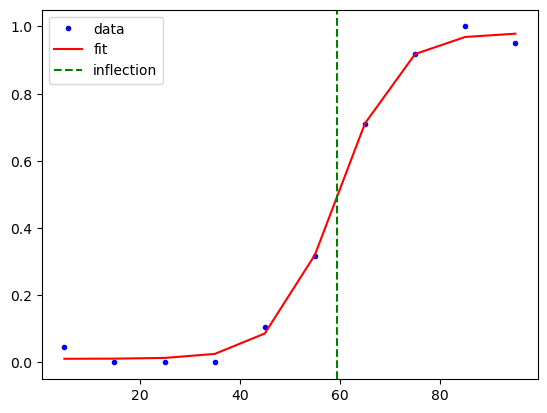

Seuil d'inflexion pour les données 22 : 52.46521801690734


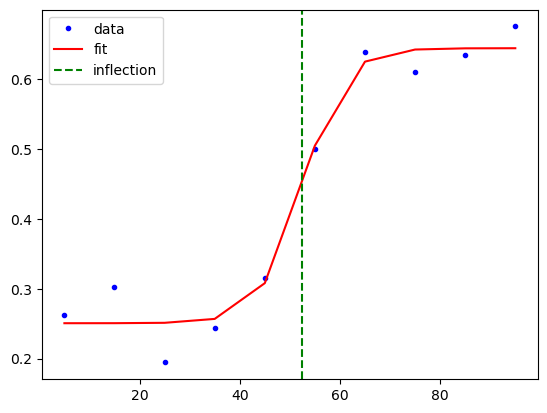

Seuil d'inflexion pour les données 23 : 59.82849868299966


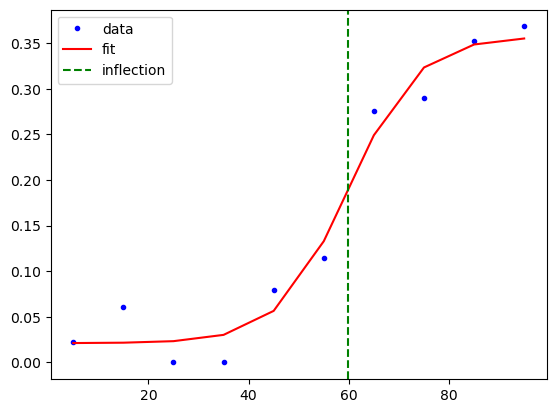

Seuil d'inflexion pour les données 24 : 55.358224329796656


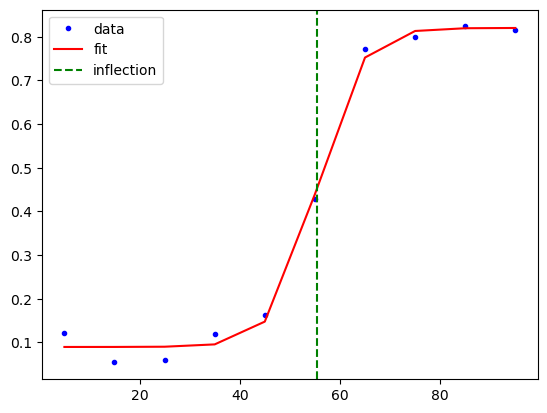

Seuil d'inflexion pour les données 25 : 60.76260798964514


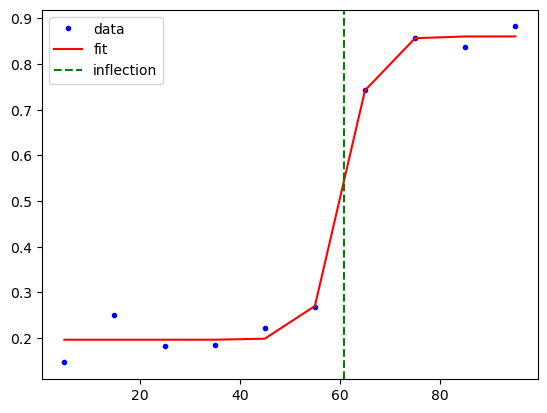

<Figure size 640x480 with 0 Axes>

In [29]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# définir la fonction sigmoidale
def sigmoid(x, L, x0, k, b):
    y = L / (1 + np.exp(-k*(x-x0))) + b
    return y

# définir la fonction pour calculer le seuil d'inflexion
def inflection_point(L, x0):
    return x0

# boucle sur les données pour chaque i
for i in range (1,26):
    # récupérer les données
    results = view_results(i, return_data=True, do_plot=False)
    xdata = np.linspace(5, 95, 10)
    ydata = results['response']['mean']

    # ajuster la fonction sigmoidale aux données
    p0 = [max(ydata), np.median(xdata), 1, min(ydata)]
    popt, pcov = curve_fit(sigmoid, xdata, ydata, p0)

    # calculer le seuil d'inflexion
    inflection = inflection_point(*popt[0:2])
    print('Seuil d\'inflexion pour les données', i, ':', inflection)

    # tracer les données et la courbe ajustée
    plt.plot(xdata, ydata, 'b.', label='data')
    plt.plot(xdata, sigmoid(xdata, *popt), 'r-', label='fit')
    plt.axvline(inflection, color='g', linestyle='--', label='inflection')
    plt.legend()
    plt.show()
    plt.savefig(f'subject_{i}.png')

In [49]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def view_results(subject=1, run='all', return_data=False, do_plot=True):

    labels = pd.read_csv(f'labels/labels_{subject}.csv')

    if run == 'all':
        x = labels['morph level']
        y = labels['response']
        z = labels['response time']
        t = labels['couple']
    elif run in range(1, 5):
        mask = labels['run'] == run
        x = labels[mask]['morph level']
        y = labels[mask]['response']
        z = labels[mask]['response time']
        t = labels[mask]['couple']

    # Plot graph for each couple
    for couple in range(1, 10):
        mask_couple = (t == couple)
        x_couple = x[mask_couple]
        y_couple = y[mask_couple]

        # Calculate means and standard errors
        values, counts = np.unique(x_couple, return_counts=True)
        response_mean = np.zeros(len(values))
        response_std = np.zeros(len(values))
        for count, v in enumerate(values):
            mask = (x_couple == v)
            response_mean[count] = np.nan_to_num(np.mean(y_couple[mask]))
            response_std[count] = np.nan_to_num(np.std(y_couple[mask]) / np.sqrt(np.sum(mask)))

        # Plot graph
        plt.figure()
        plt.errorbar(values, response_mean, yerr=response_std, fmt='-o')
        plt.xlabel('Morph level')
        plt.ylabel('Response')
        plt.title(f'Couple {couple} - Subject {subject}')
        plt.show()

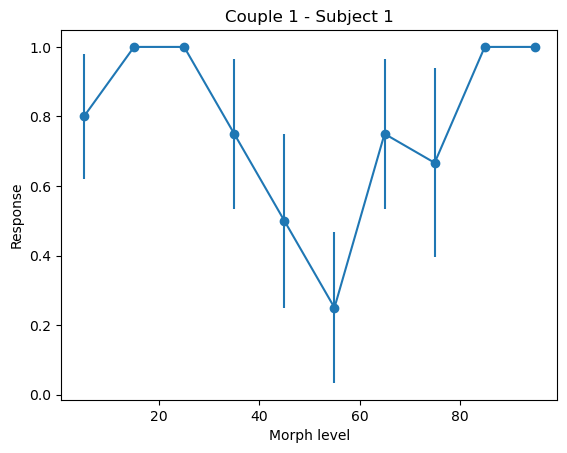

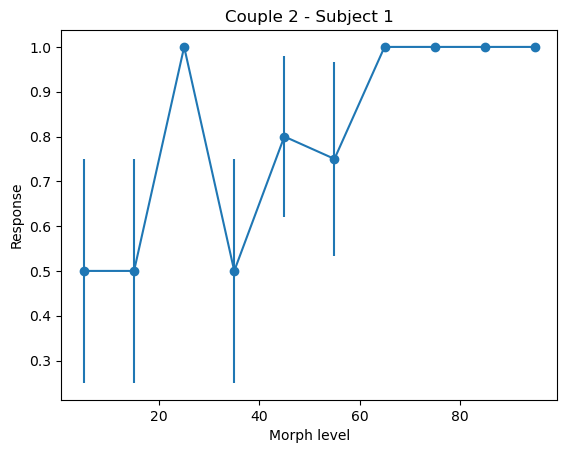

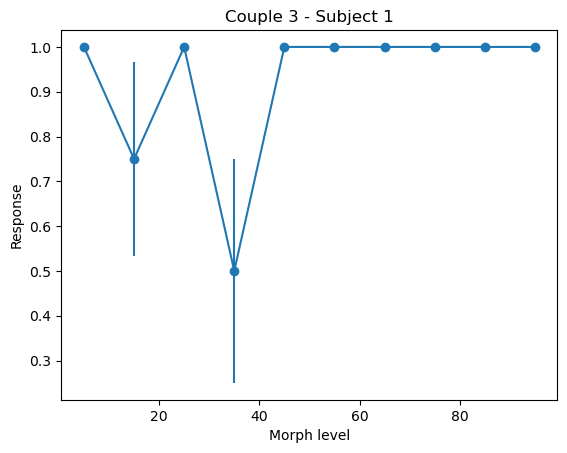

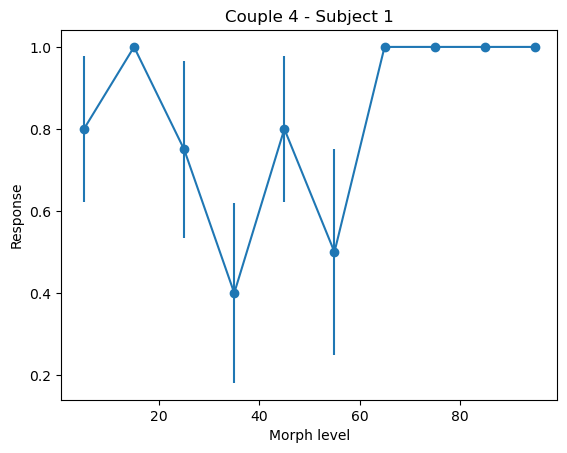

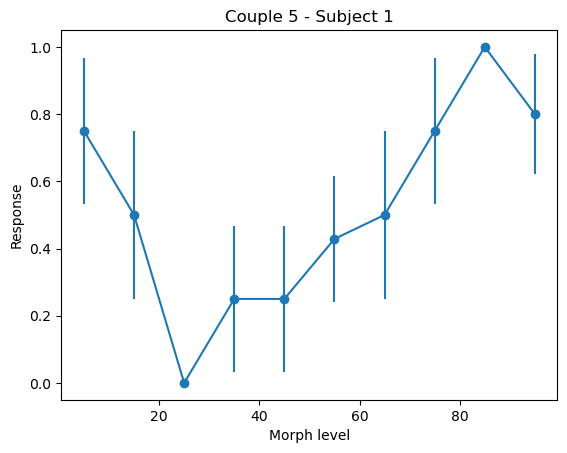

...

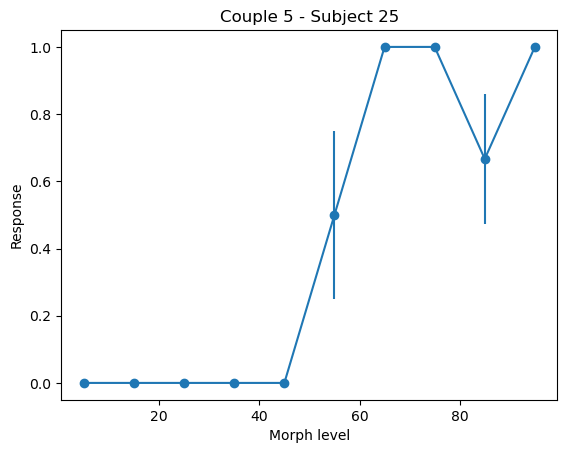

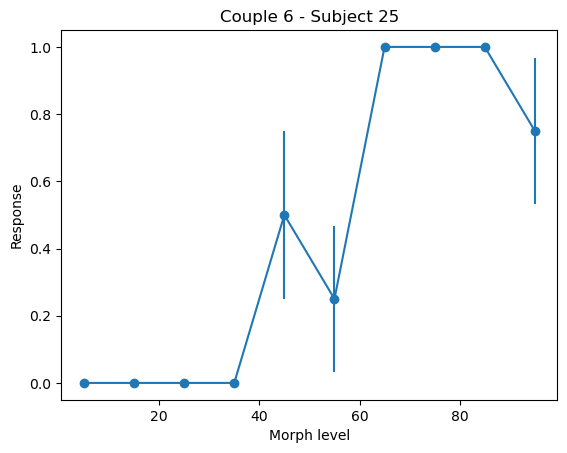

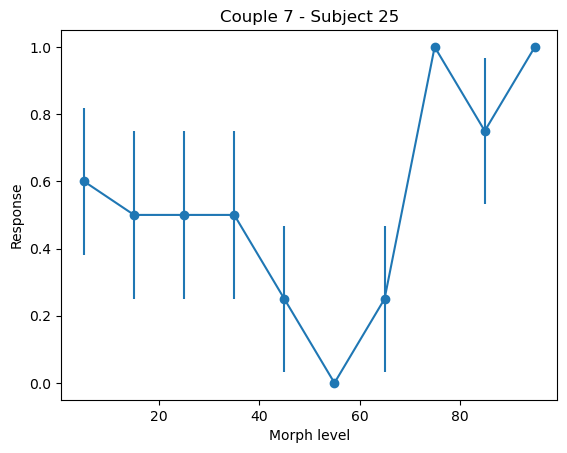

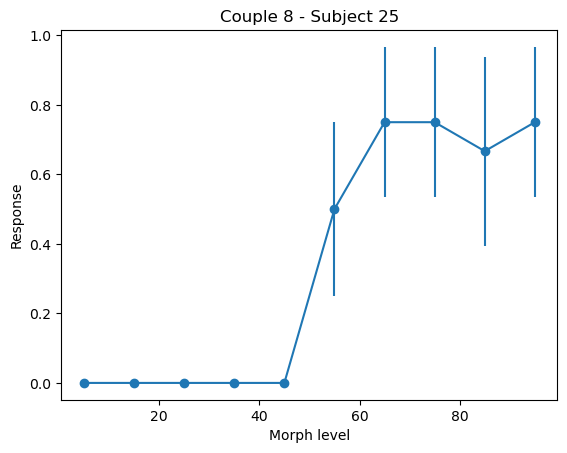

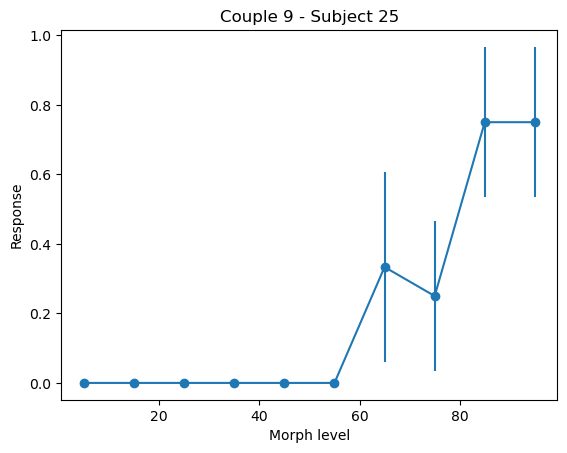

In [50]:
for i in range (1,26):
    view_results(subject=i, run='all', return_data=False, do_plot=True)

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


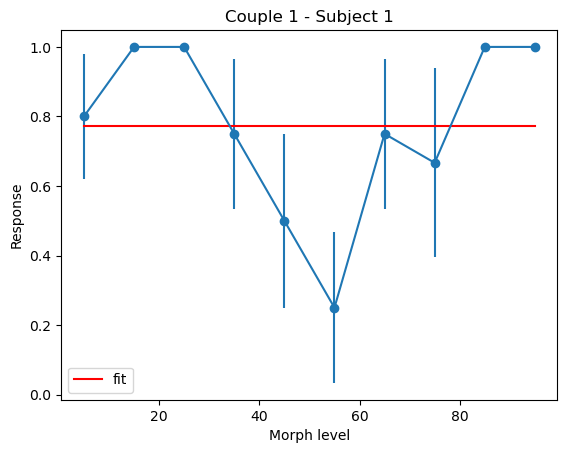

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\1772489999.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


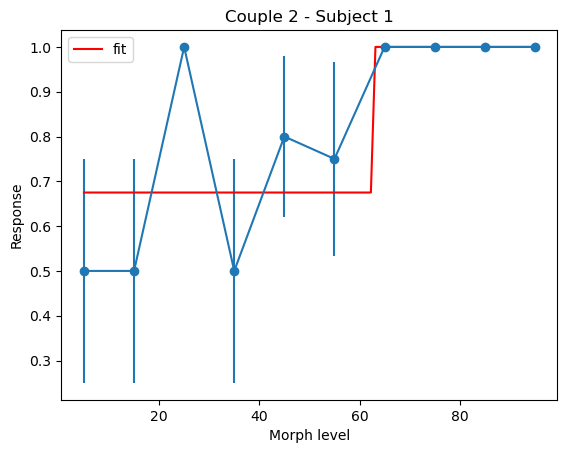

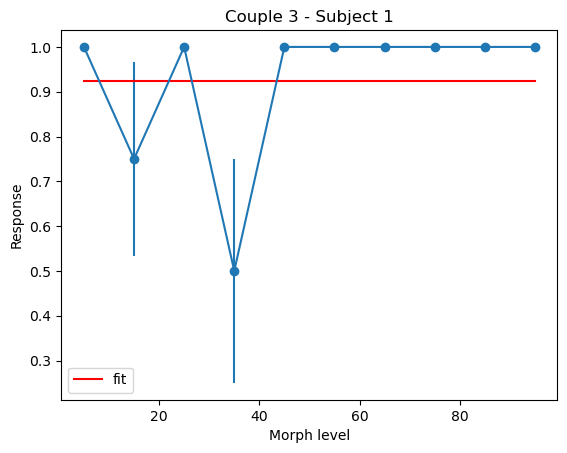

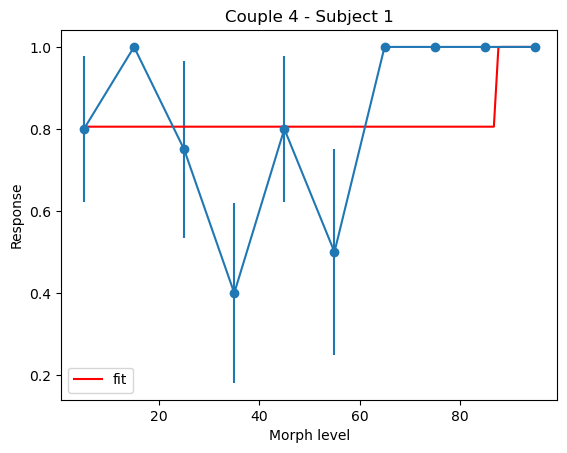

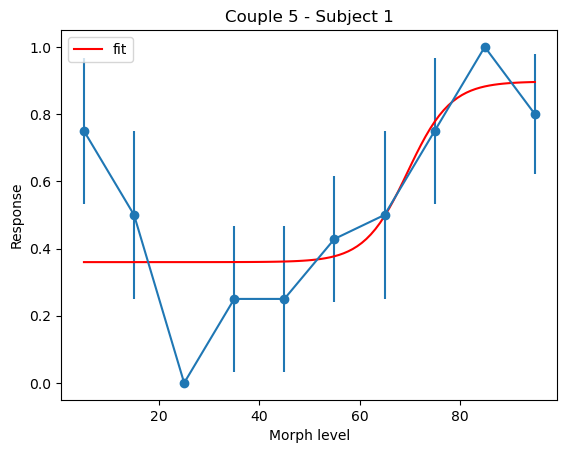

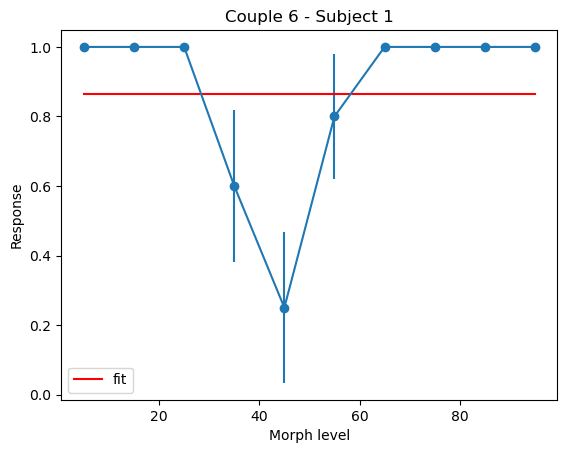

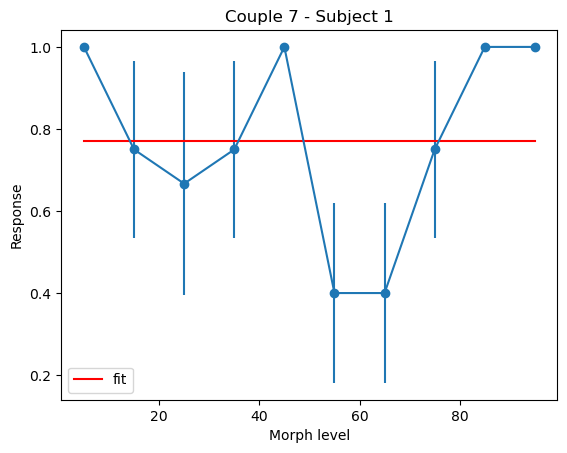

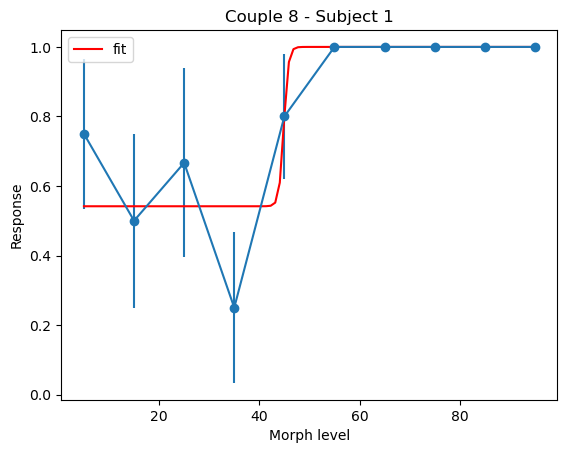

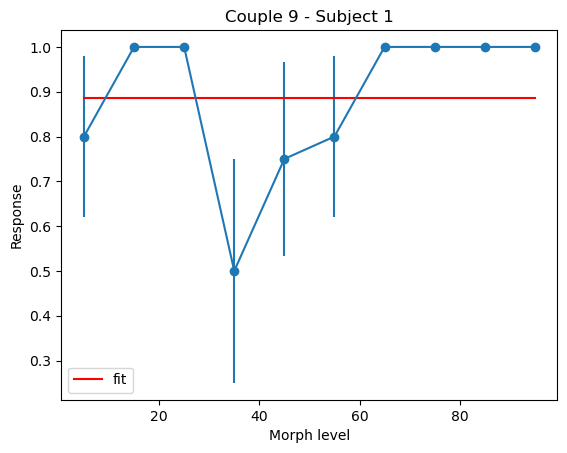

In [41]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

def sigmoid(x, L, x0, k, b):
    y = L / (1 + np.exp(-k*(x-x0))) + b
    return y

def view_results(subject=1, run='all', return_data=False, do_plot=True):

    labels = pd.read_csv(f'labels/labels_{subject}.csv')

    if run == 'all':
        x = labels['morph level']
        y = labels['response']
        z = labels['response time']
        t = labels['couple']
    elif run in range(1, 5):
        mask = labels['run'] == run
        x = labels[mask]['morph level']
        y = labels[mask]['response']
        z = labels[mask]['response time']
        t = labels[mask]['couple']

    # Plot graph for each couple
    for couple in range(1, 10):
        mask_couple = (t == couple)
        x_couple = x[mask_couple]
        y_couple = y[mask_couple]

        # Calculate means and standard errors
        values, counts = np.unique(x_couple, return_counts=True)
        response_mean = np.zeros(len(values))
        response_std = np.zeros(len(values))
        for count, v in enumerate(values):
            mask = (x_couple == v)
            response_mean[count] = np.nan_to_num(np.mean(y_couple[mask]))
            response_std[count] = np.nan_to_num(np.std(y_couple[mask]) / np.sqrt(np.sum(mask)))

        # Plot graph
        plt.figure()
        plt.errorbar(values, response_mean, yerr=response_std, fmt='-o')
        plt.xlabel('Morph level')
        plt.ylabel('Response')
        plt.title(f'Couple {couple} - Subject {subject}')  # Ajout du titre avec le numéro de sujet
        
        # Ajuster la fonction sigmoïdale aux données
        p0 = [max(response_mean), np.median(values), 1, min(response_mean)]
        popt, pcov = curve_fit(sigmoid, values, response_mean, p0)

        # Tracer les données et la courbe ajustée
        x_fit = np.linspace(min(values), max(values), 100)
        y_fit = sigmoid(x_fit, *popt)

        plt.plot(x_fit, y_fit, 'r-', label='fit')
        plt.legend()

        if do_plot:
            plt.show()

        if return_data:
            data = {
                'couple': couple,
                'x': values,
                'y': response_mean,
                'y_fit': sigmoid(values, *popt)
            }
            return data

# appel de la fonction
view_results(1, 'all', return_data=False, do_plot=True)

In [72]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

def sigmoid(x, L, x0, k, b):
    y = L / (1 + np.exp(-k*(x-x0))) + b
    return y

def view_results(subject=1, run='all', return_data=False, do_plot=True):

    labels = pd.read_csv(f'labels/labels_{subject}.csv')

    if run == 'all':
        x = labels['morph level']
        y = labels['response']
        z = labels['response time']
        t = labels['couple']
    elif run in range(1, 5):
        mask = labels['run'] == run
        x = labels[mask]['morph level']
        y = labels[mask]['response']
        z = labels[mask]['response time']
        t = labels[mask]['couple']

    # Plot graph for each couple
    for couple in range(1, 10):
        mask_couple = (t == couple)
        x_couple = x[mask_couple]
        y_couple = y[mask_couple]

        # Calculate means and standard errors
        values, counts = np.unique(x_couple, return_counts=True)
        response_mean = np.zeros(len(values))
        response_std = np.zeros(len(values))
        for count, v in enumerate(values):
            mask = (x_couple == v)
            response_mean[count] = np.nan_to_num(np.mean(y_couple[mask]))
            response_std[count] = np.nan_to_num(np.std(y_couple[mask]) / np.sqrt(np.sum(mask)))

        # Ajuster la fonction sigmoïdale aux données
        try:
            p0 = [max(response_mean), np.median(values), 1, min(response_mean)]
            popt, pcov = curve_fit(sigmoid, values, response_mean, p0)

            # Calculer la différence entre le point maximum et le point minimum
            max_value = sigmoid(values, *popt).max()
            min_value = sigmoid(values, *popt).min()
            diff_percentage = (max_value - min_value) / max_value * 100

            # Vérifier les critères de filtrage
            if popt[2] > 0 and diff_percentage > 20:
                # Tracer les données et la courbe ajustée
                plt.figure()
                plt.errorbar(values, response_mean, yerr=response_std, fmt='-o')
                plt.xlabel('Morph level')
                plt.ylabel('Response')
                plt.title(f'Couple {couple} - Subject {subject}')  # Ajout du titre avec le numéro de sujet

                x_fit = np.linspace(min(values), max(values), 100)
                y_fit = sigmoid(x_fit, *popt)

                plt.plot(x_fit, y_fit, 'r-', label='fit')
                plt.legend()

                if do_plot:
                    plt.show()

                if return_data:
                    data = {
                        'couple': couple,
                        'x': values,
                        'y': response_mean,
                        'y_fit': sigmoid(values, *popt)
                    }
                    return data
        except RuntimeError:
             print(f"Fit failed for Couple {couple} - Subject {subject}")

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


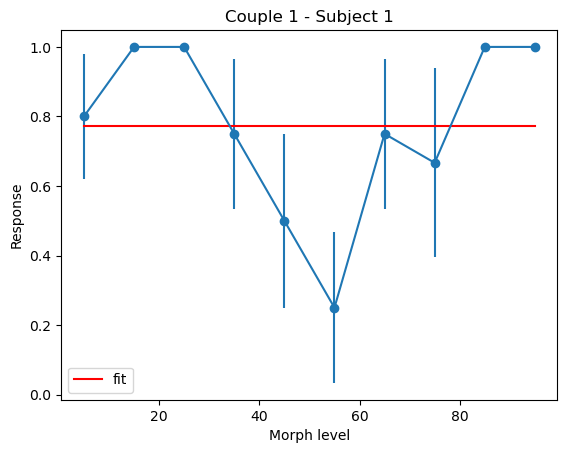

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


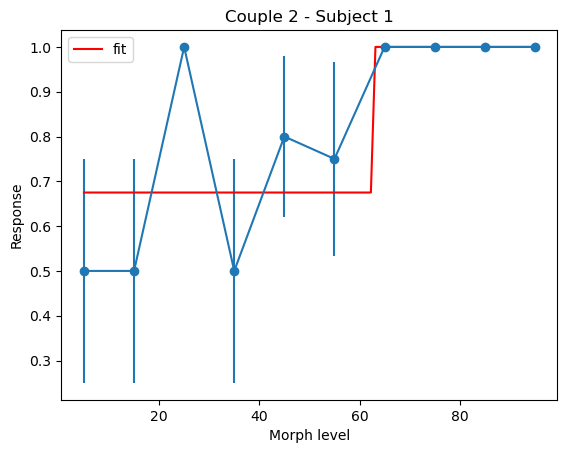

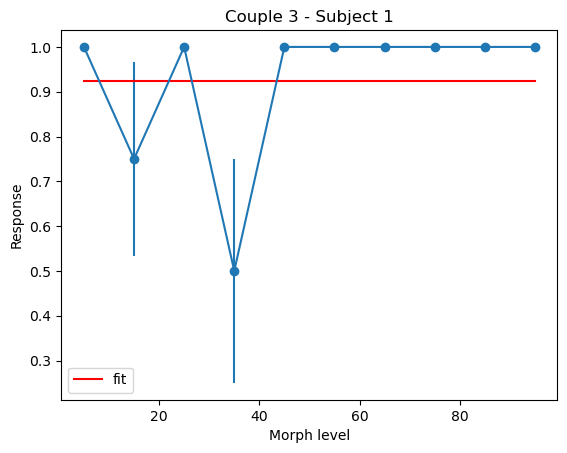

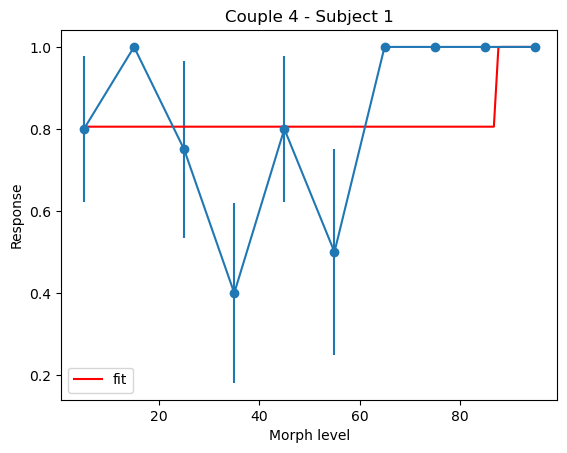

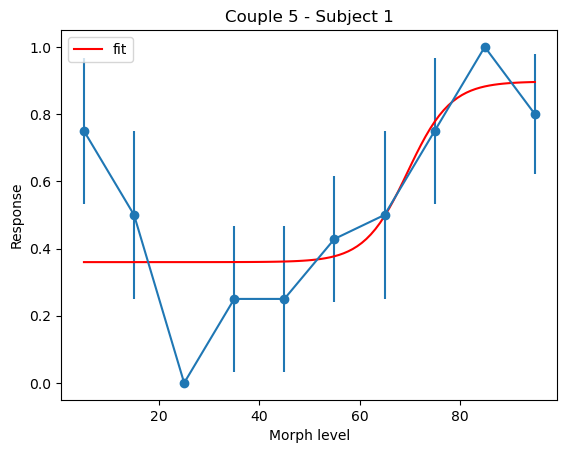

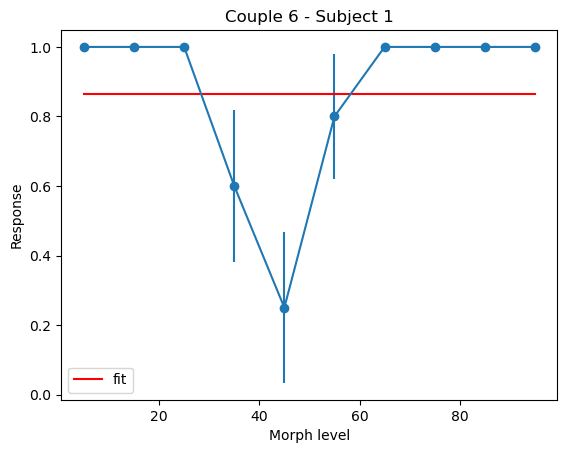

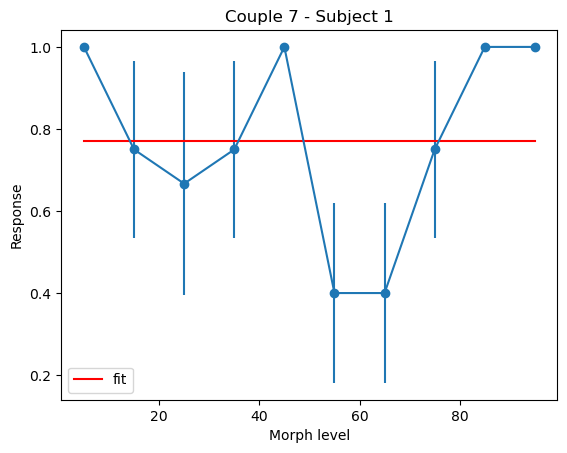

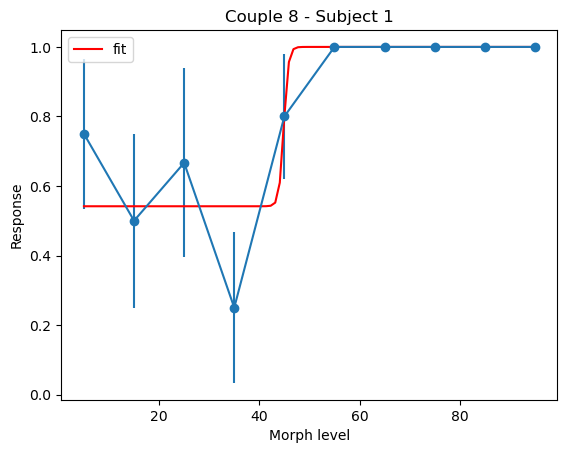

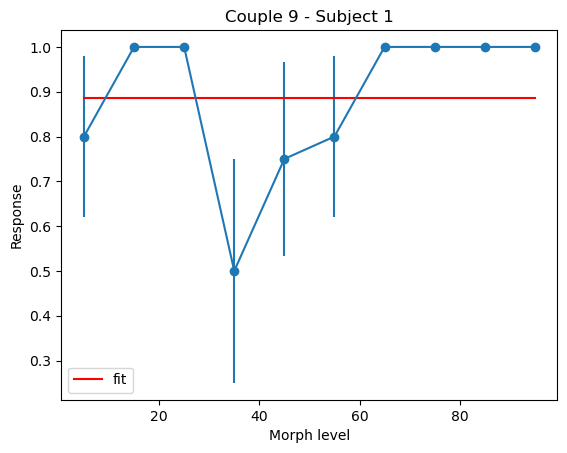

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


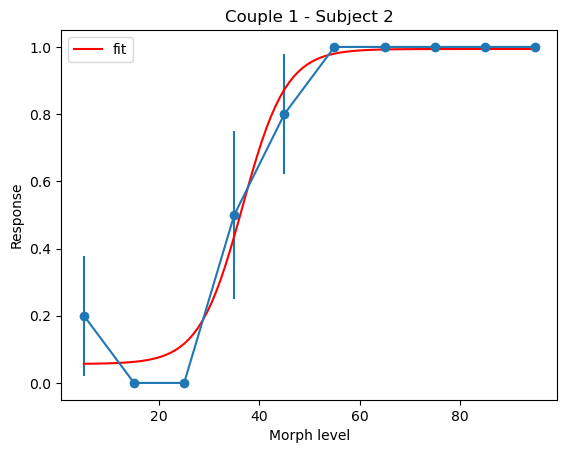

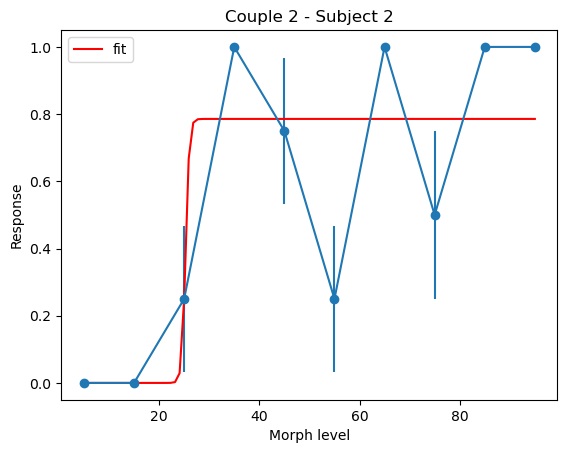

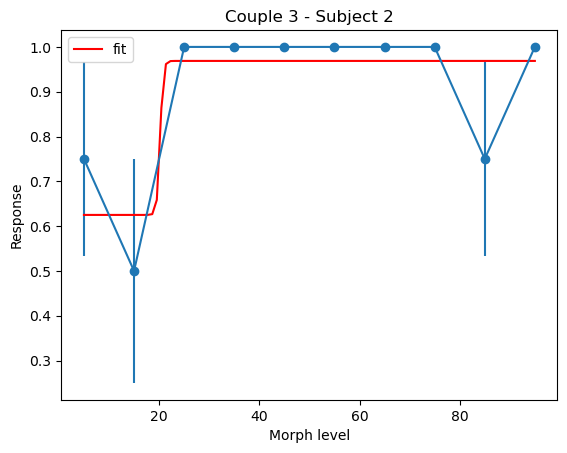

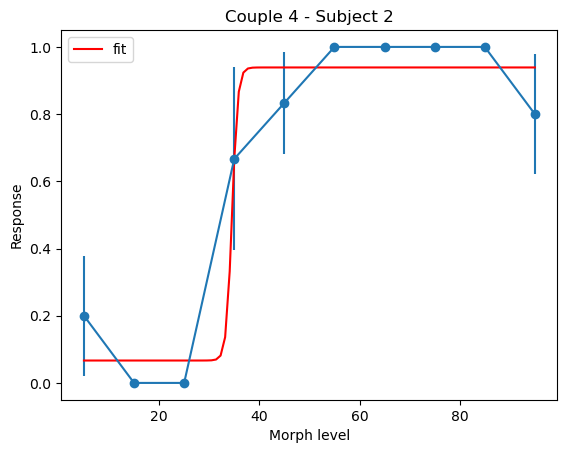

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


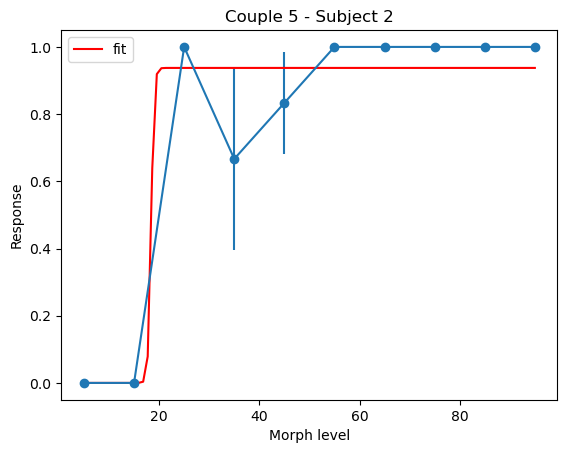

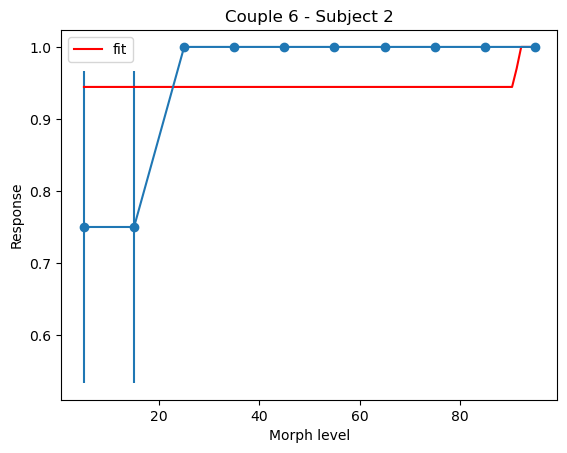

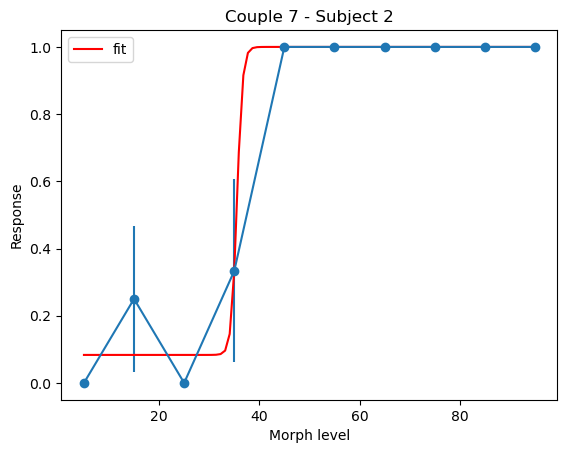

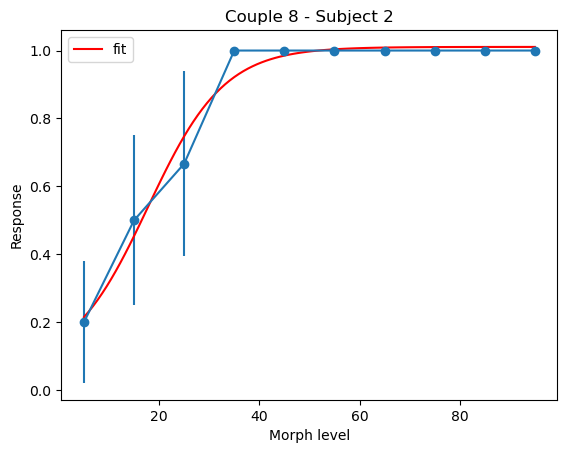

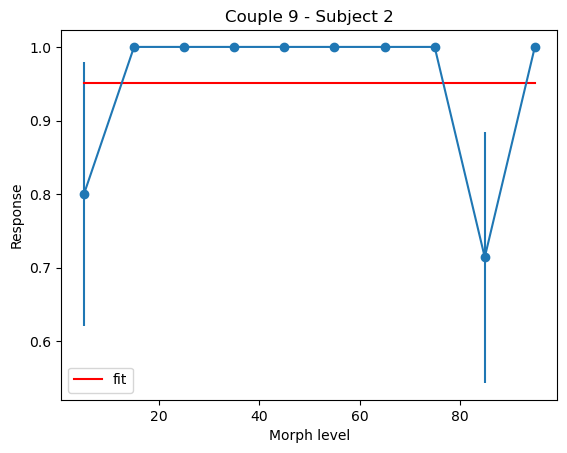

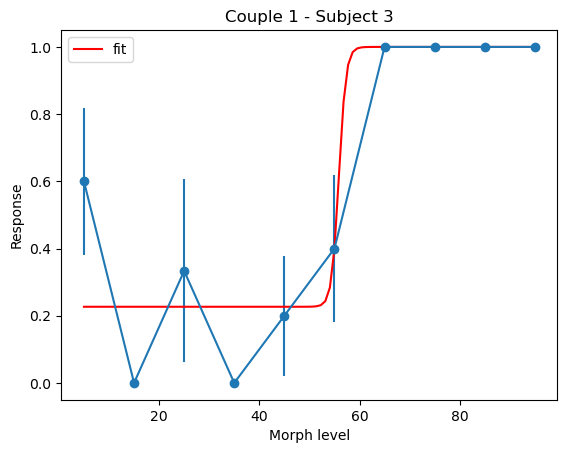

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


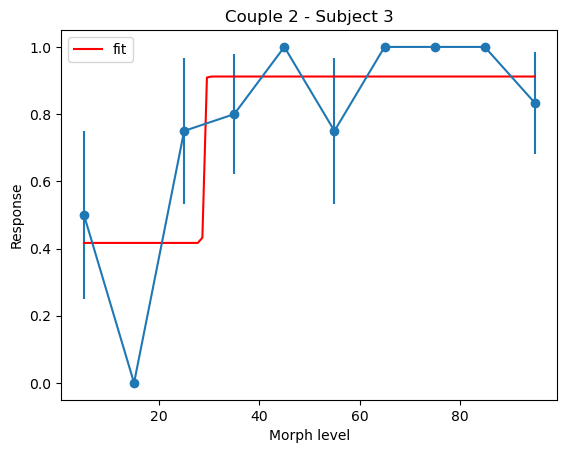

Fit failed for Couple 3 - Subject 3


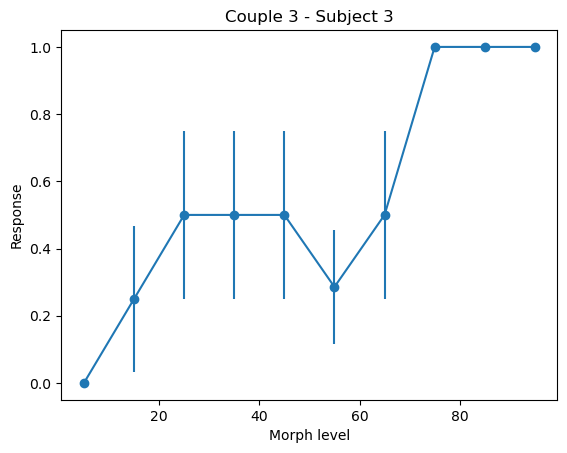

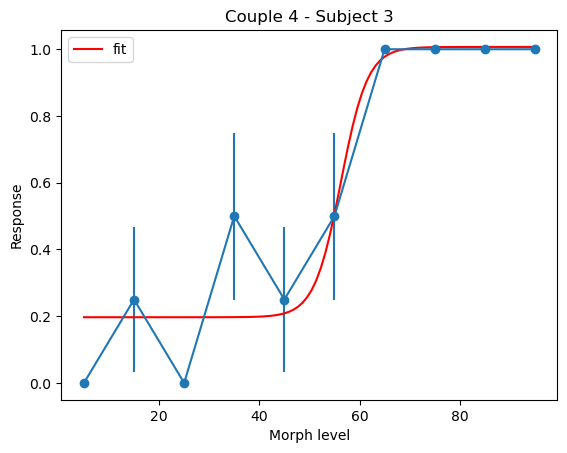

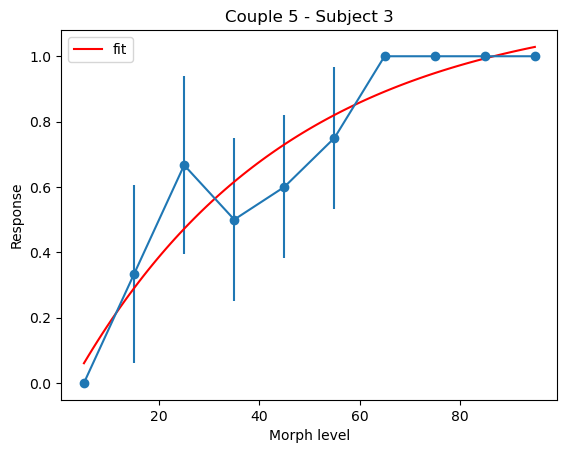

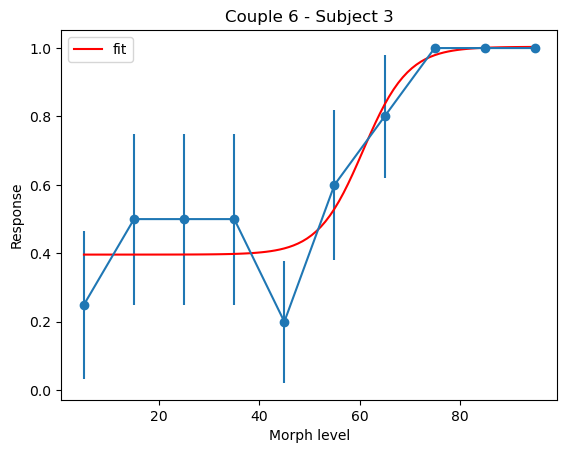

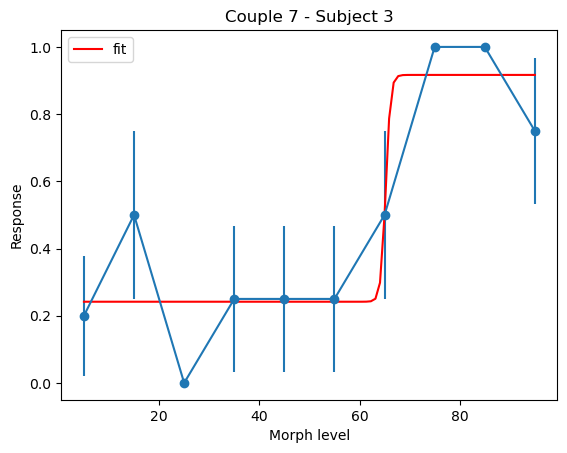

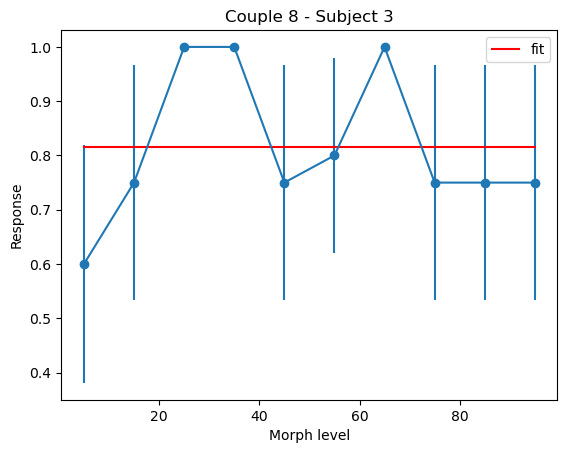

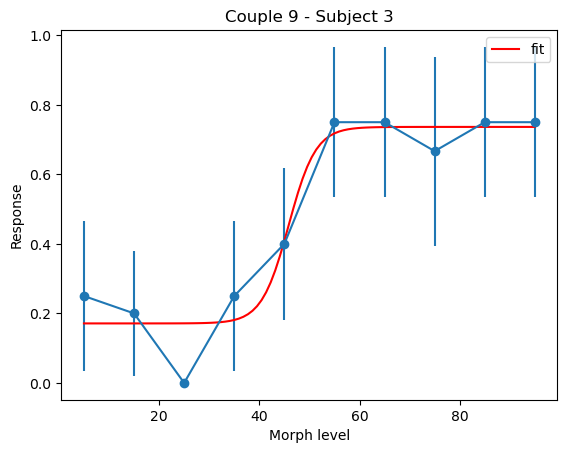

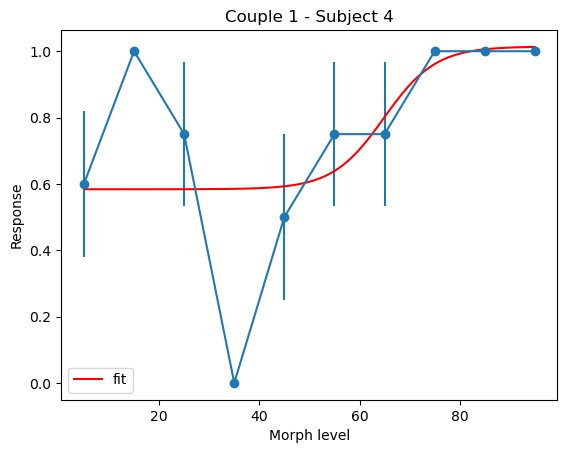

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


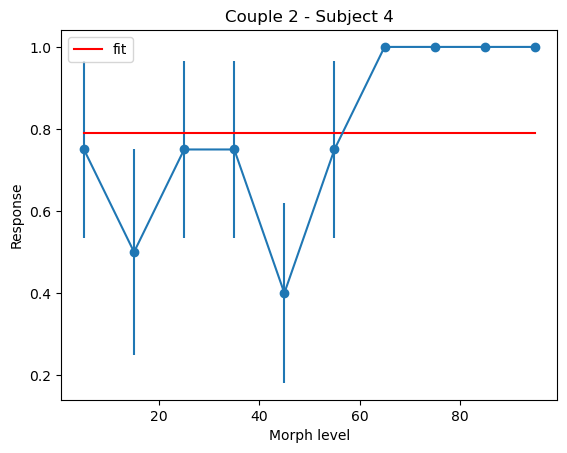

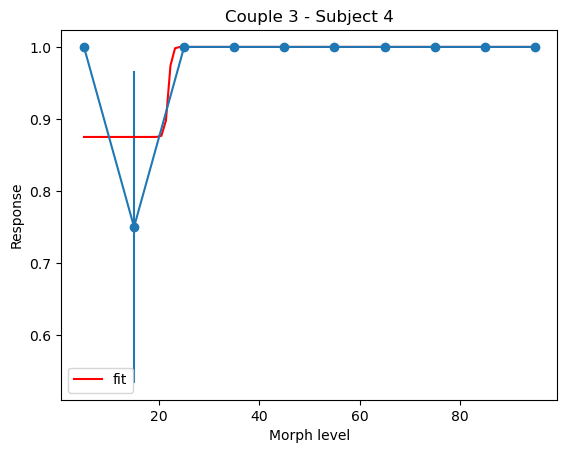

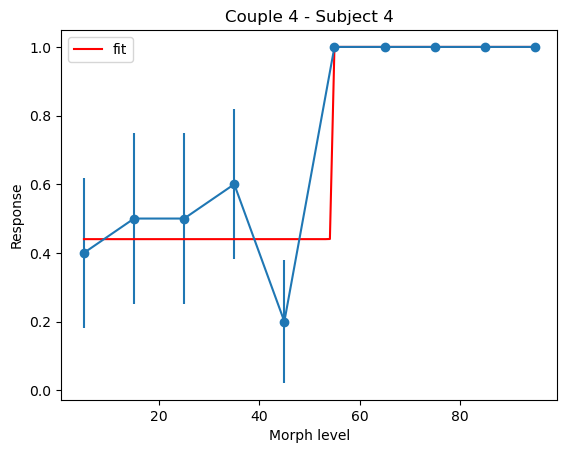

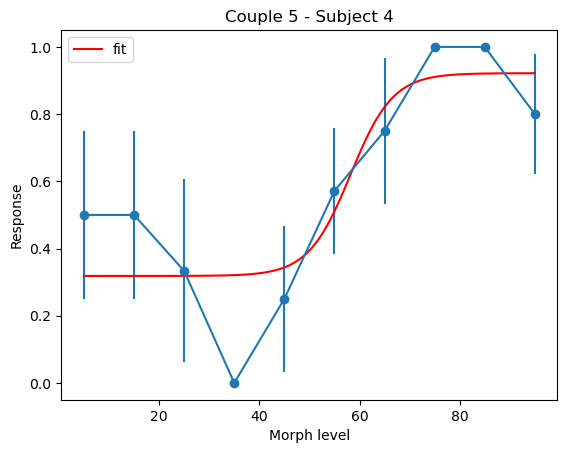

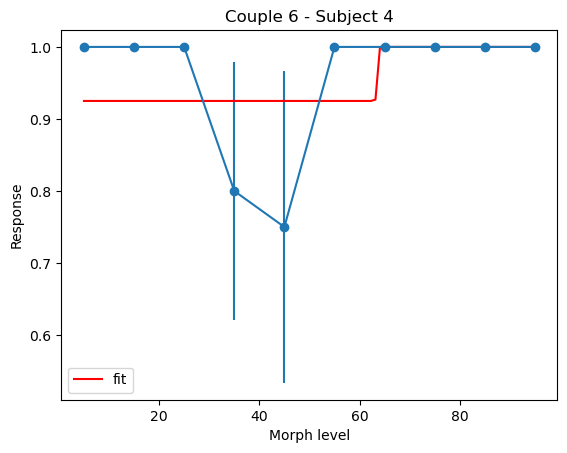

...

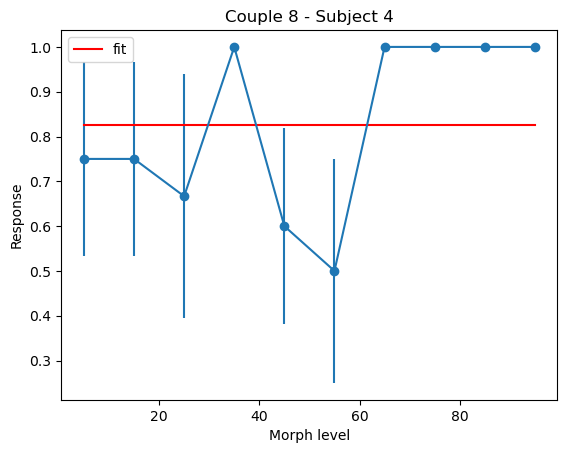

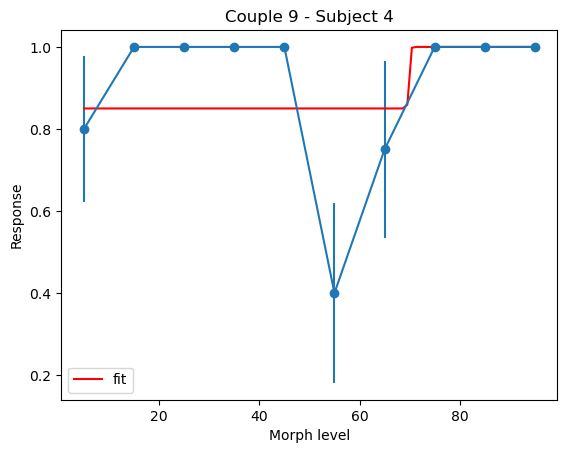

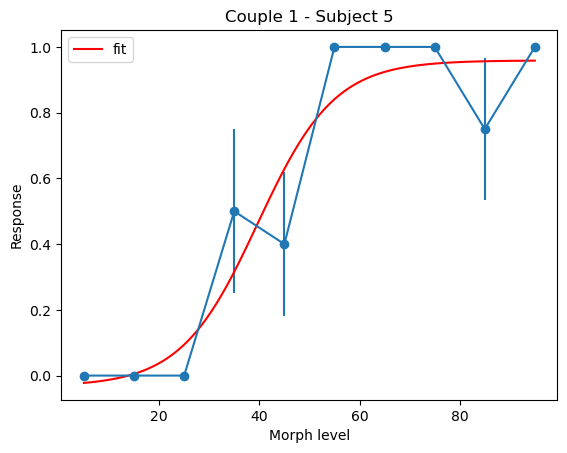

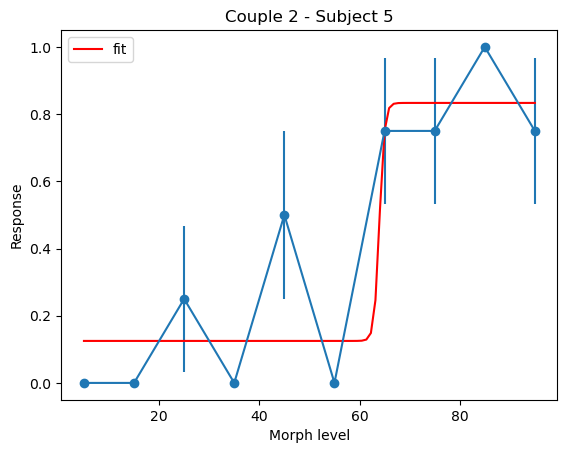

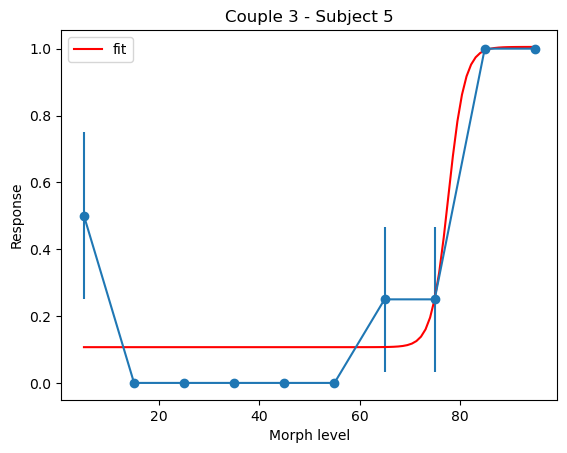

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


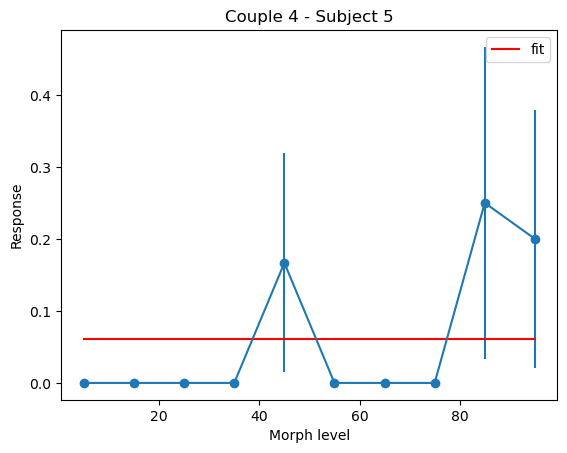

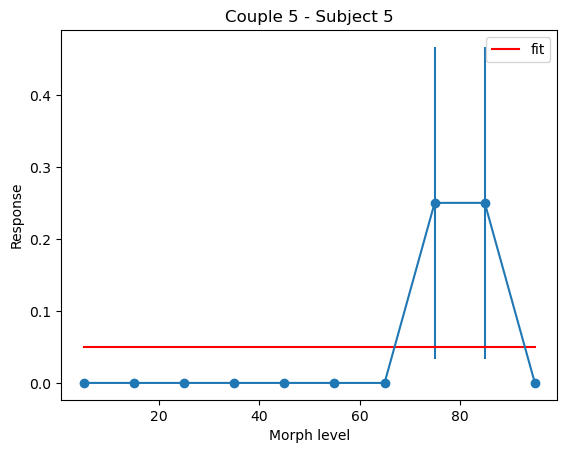

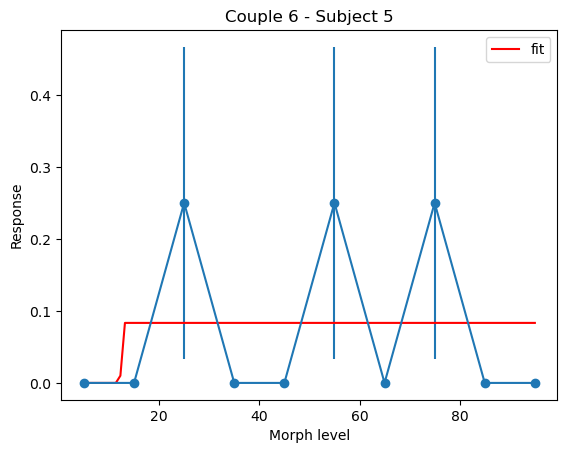

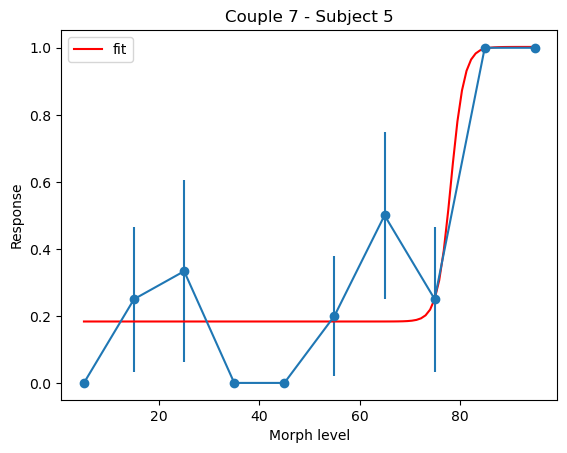

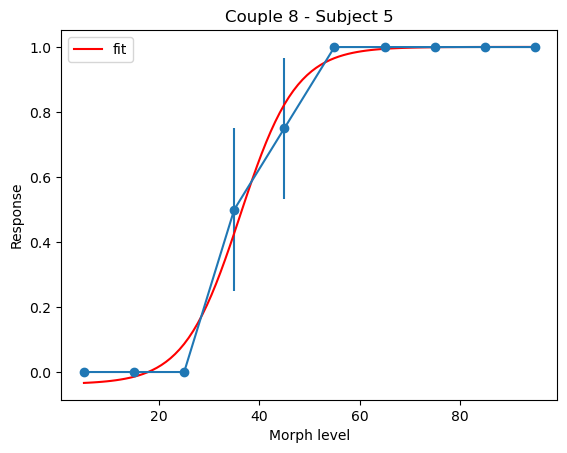

...

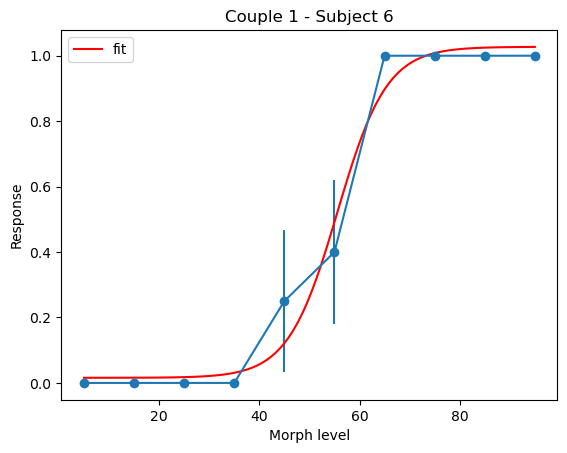

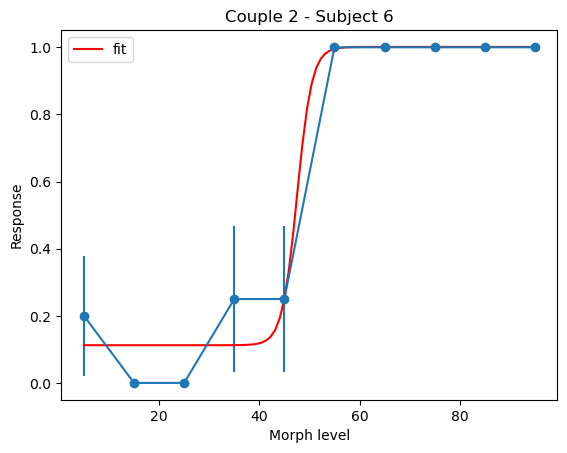

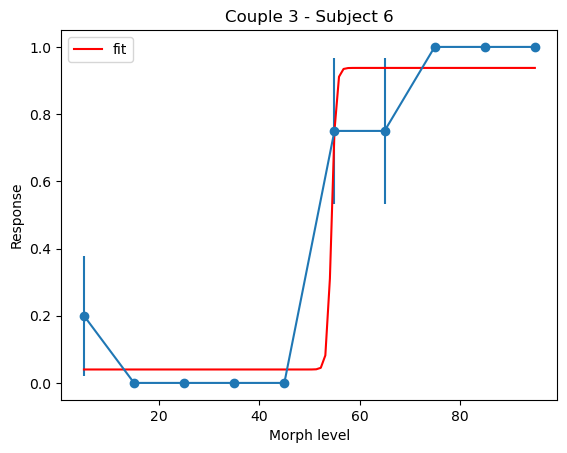

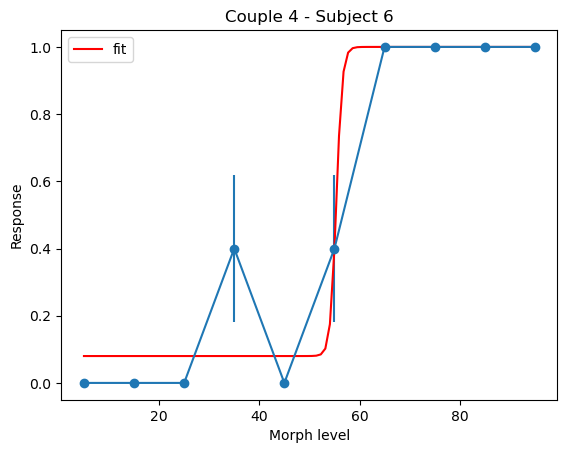

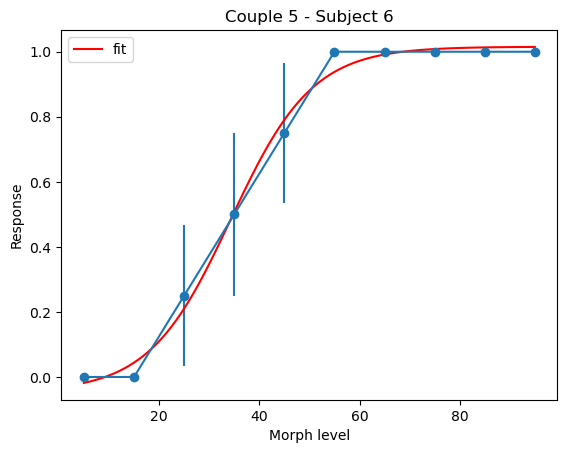

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


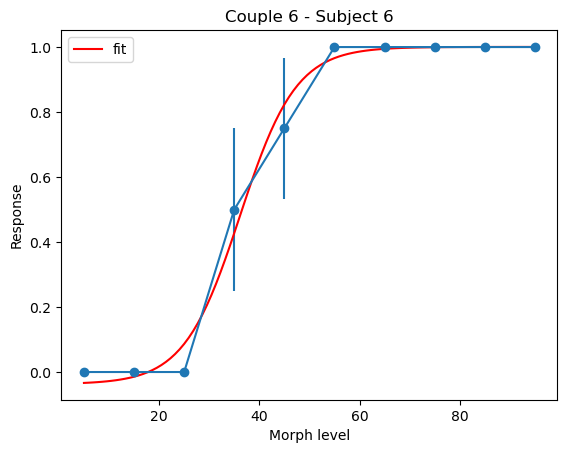

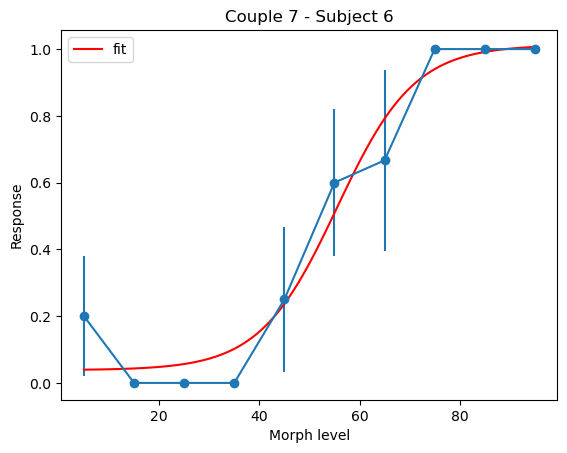

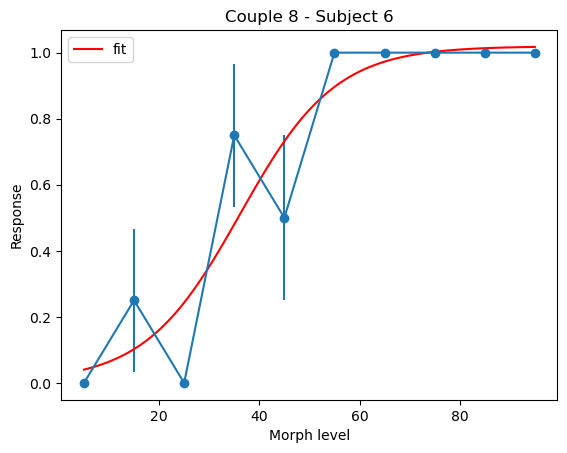

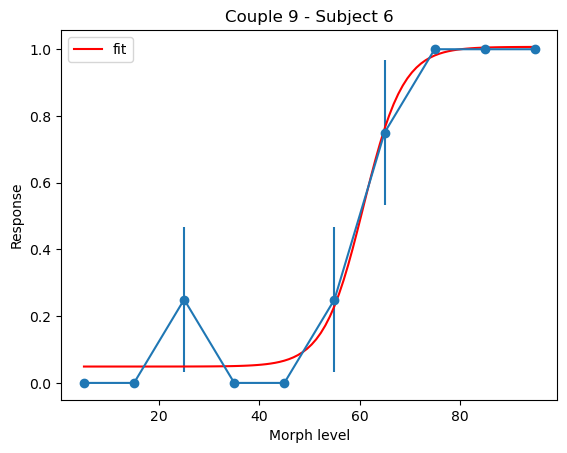

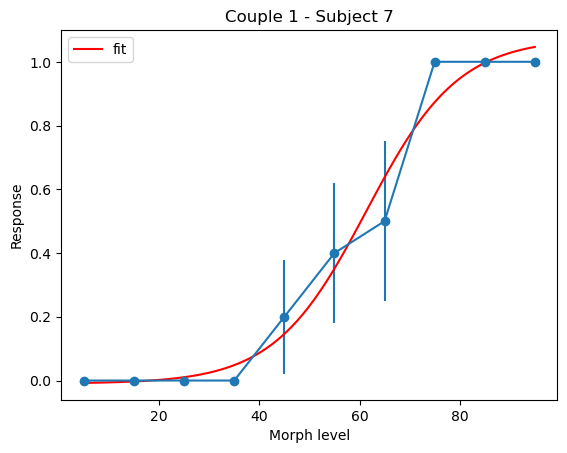

...

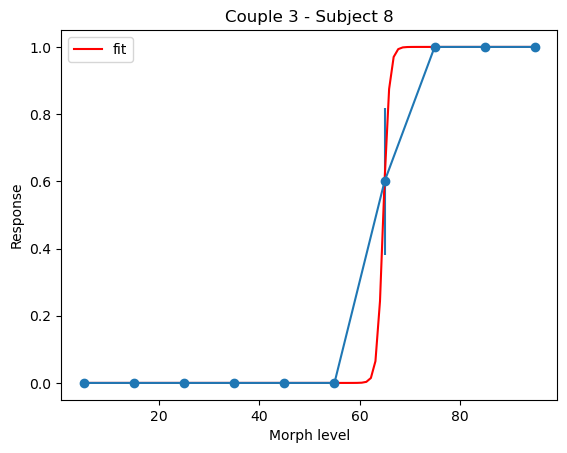

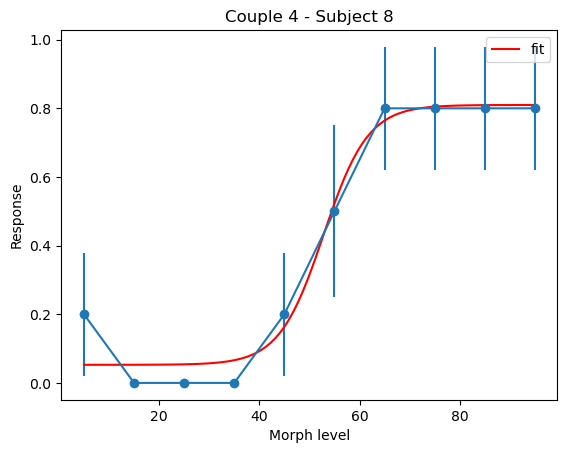

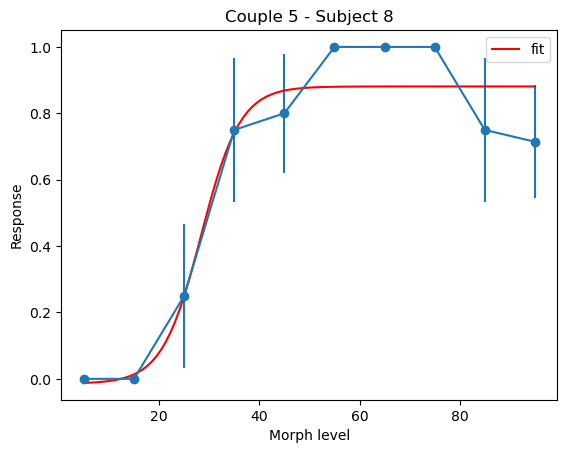

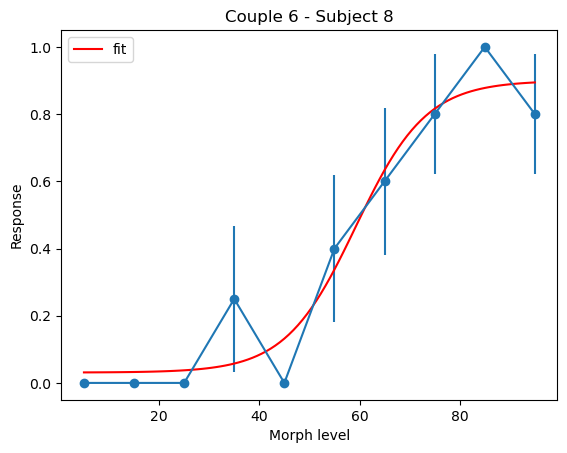

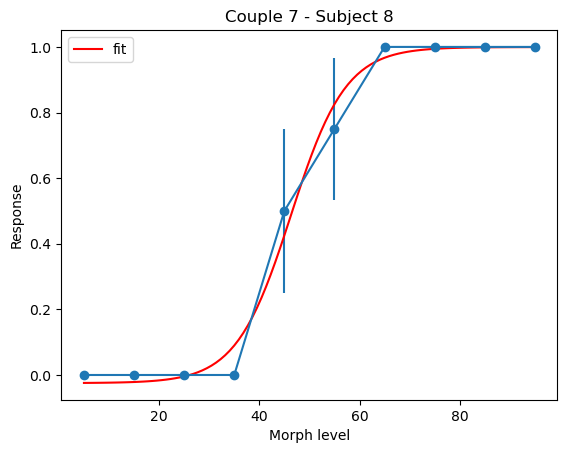

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


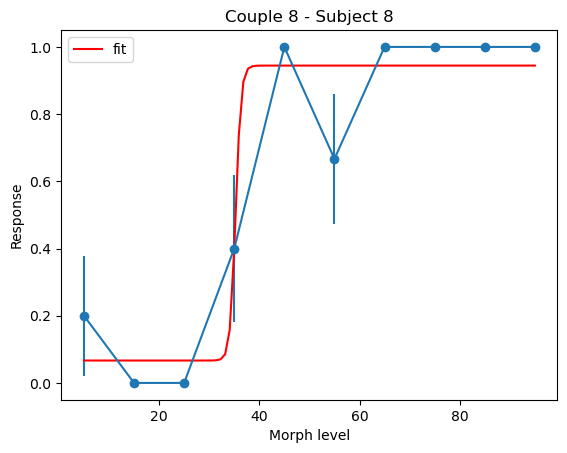

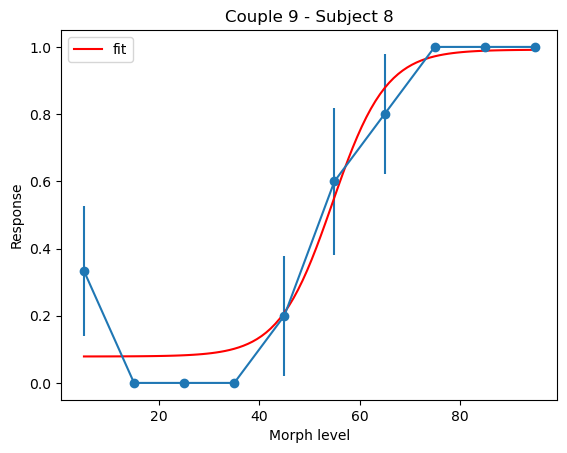

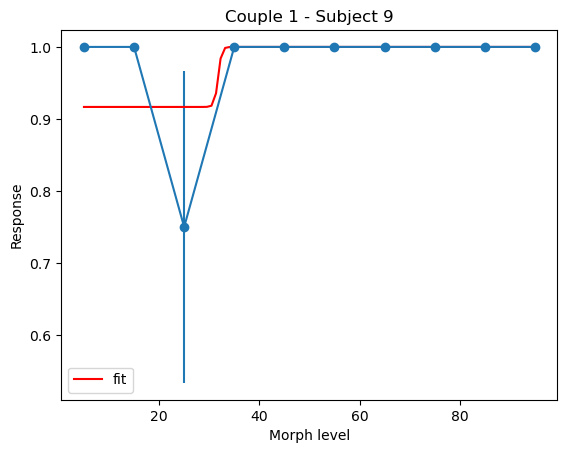

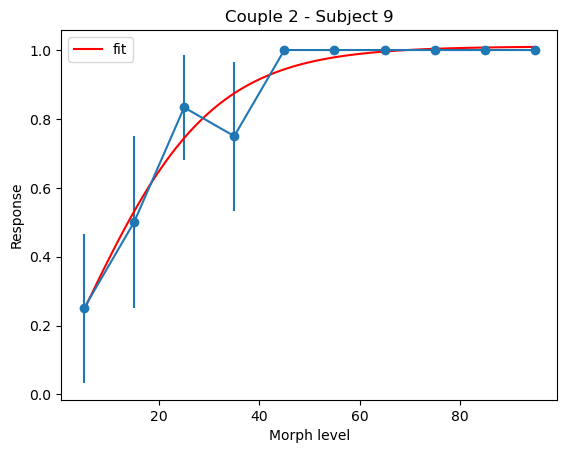

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


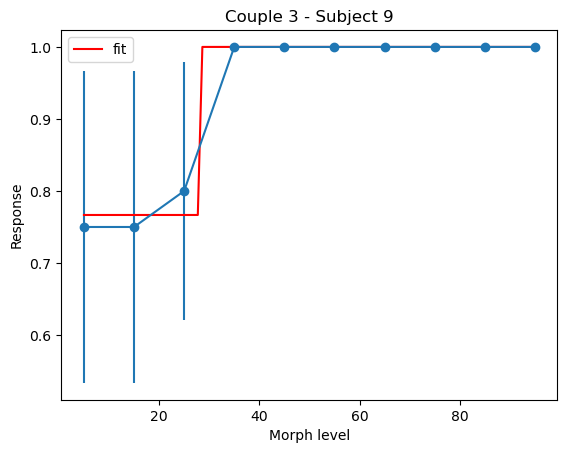

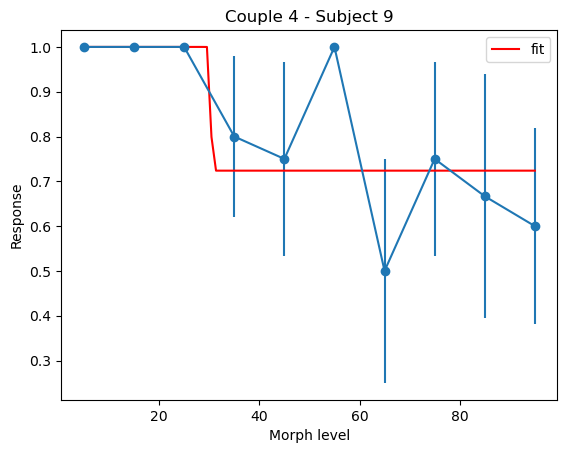

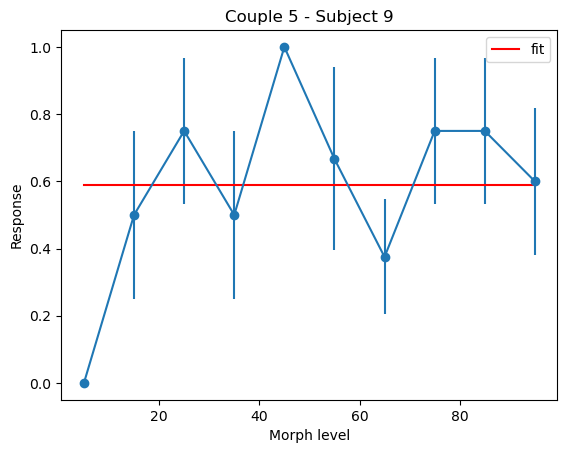

Fit failed for Couple 6 - Subject 9


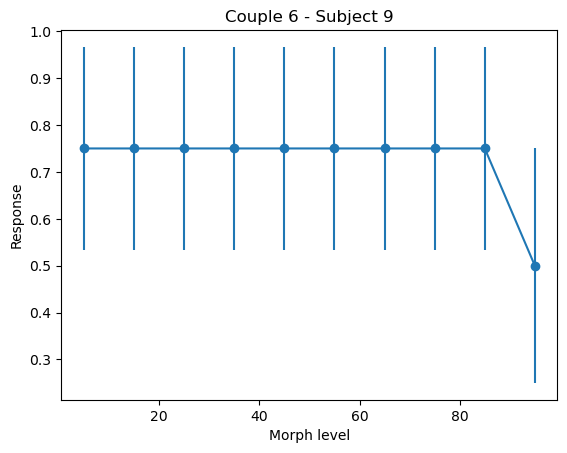

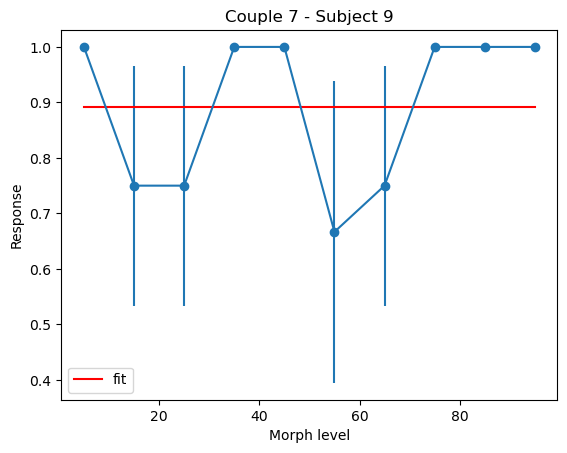

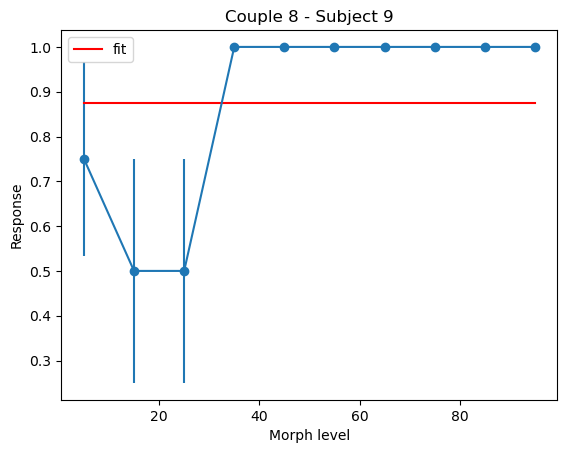

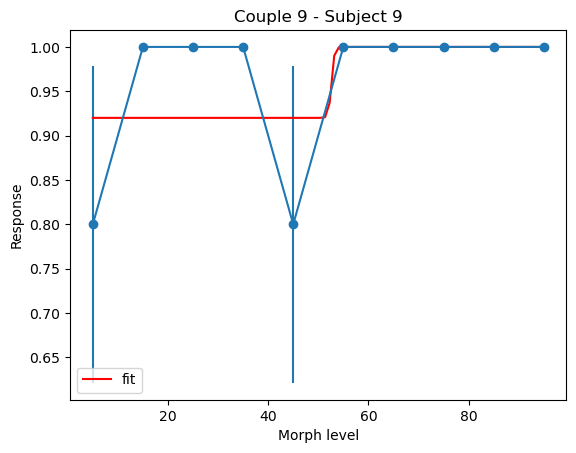

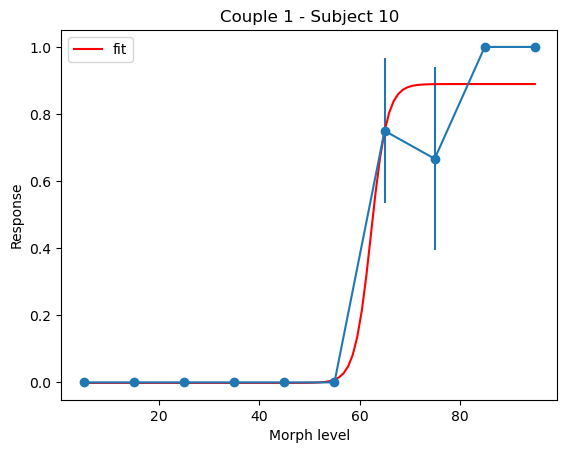

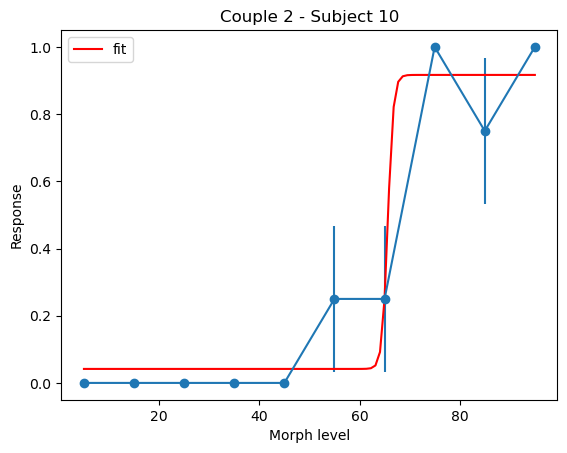

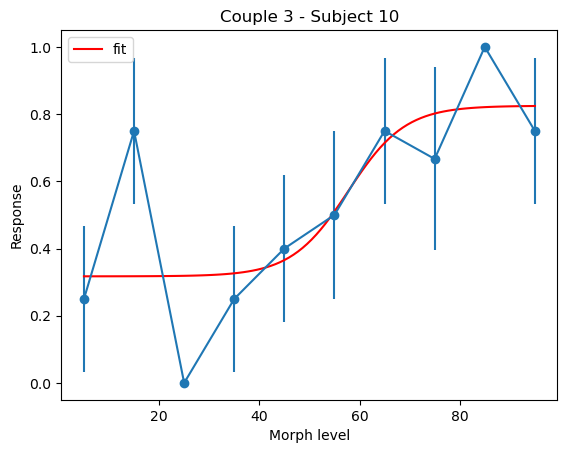

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


Fit failed for Couple 4 - Subject 10


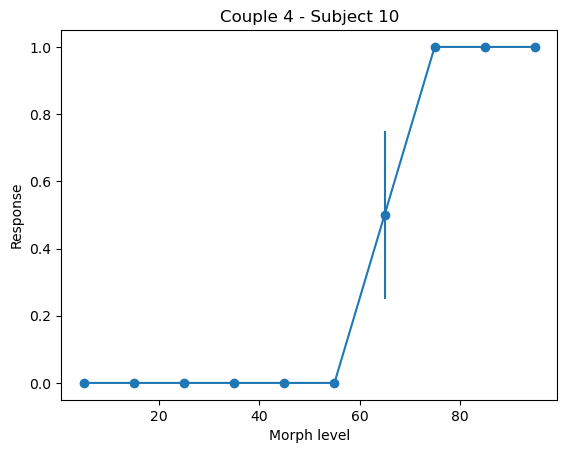

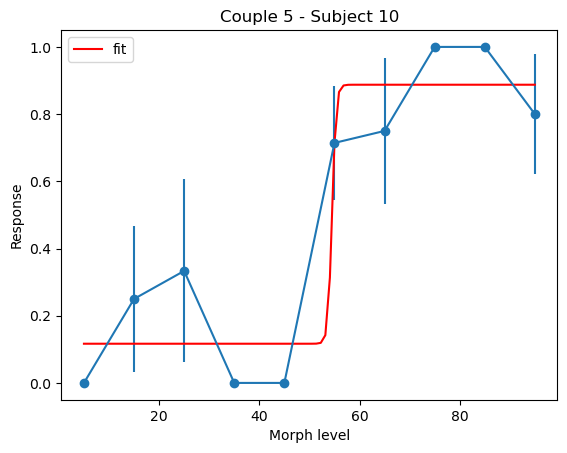

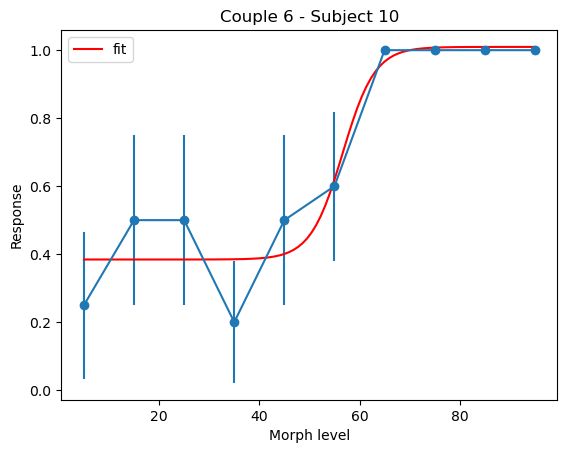

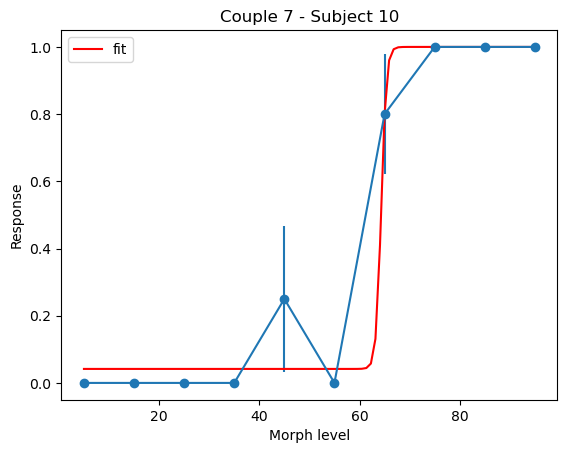

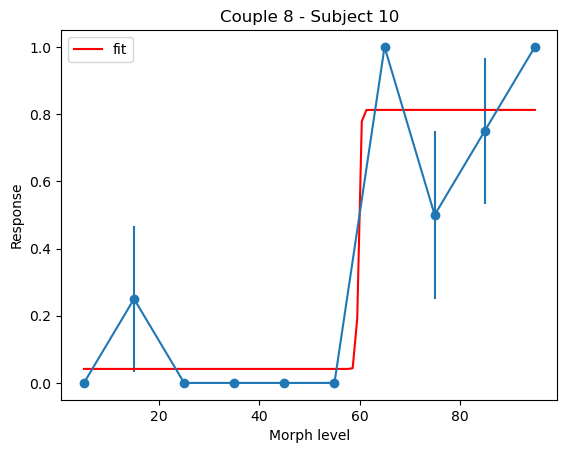

...

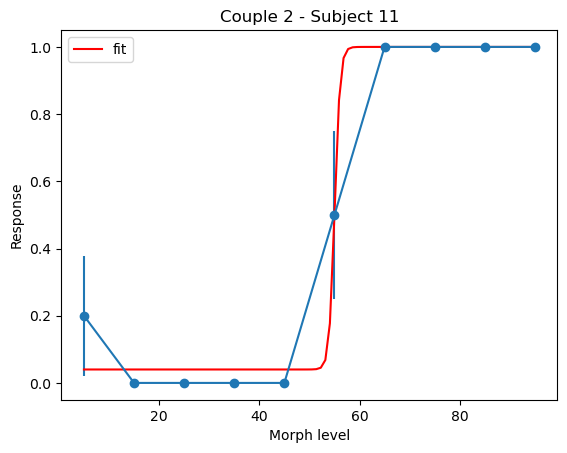

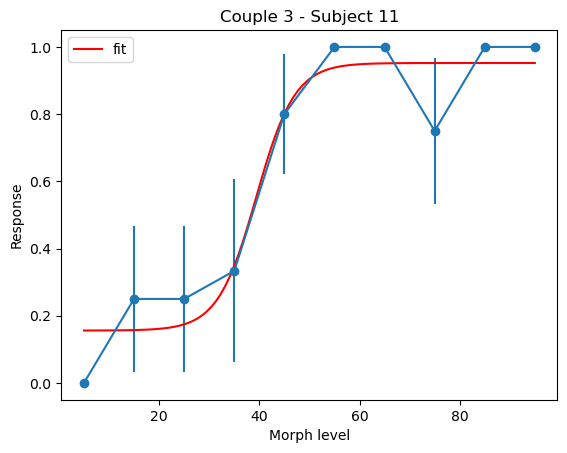

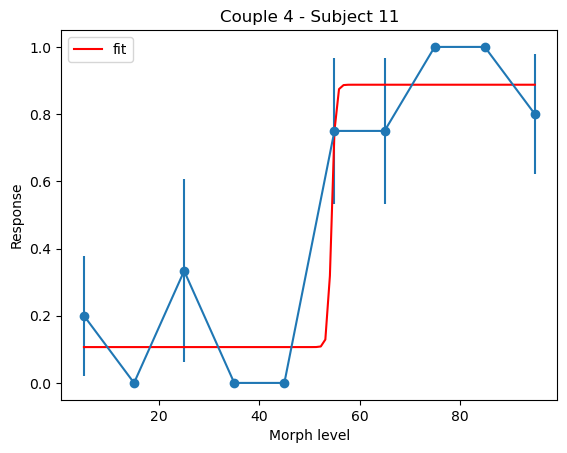

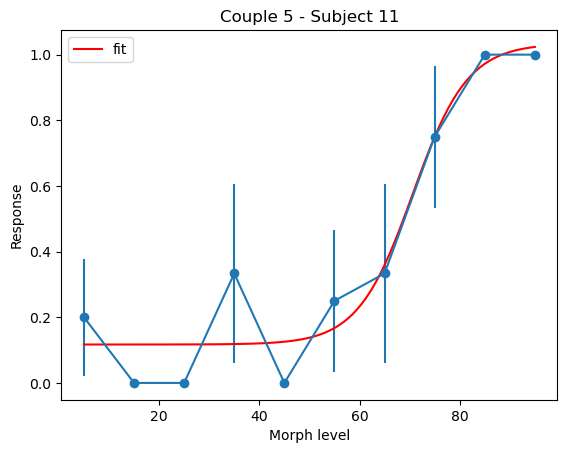

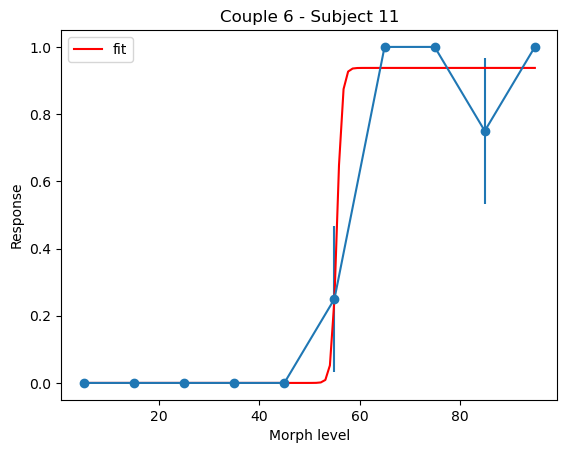

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


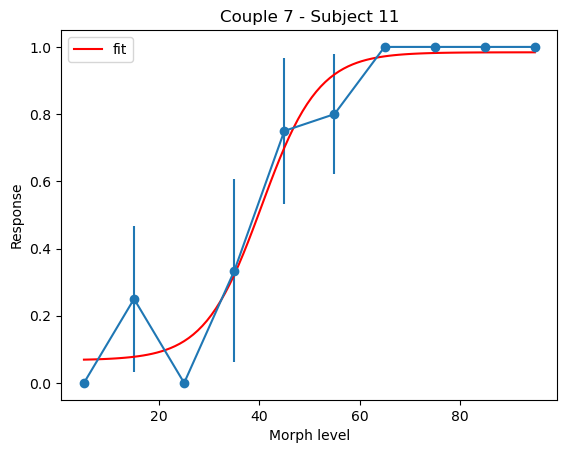

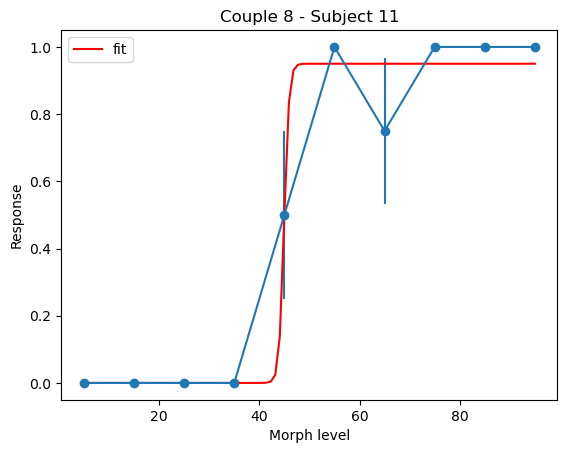

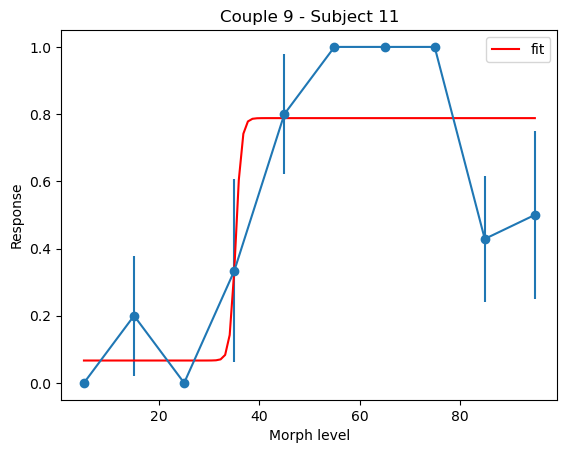

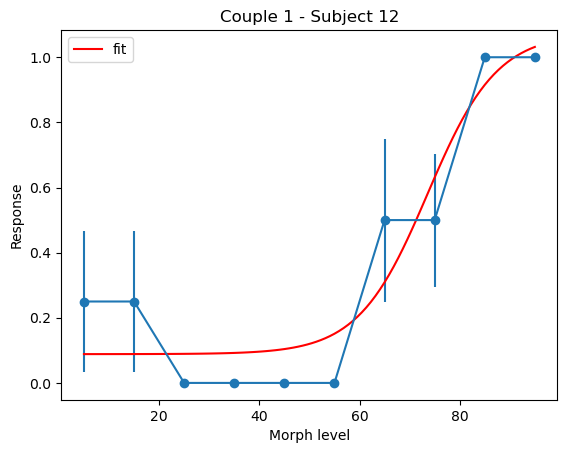

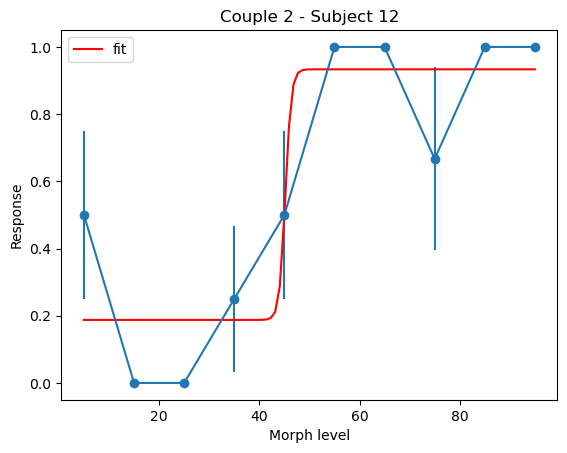

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


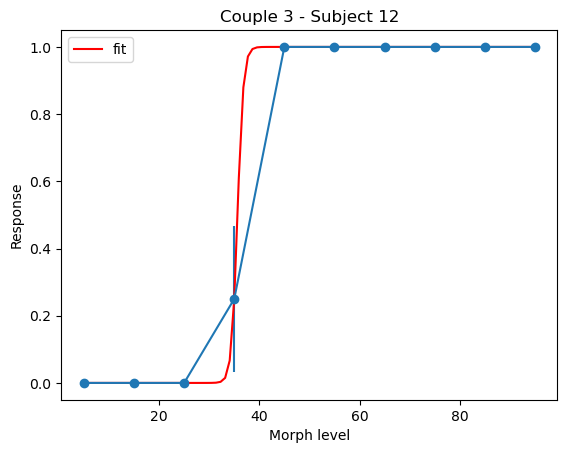

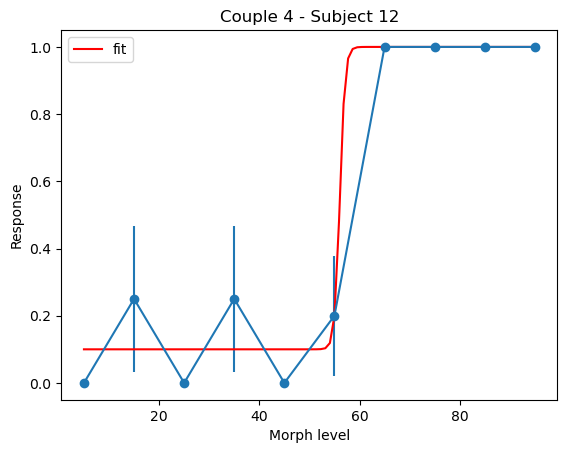

Fit failed for Couple 5 - Subject 12


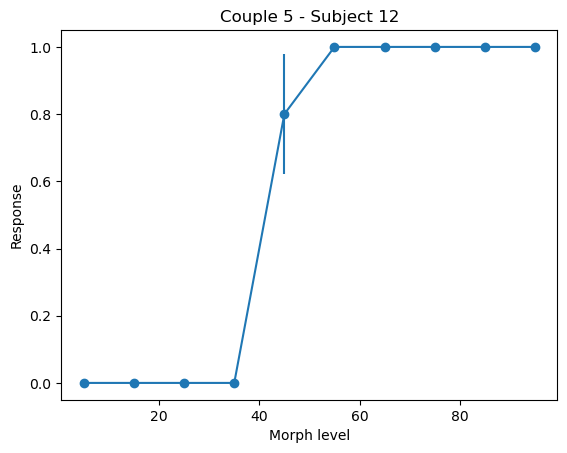

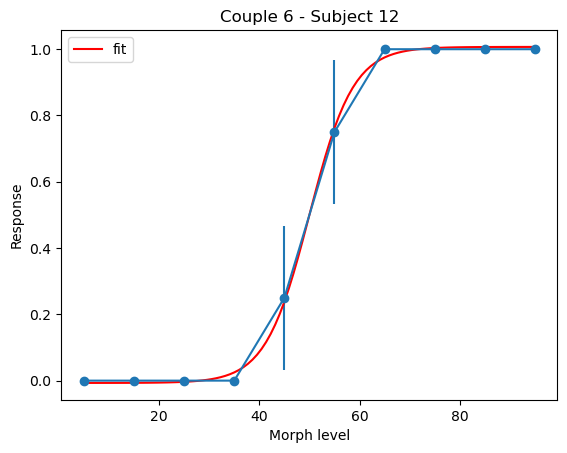

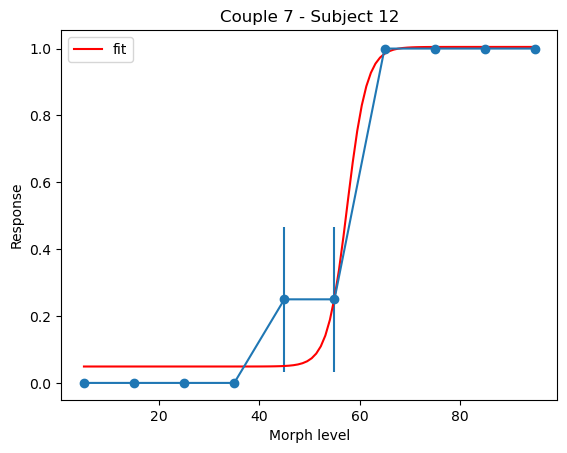

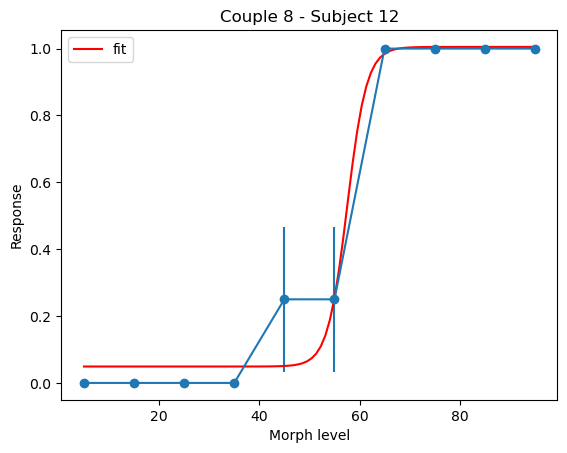

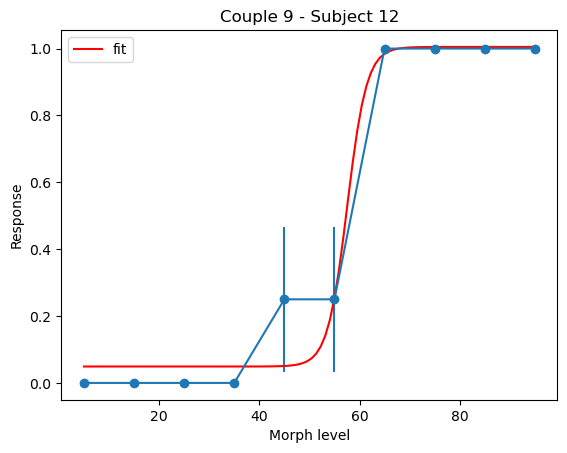

...

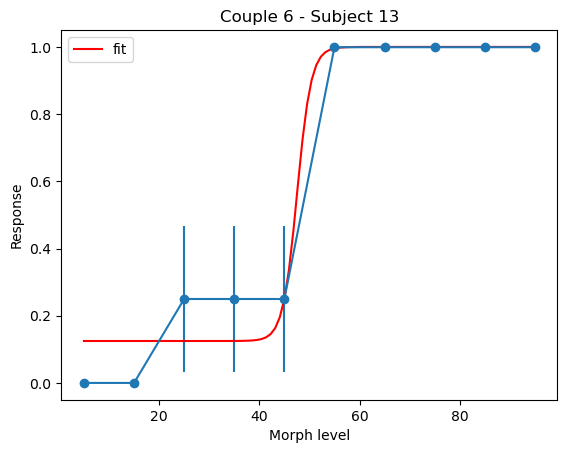

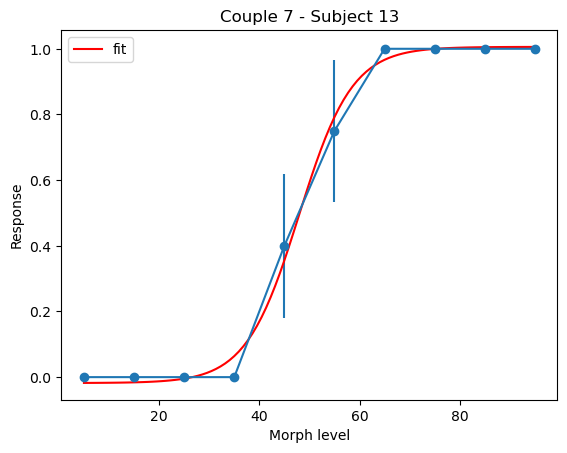

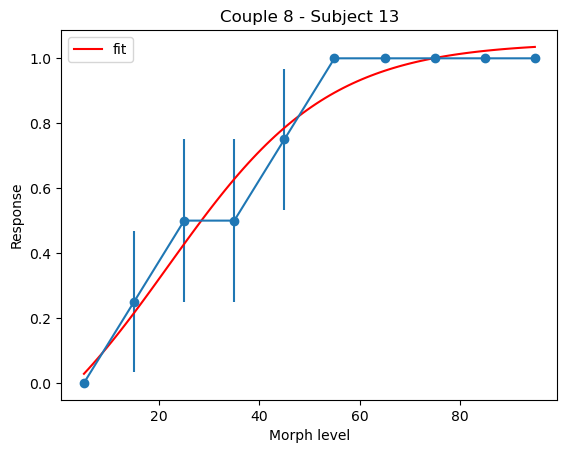

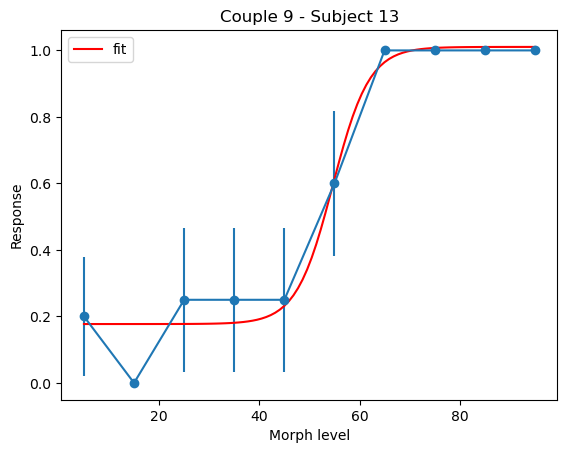

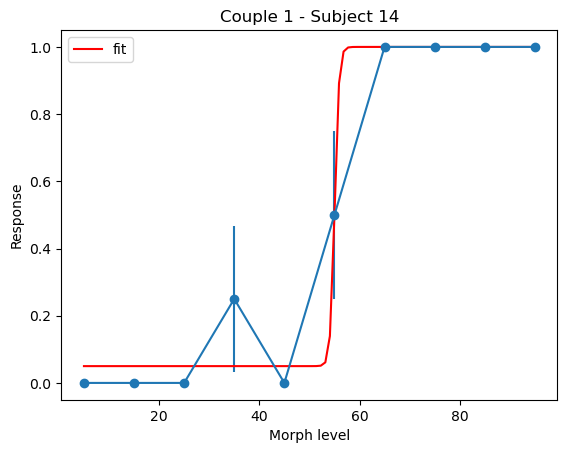

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


Fit failed for Couple 2 - Subject 14


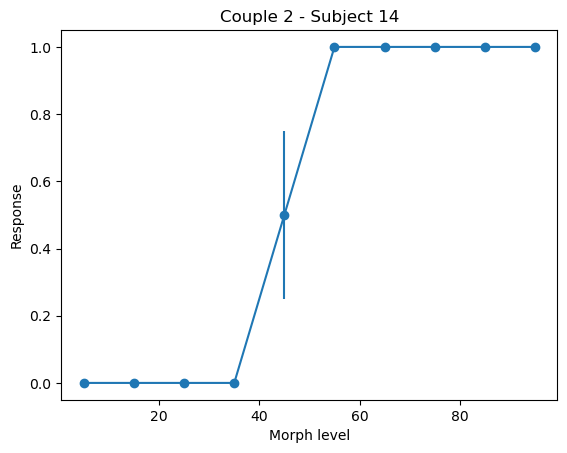

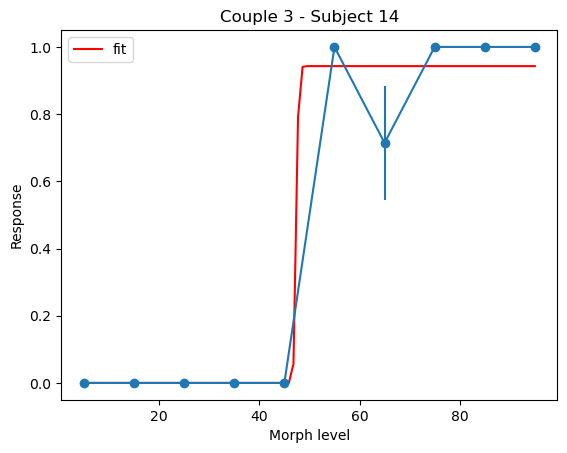

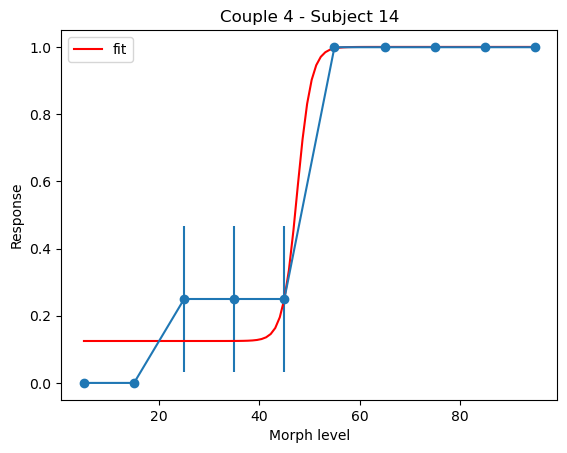

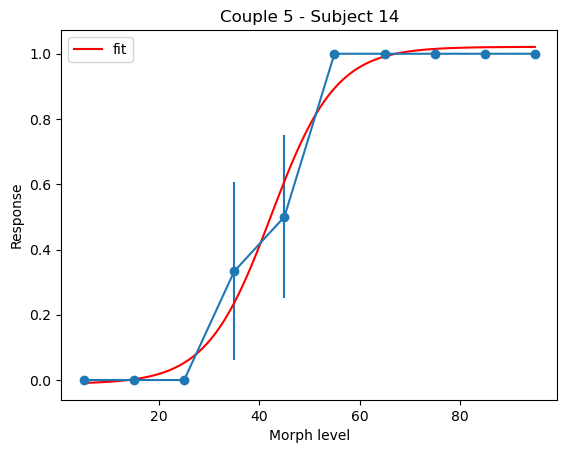

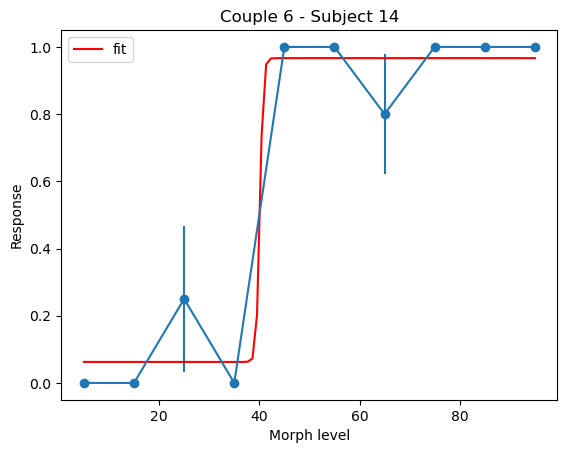

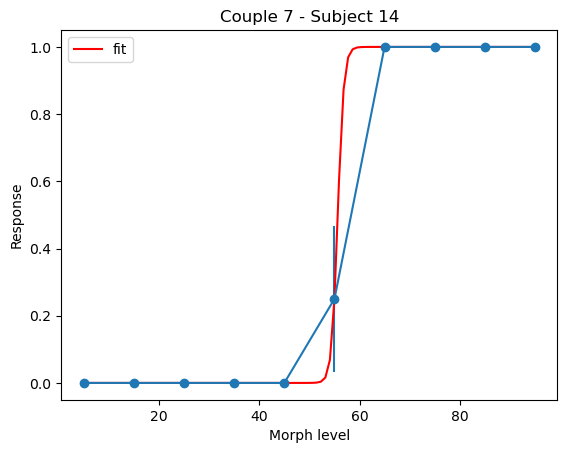

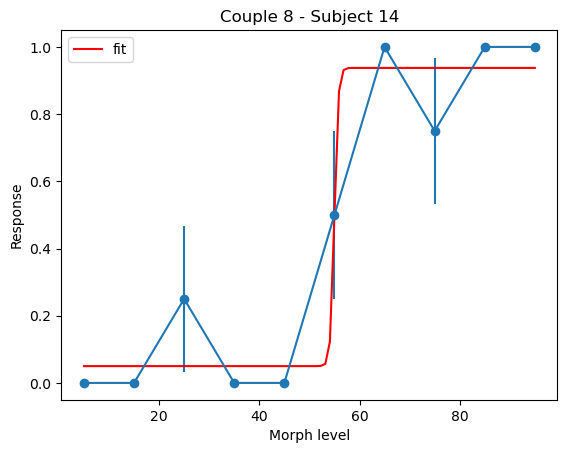

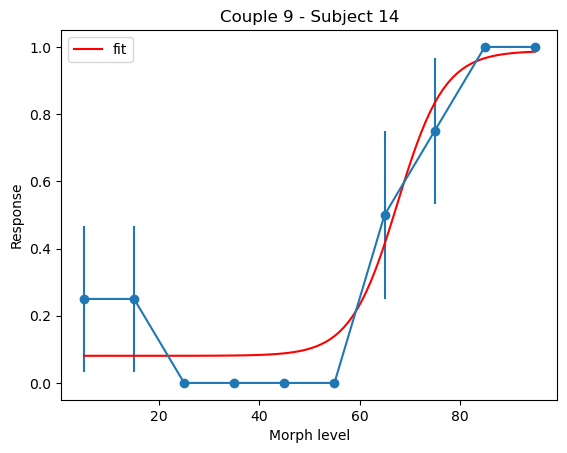

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


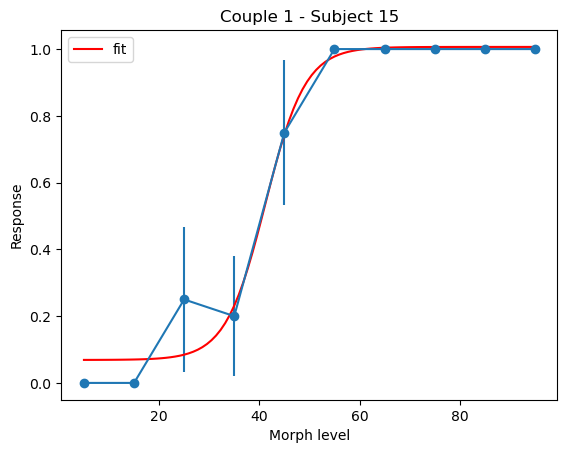

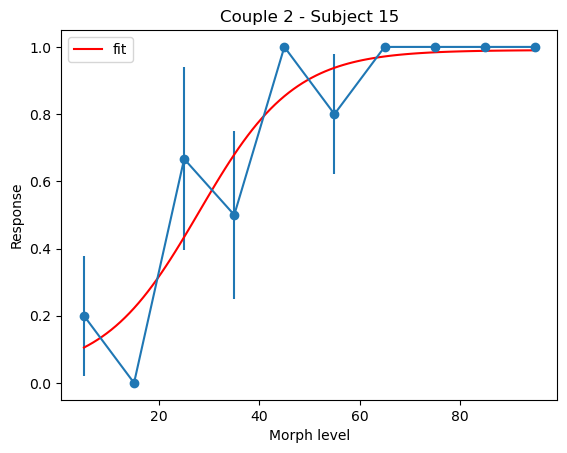

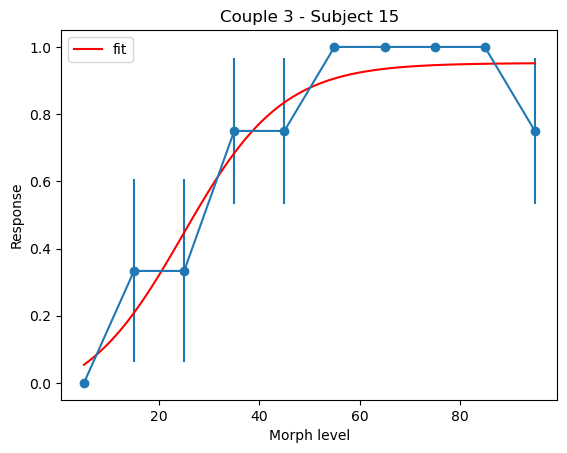

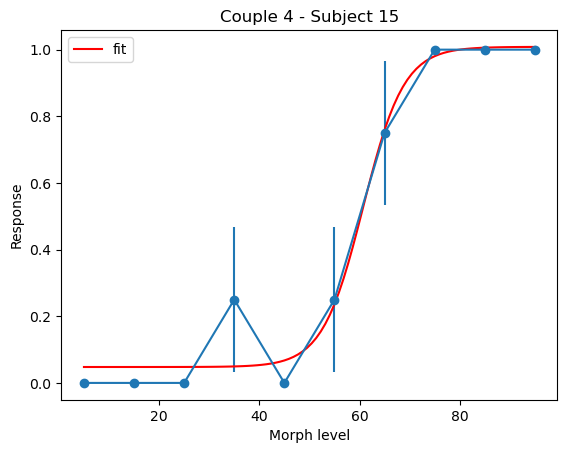

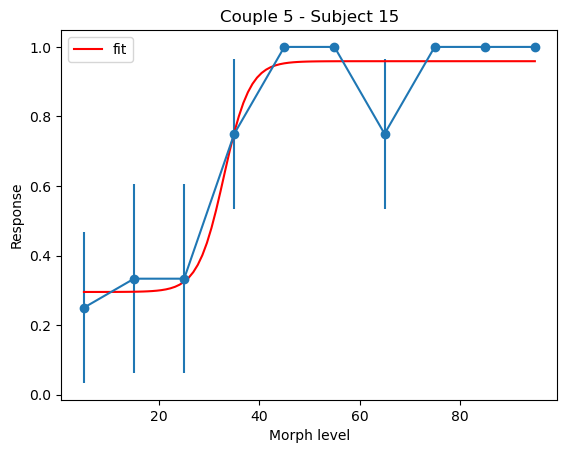

...

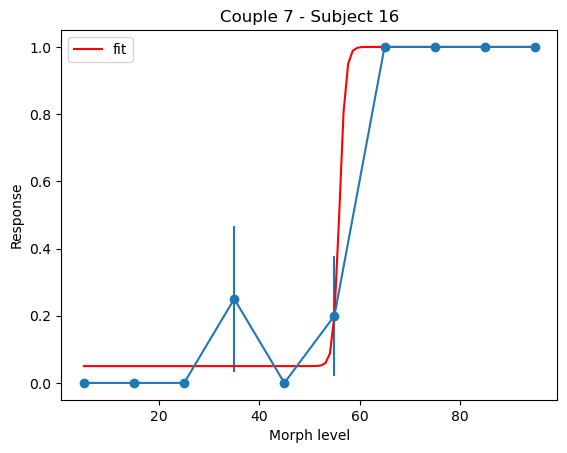

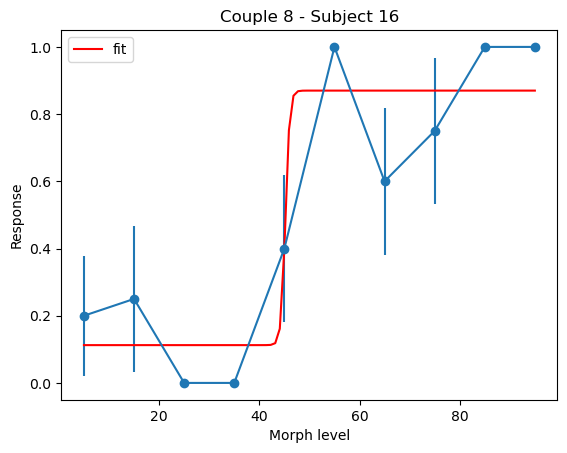

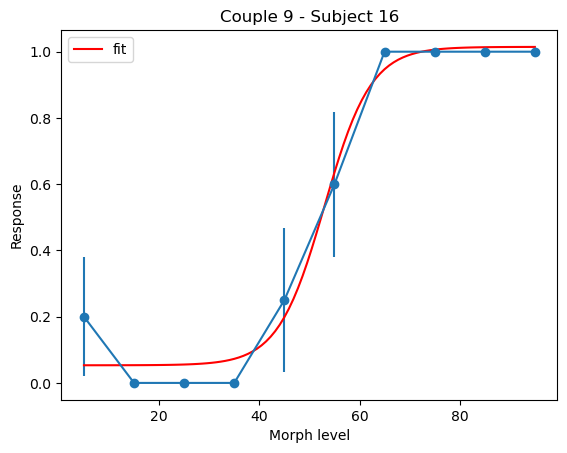

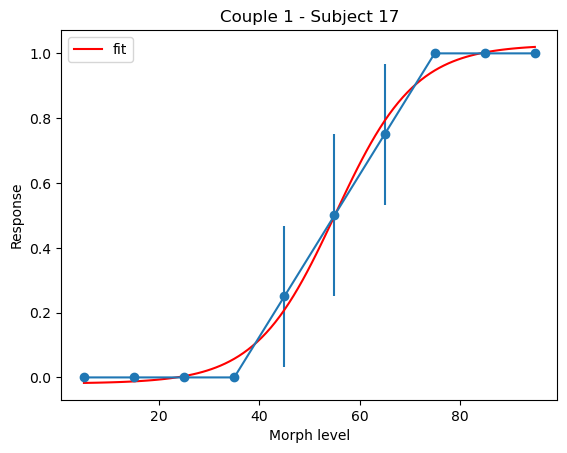

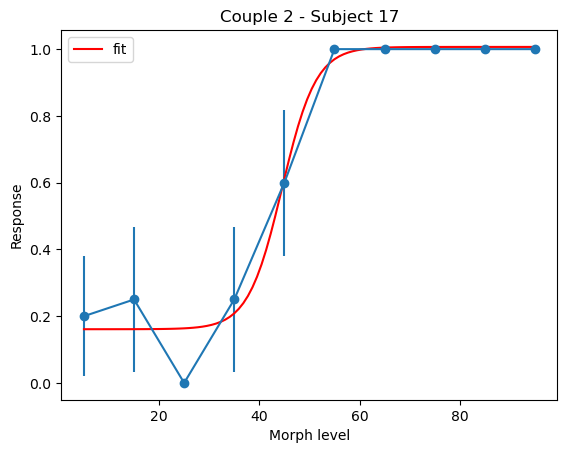

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


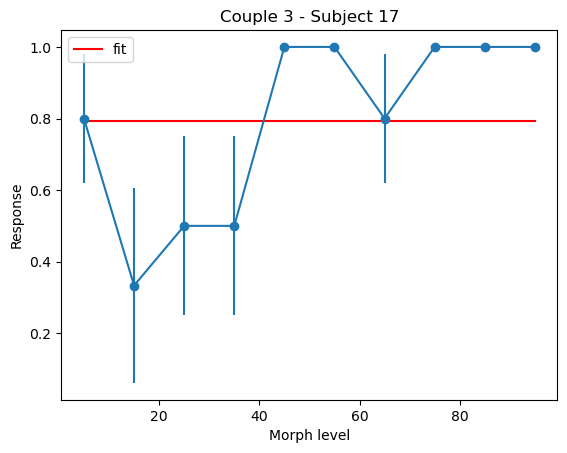

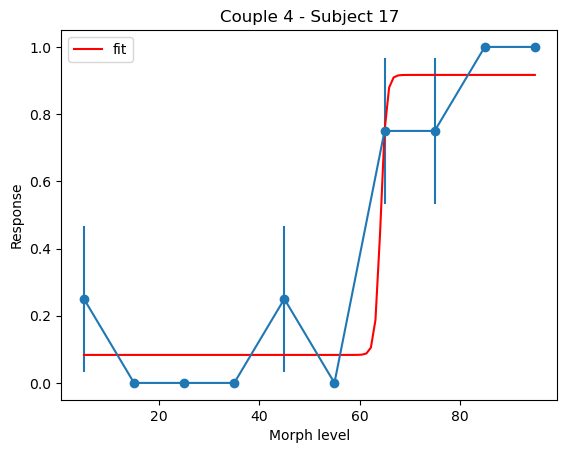

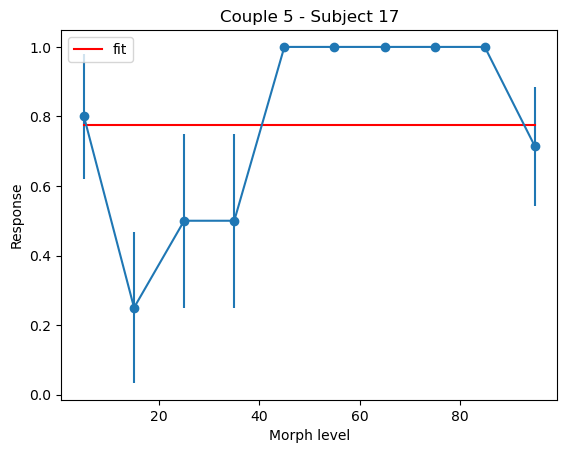

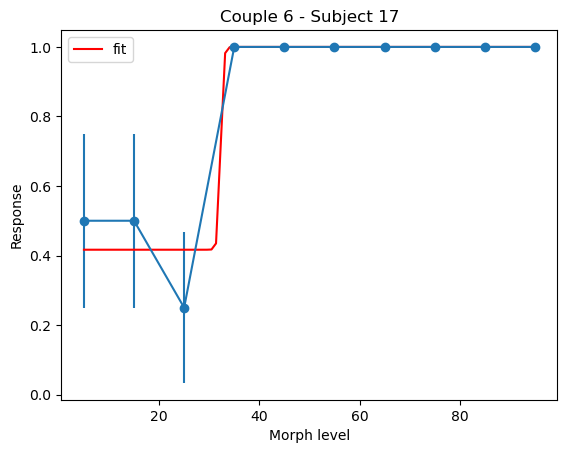

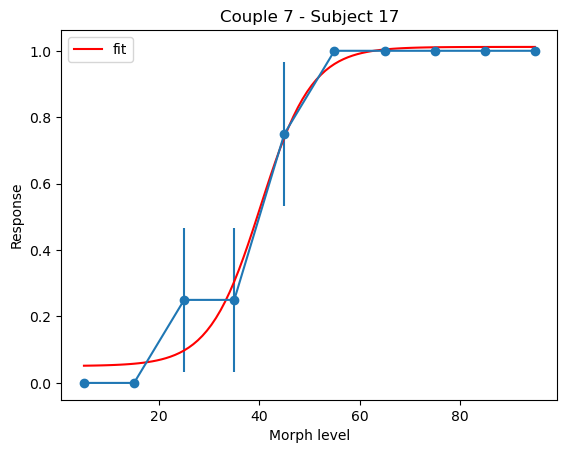

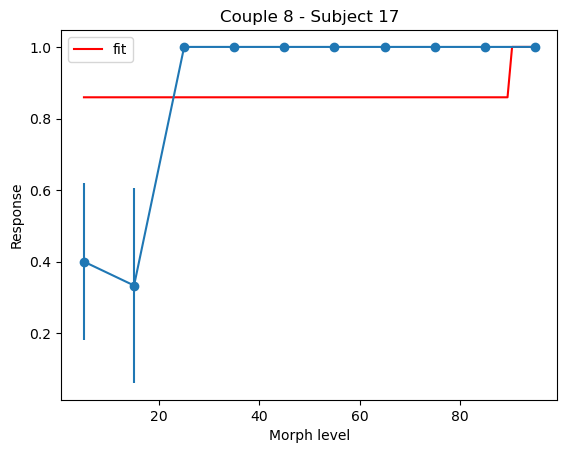

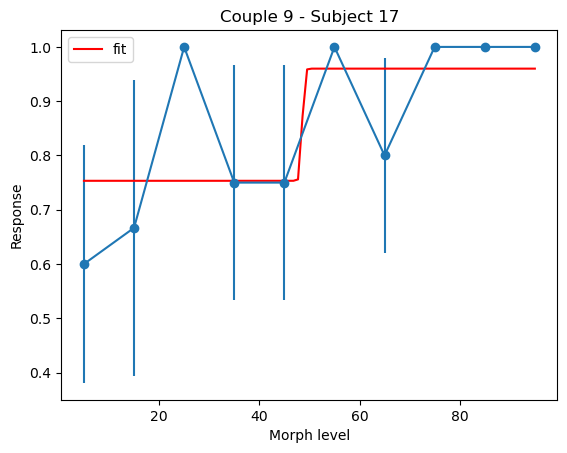

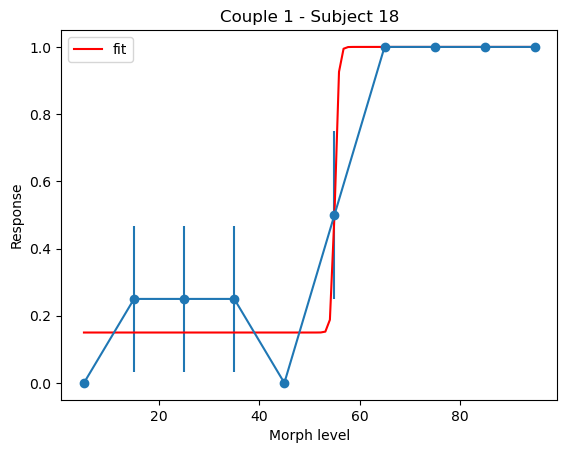

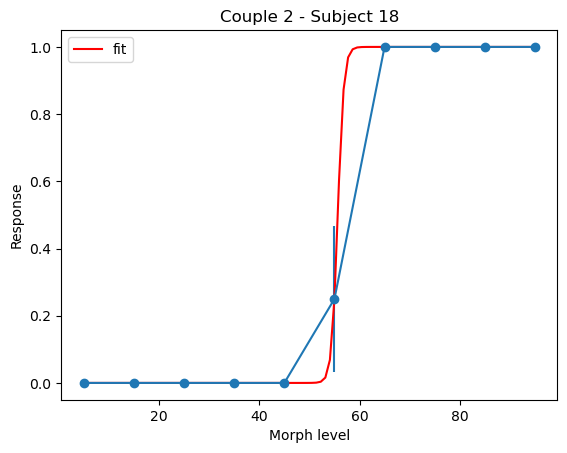

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


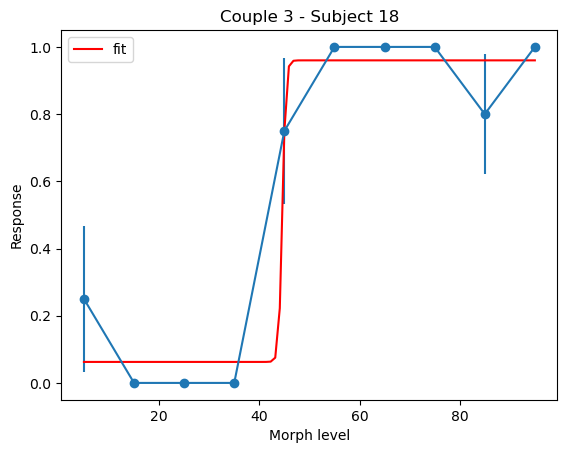

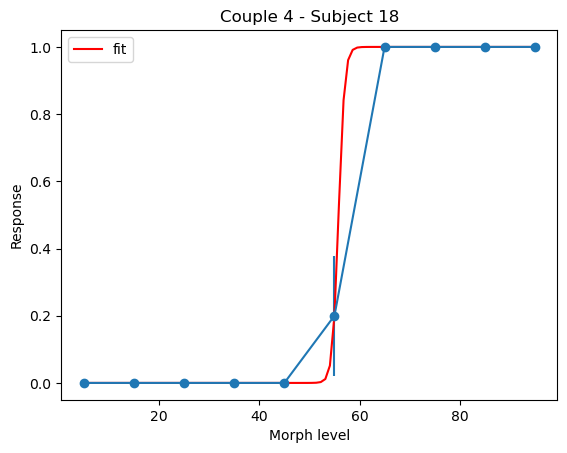

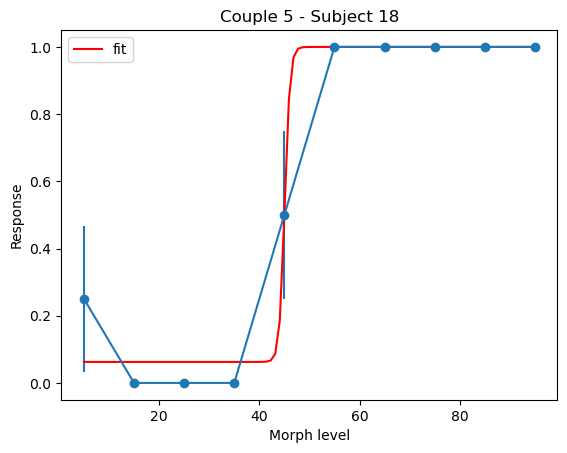

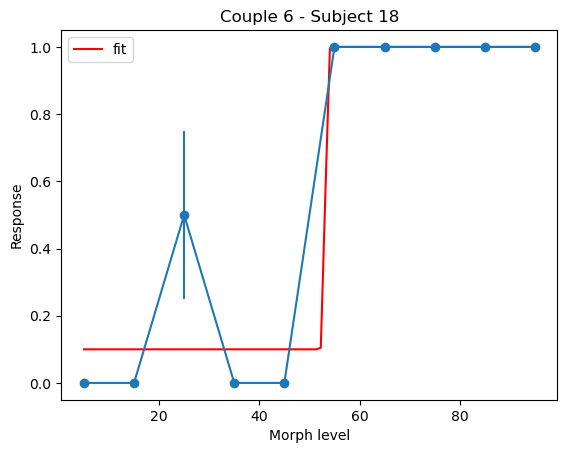

Fit failed for Couple 7 - Subject 18


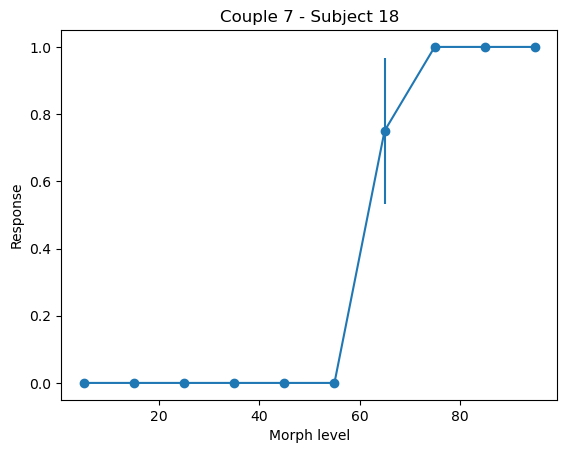

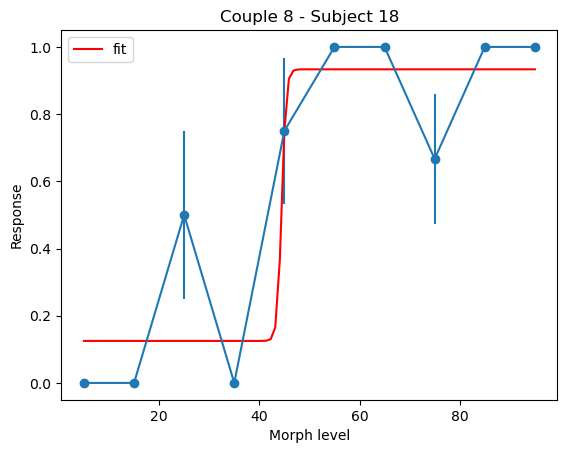

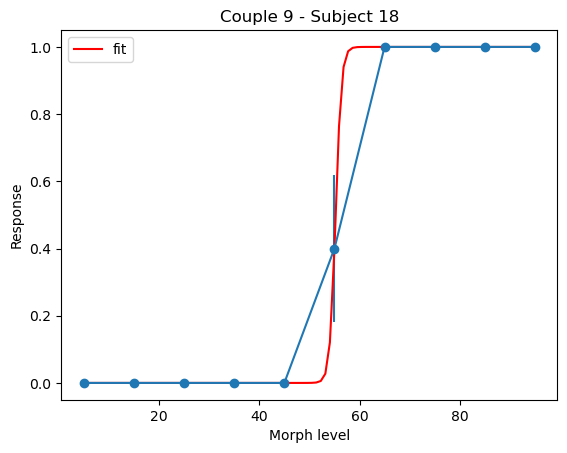

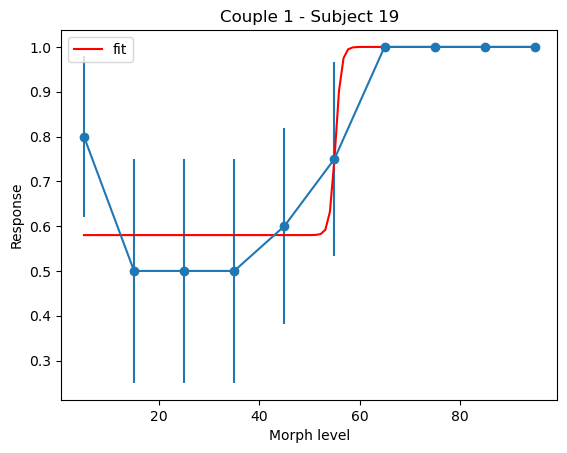

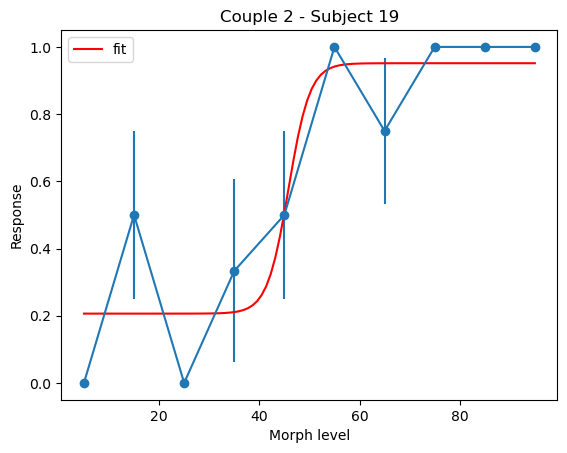

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


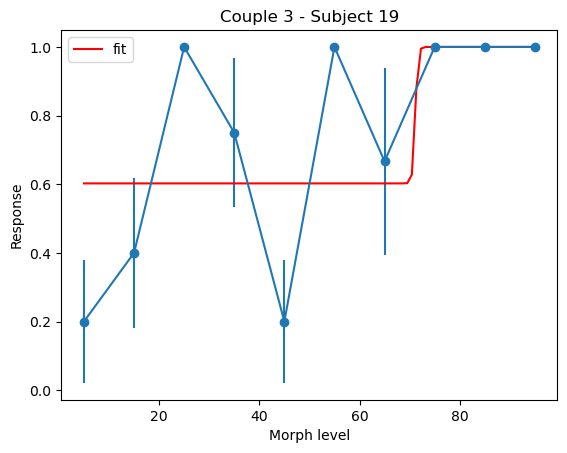

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


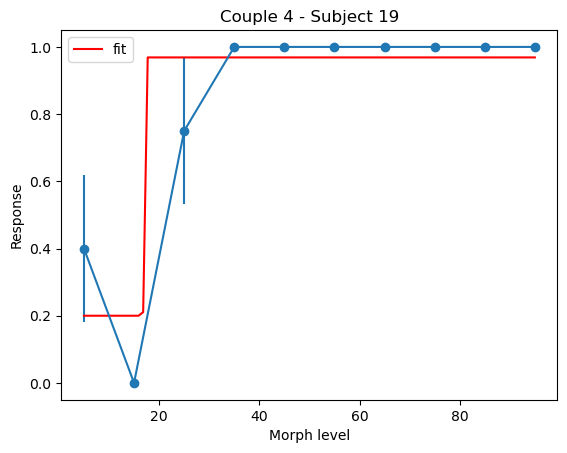

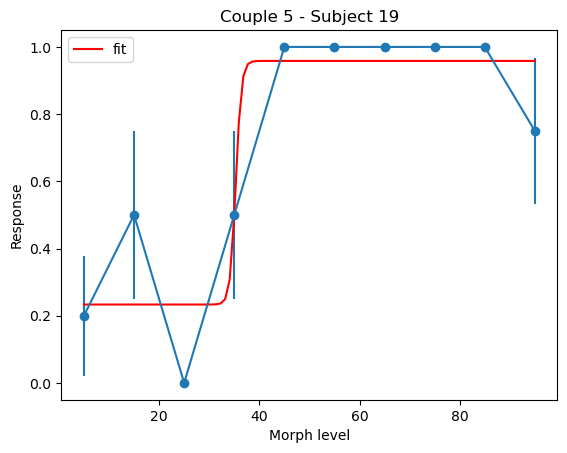

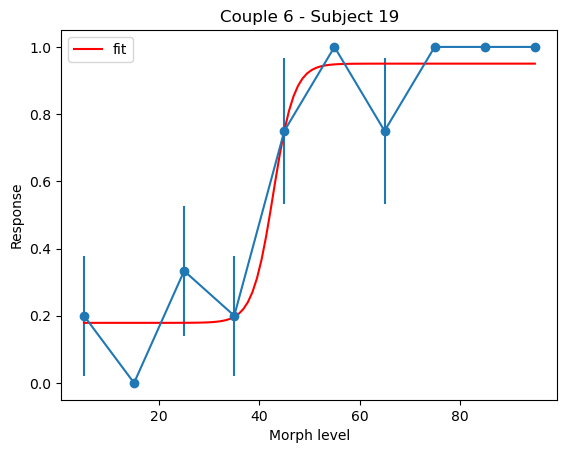

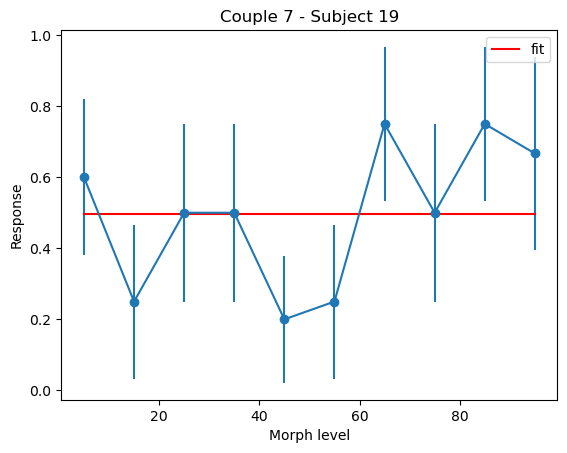

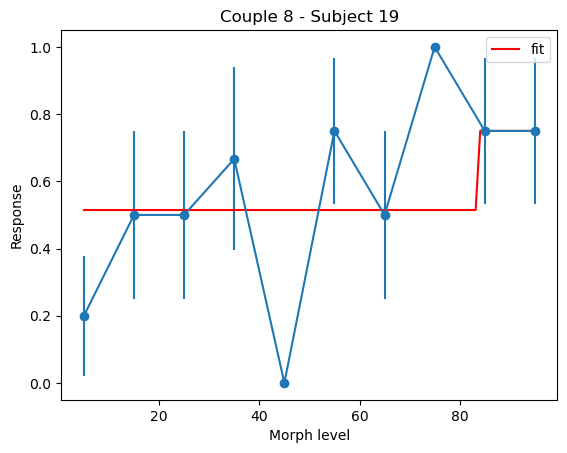

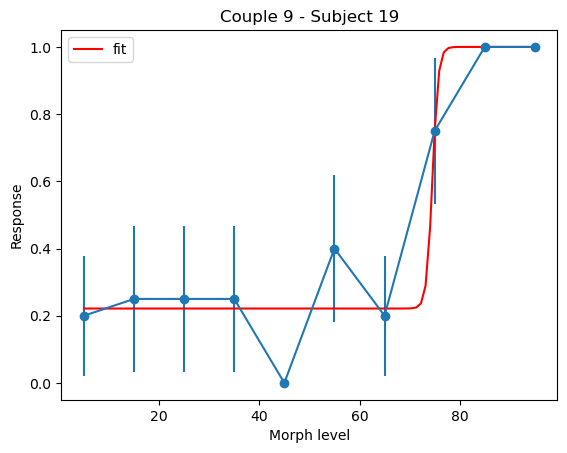

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


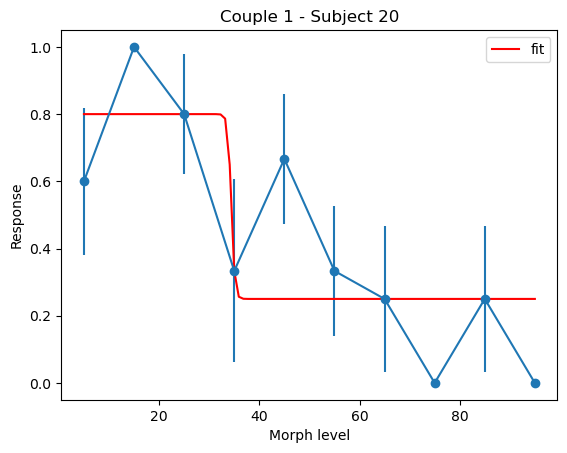

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


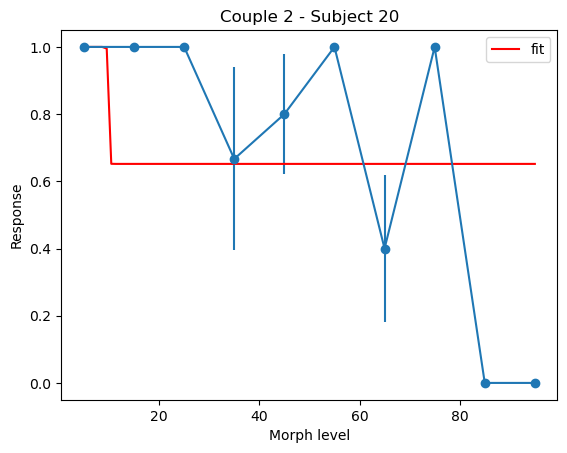

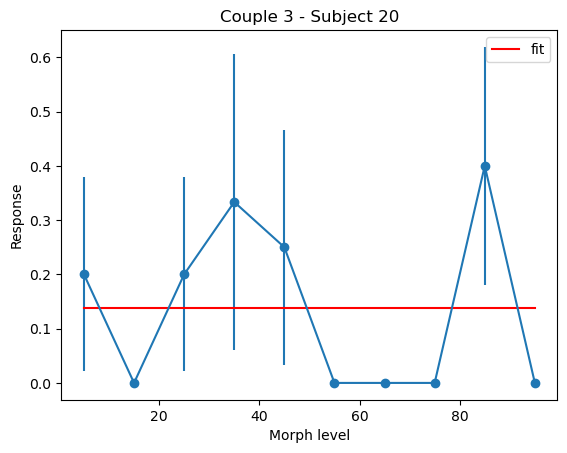

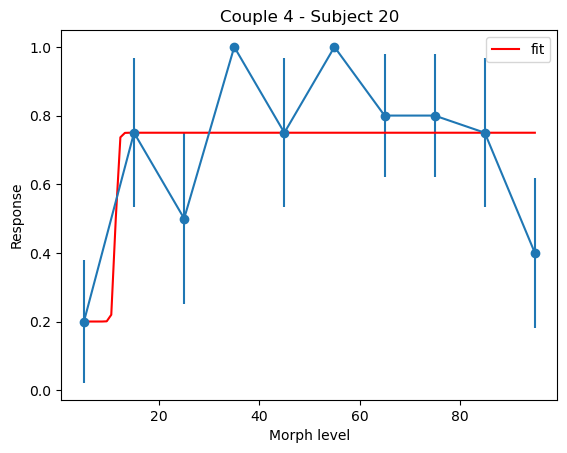

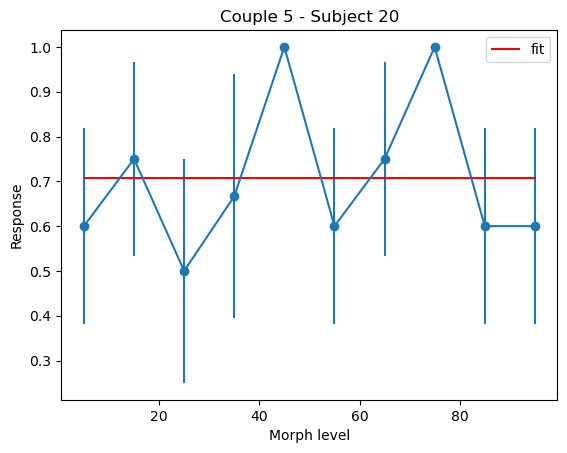

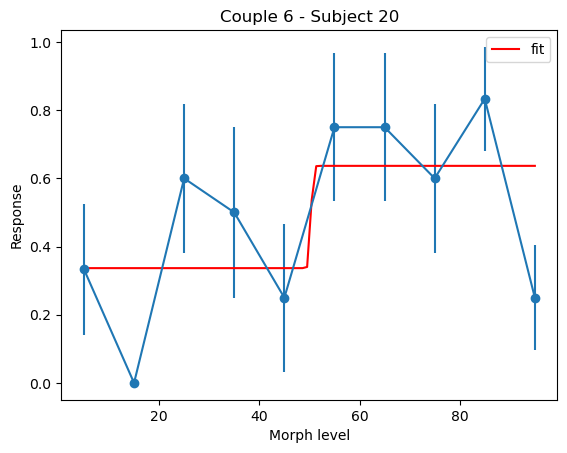

...

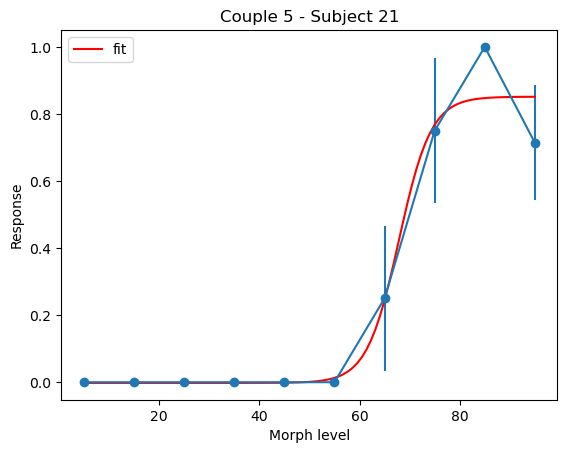

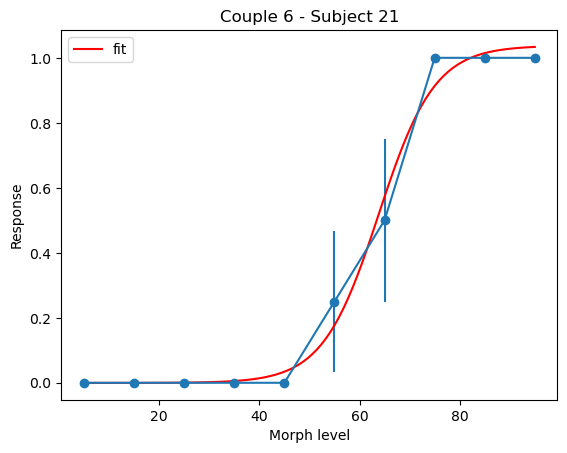

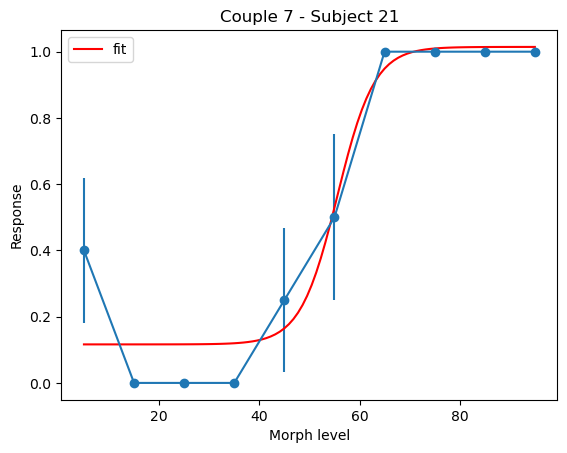

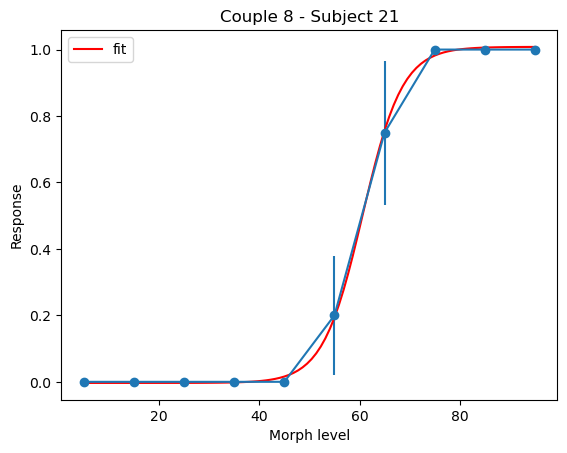

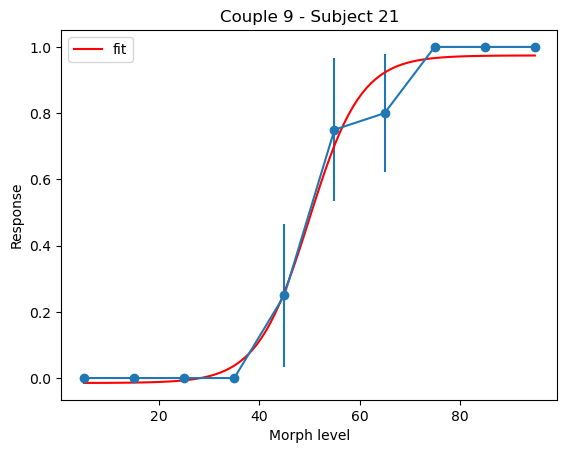

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


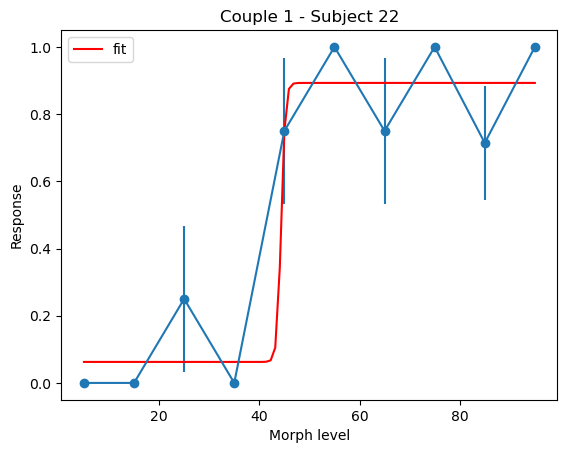

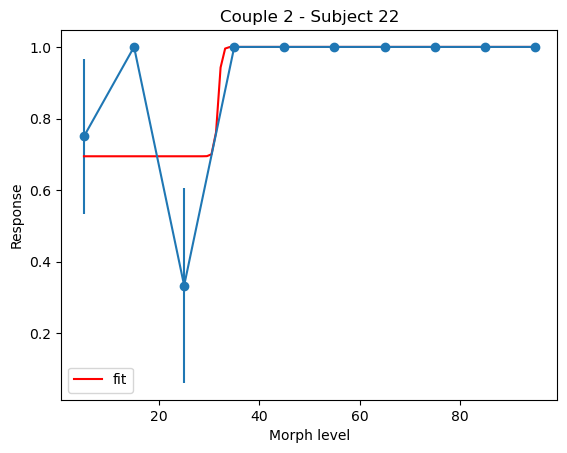

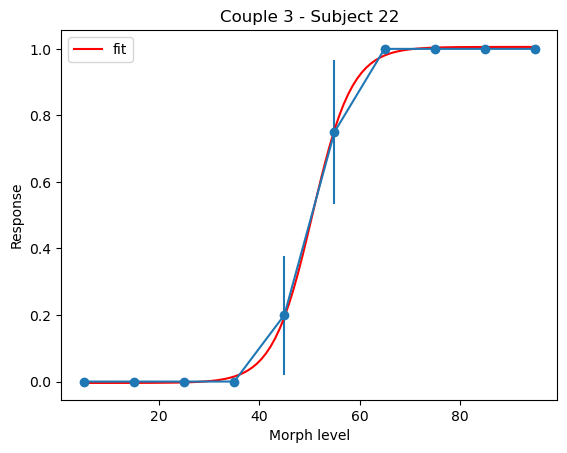

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


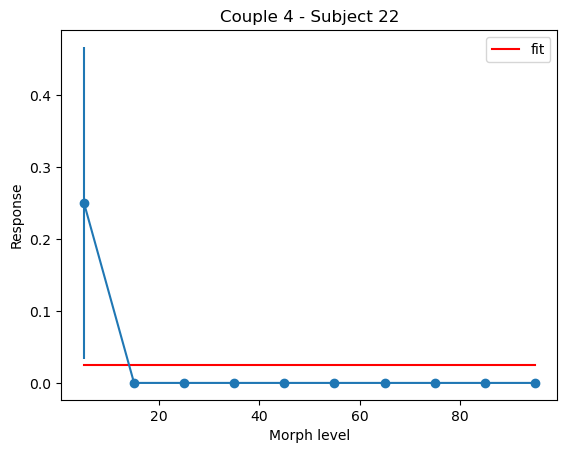

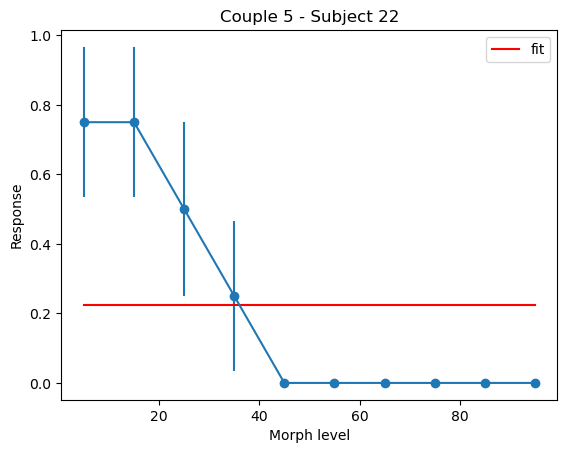

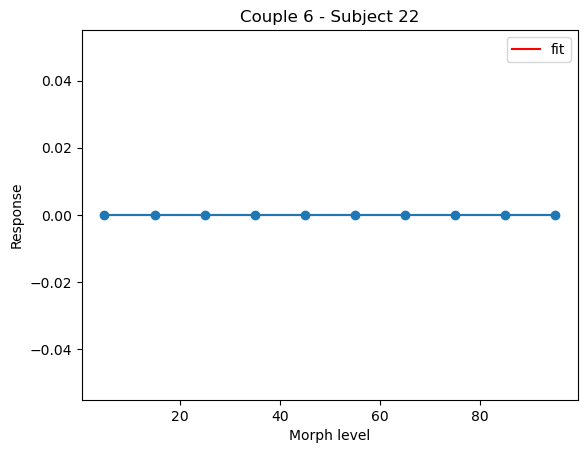

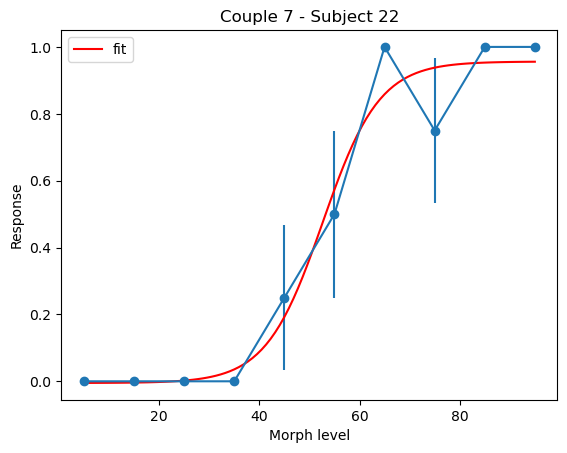

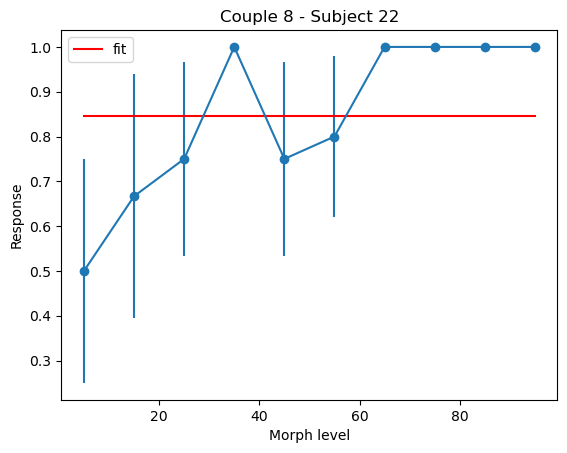

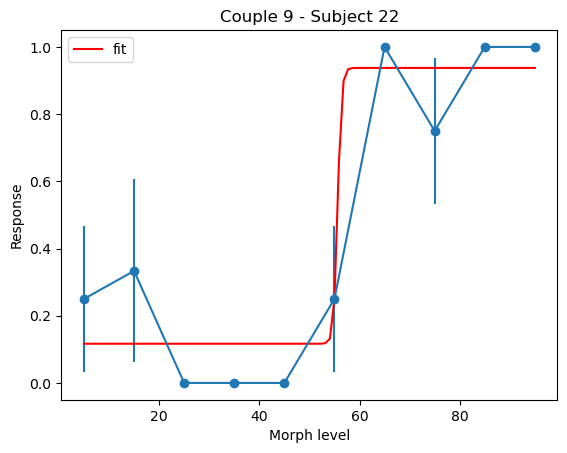

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


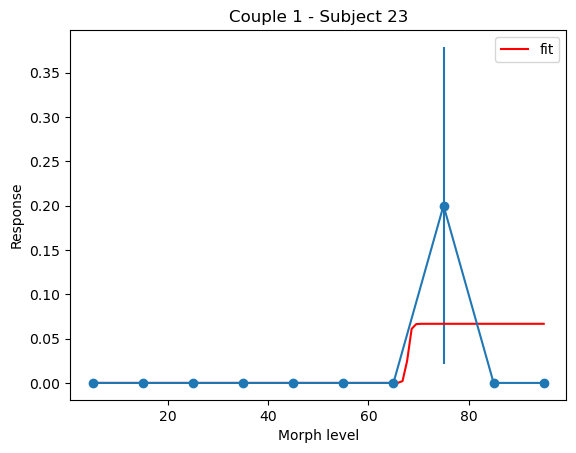

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


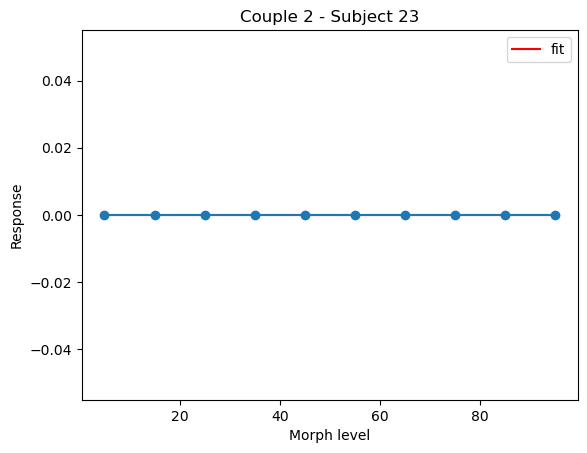

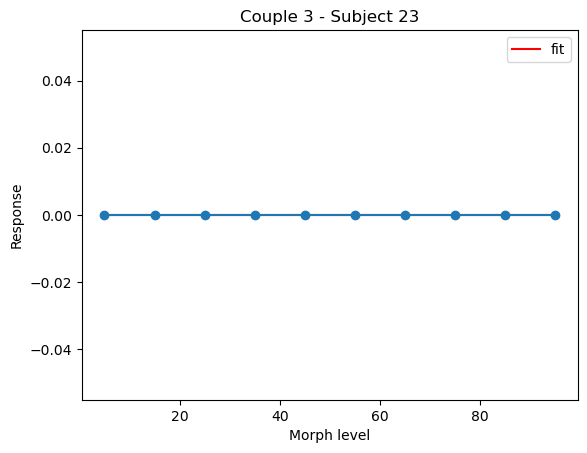

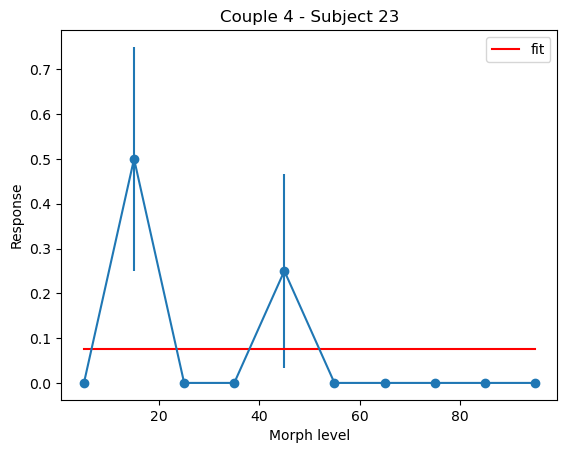

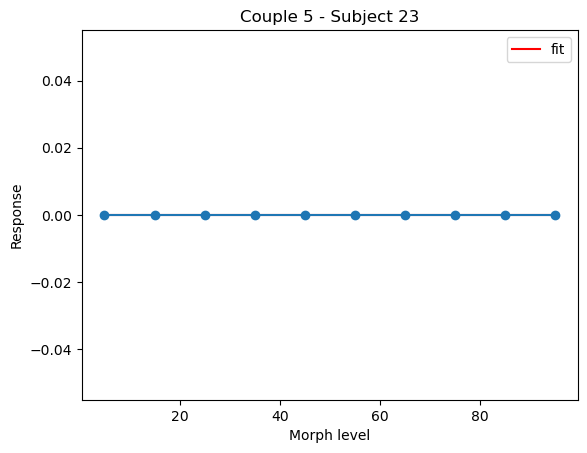

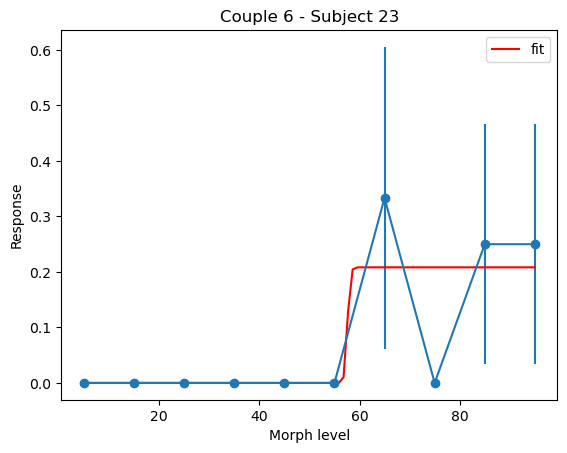

...

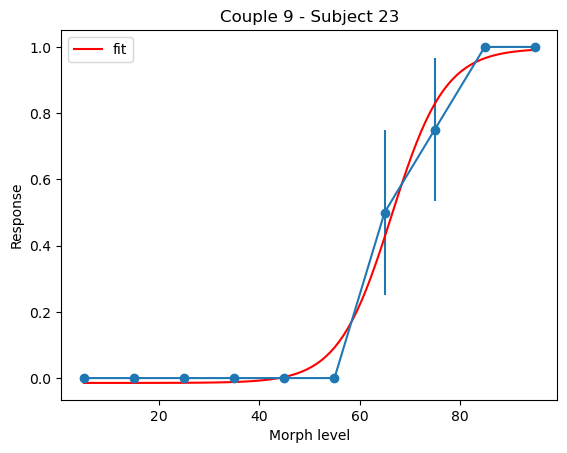

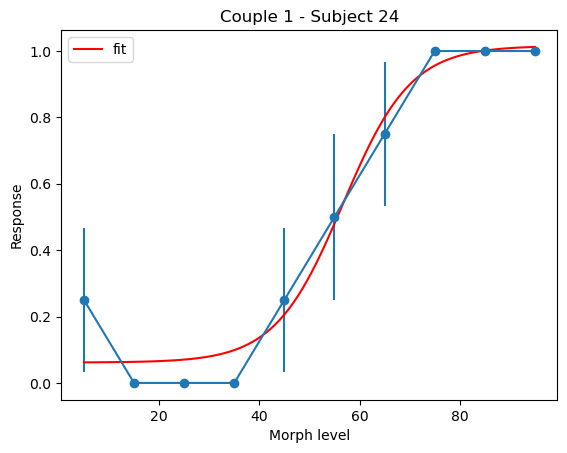

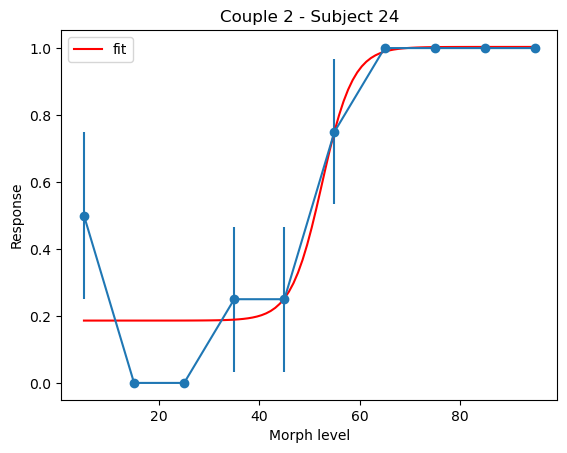

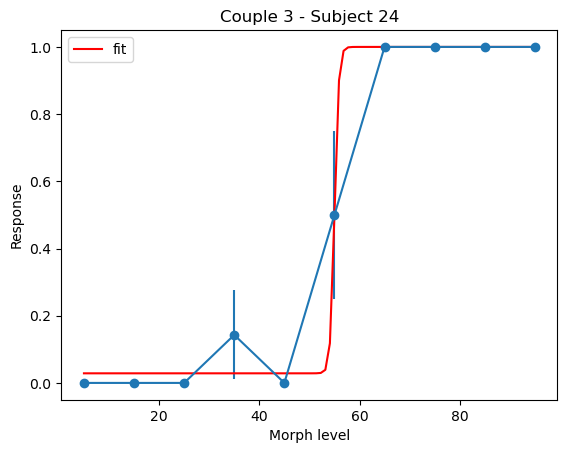

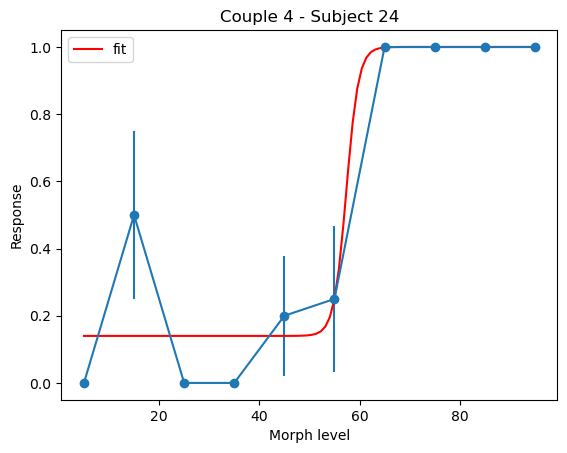

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


Fit failed for Couple 5 - Subject 24


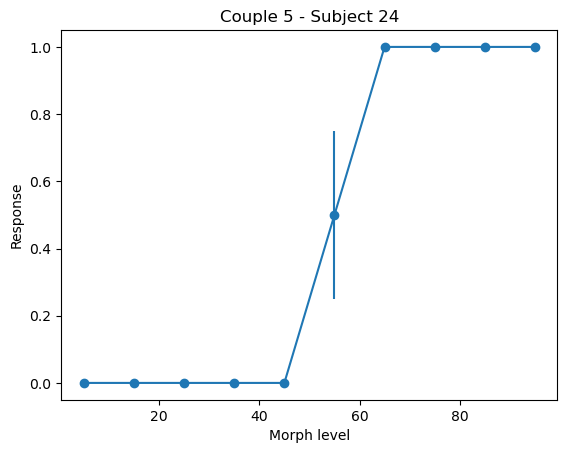

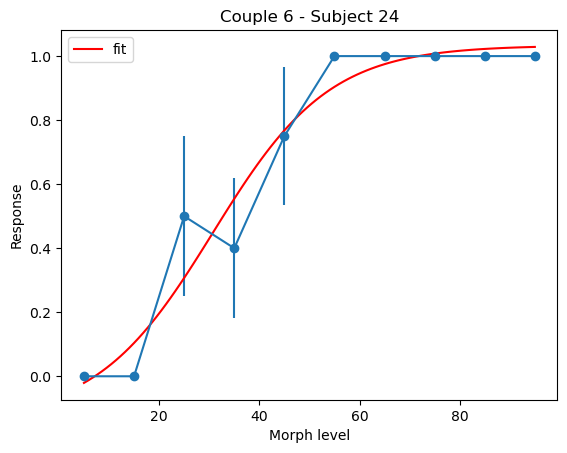

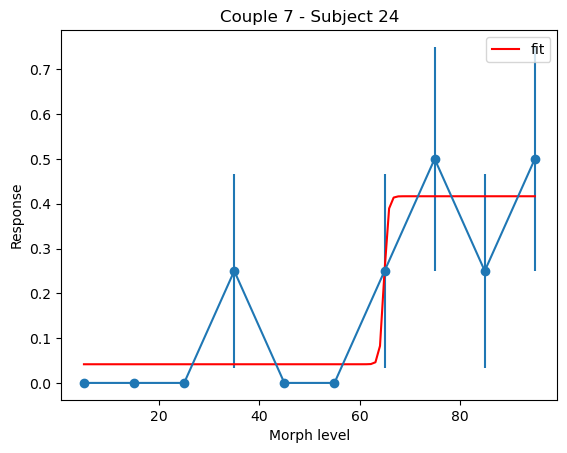

Fit failed for Couple 8 - Subject 24


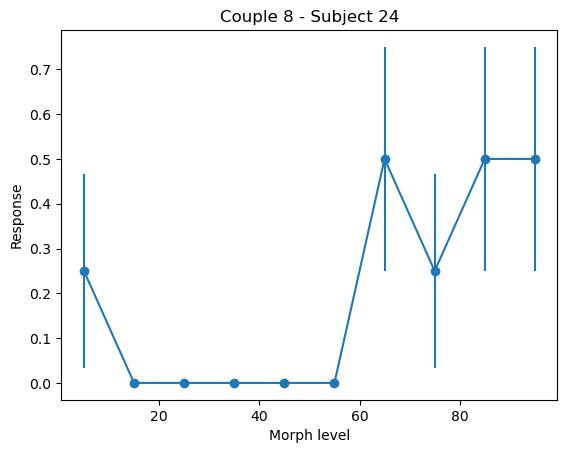

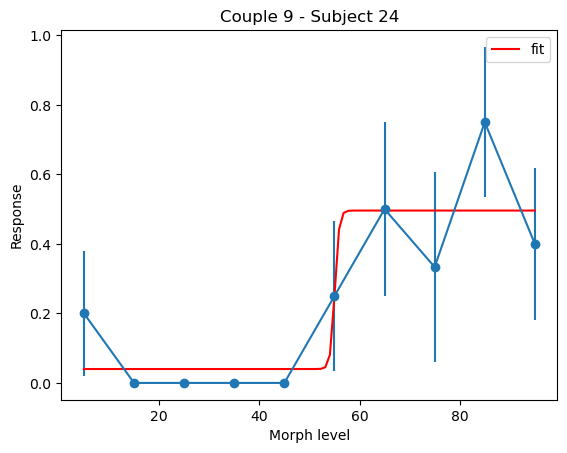

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\2583805287.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


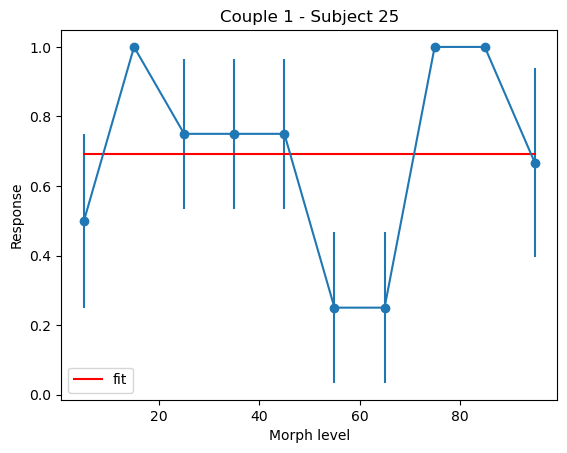

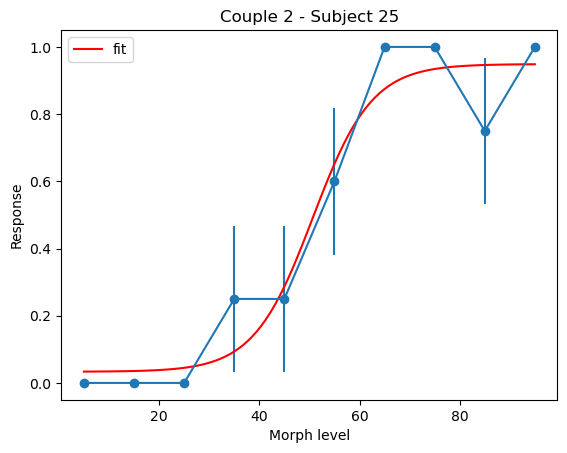

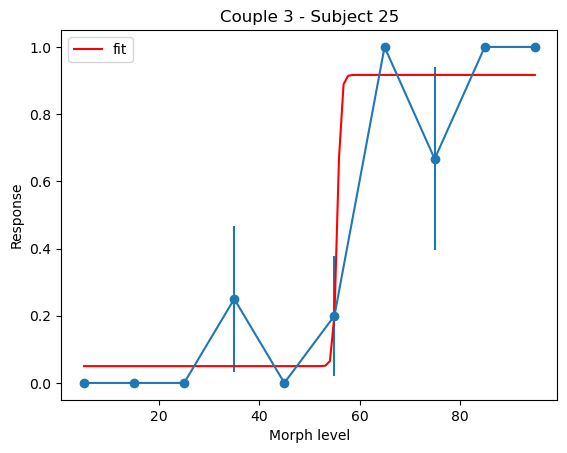

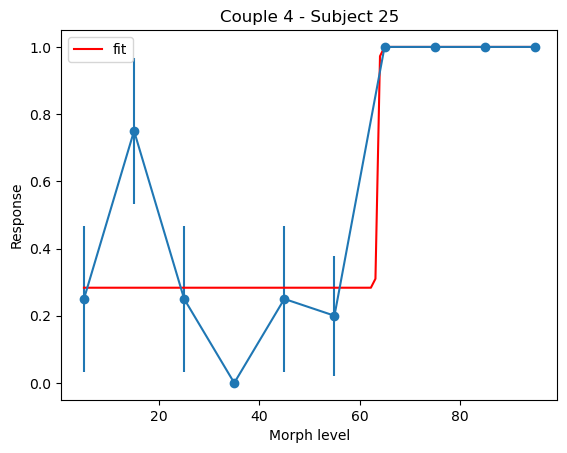

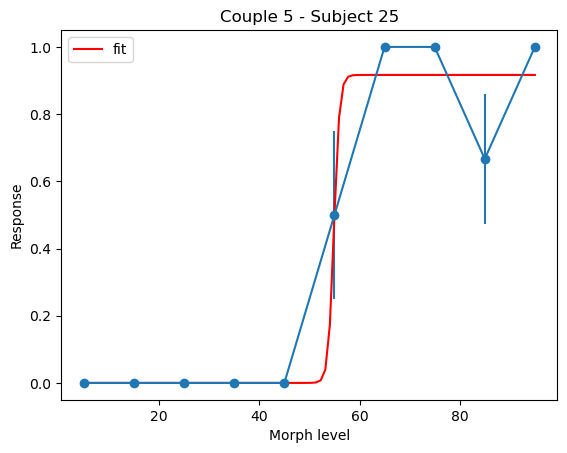

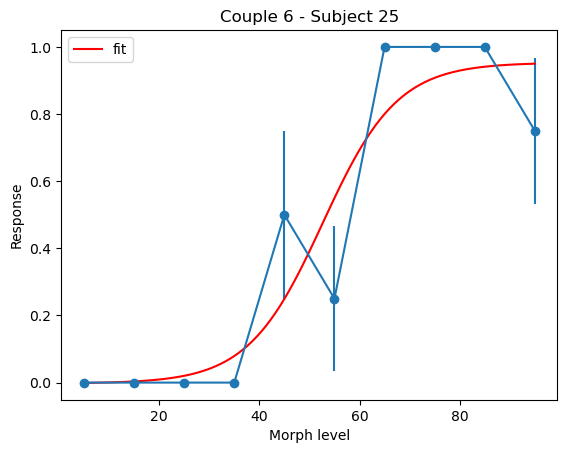

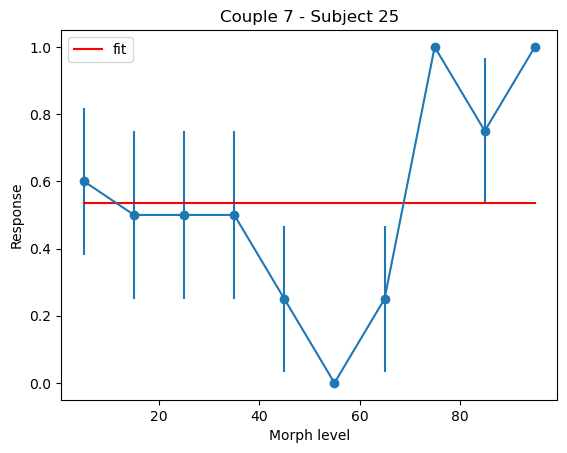

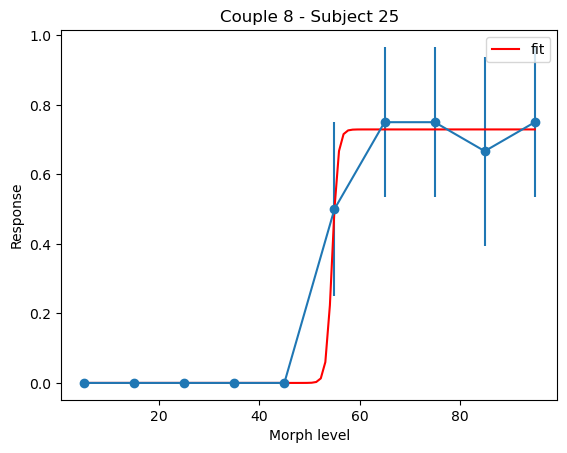

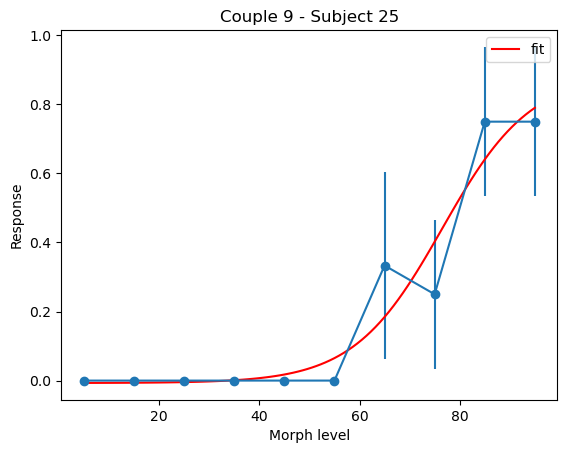

In [80]:
for subject in range(1, 26):
    view_results(subject=subject, run='all', return_data=False, do_plot=True)

In [90]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

def sigmoid(x, L, x0, k, b):
    y = L / (1 + np.exp(-k*(x-x0))) + b
    return y

def view_results(subject=1, run='all', return_data=False, do_plot=True):

    labels = pd.read_csv(f'labels/labels_{subject}.csv')

    if run == 'all':
        x = labels['morph level']
        y = labels['response']
        z = labels['response time']
        t = labels['couple']
    elif run in range(1, 5):
        mask = labels['run'] == run
        x = labels[mask]['morph level']
        y = labels[mask]['response']
        z = labels[mask]['response time']
        t = labels[mask]['couple']

    # Plot graph for each couple
    for couple in range(1, 10):
        mask_couple = (t == couple)
        x_couple = x[mask_couple]
        y_couple = y[mask_couple]

        # Calculate means and standard errors
        values, counts = np.unique(x_couple, return_counts=True)
        response_mean = np.zeros(len(values))
        response_std = np.zeros(len(values))
        for count, v in enumerate(values):
            mask = (x_couple == v)
            response_mean[count] = np.nan_to_num(np.mean(y_couple[mask]))
            response_std[count] = np.nan_to_num(np.std(y_couple[mask]) / np.sqrt(np.sum(mask)))

        # Ajuster la fonction sigmoïdale aux données
        try:
            p0 = [max(response_mean), np.median(values), 1, min(response_mean)]
            popt, pcov = curve_fit(sigmoid, values, response_mean, p0)

            # Calculer la différence entre le point maximum et le point minimum
            max_value = sigmoid(values, *popt).max()
            min_value = sigmoid(values, *popt).min()
            diff_percentage = (max_value - min_value) / max_value * 100

            # Vérifier les critères de filtrage
            if popt[2] > 0 and diff_percentage > 20:
                # Tracer les données et la courbe ajustée
                plt.figure()
                plt.errorbar(values, response_mean, yerr=response_std, fmt='-o')
                plt.xlabel('Morph level')
                plt.ylabel('Response')
                plt.title(f'Couple {couple} - Subject {subject}')  # Ajout du titre avec le numéro de sujet

                x_fit = np.linspace(min(values), max(values), 100)
                y_fit = sigmoid(x_fit, *popt)

                plt.plot(x_fit, y_fit, 'r-', label='fit')
                plt.legend()

                if do_plot:
                    plt.show()

                if return_data:
                    data = {
                        'couple': couple,
                        'x': values,
                        'y': response_mean,
                        'y_fit': sigmoid(values, *popt)
                    }
                    return data
        except RuntimeError:
            print(f"Fit failed for Couple {couple} - Subject {subject}")

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


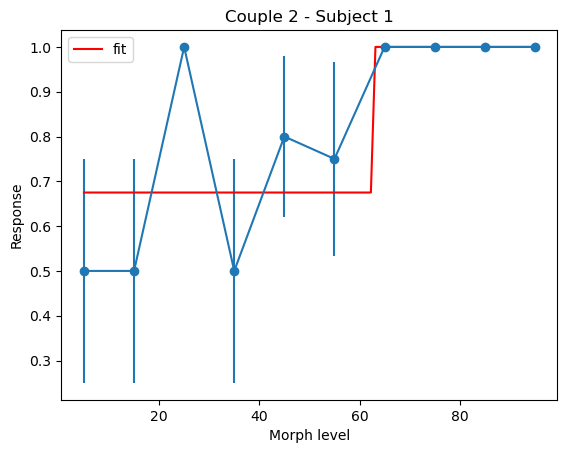

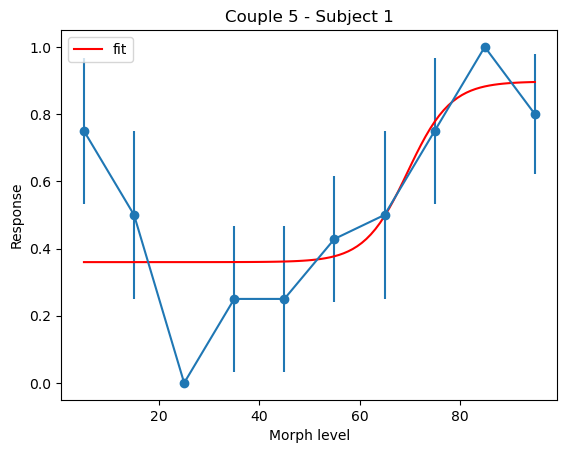

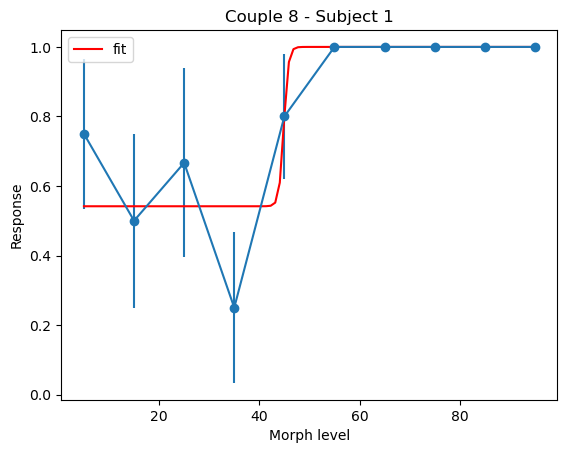

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


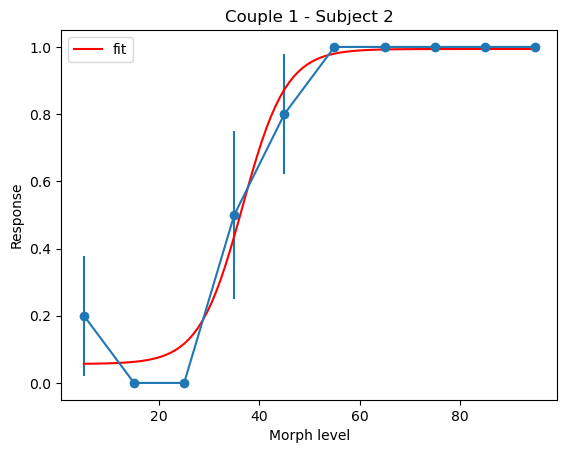

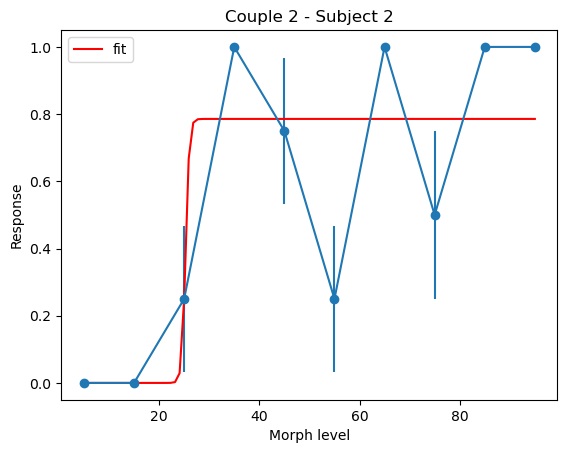

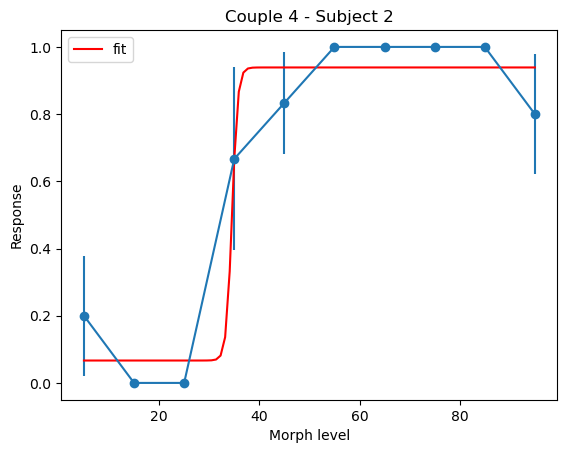

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


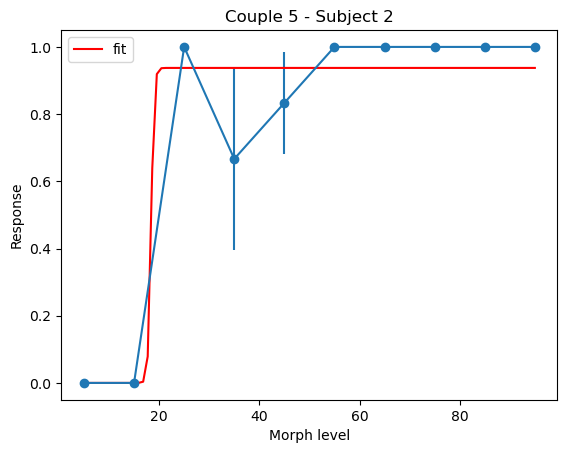

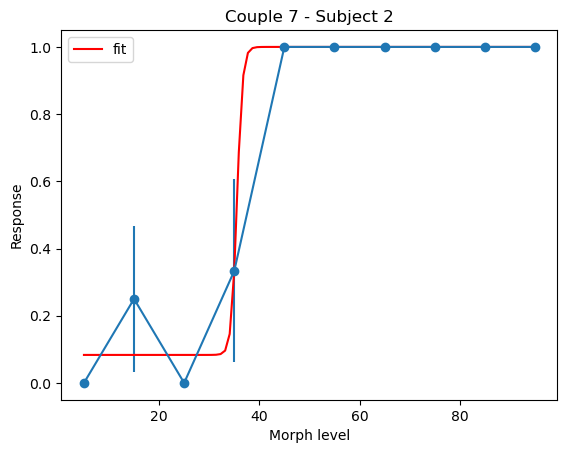

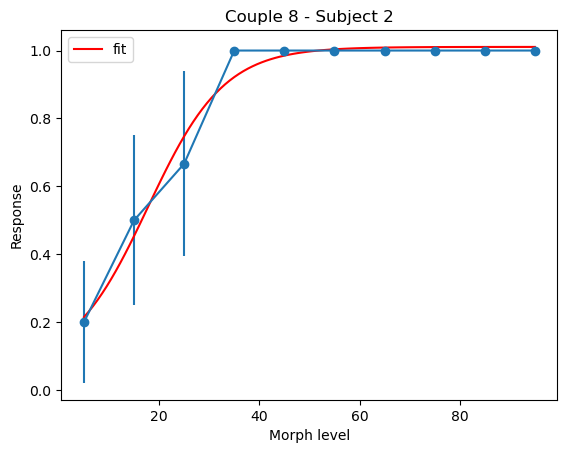

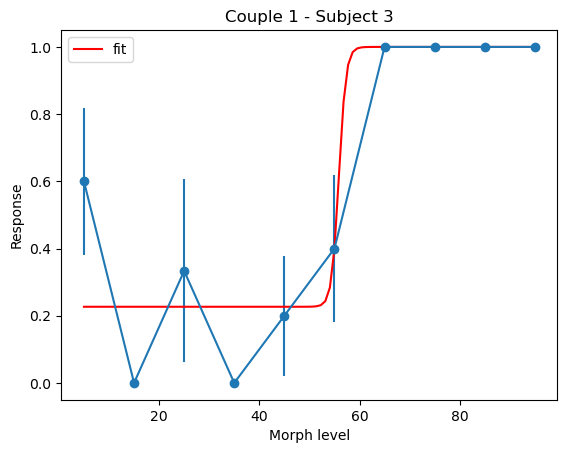

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


Fit failed for Couple 3 - Subject 3


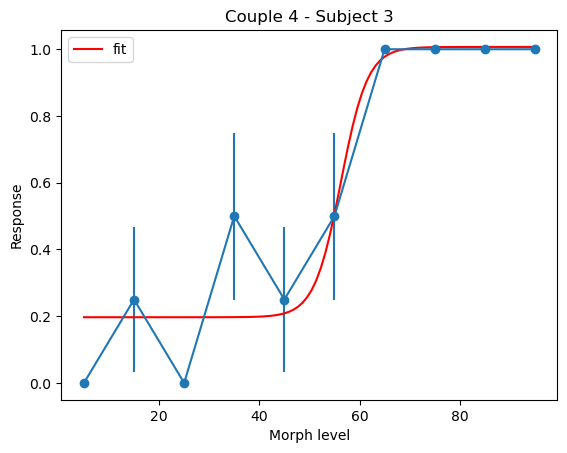

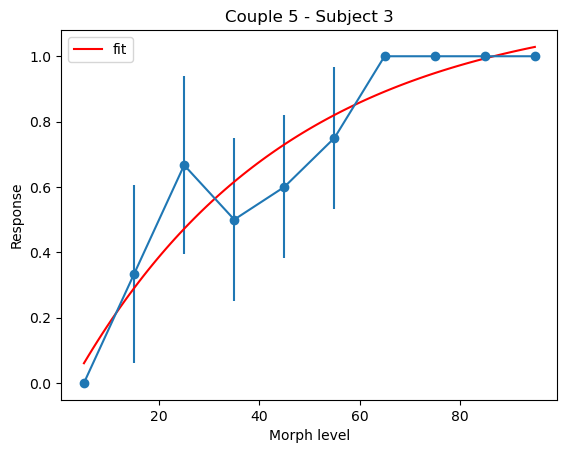

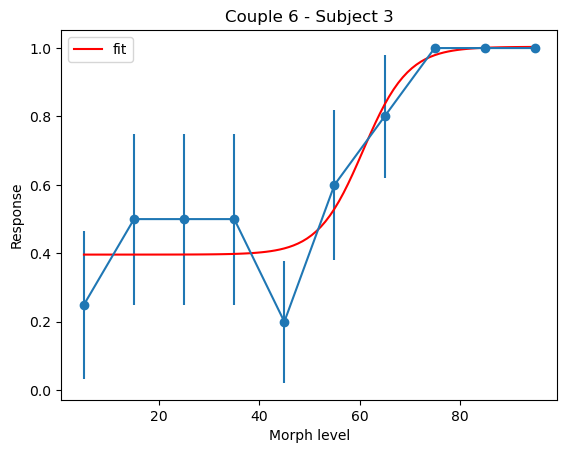

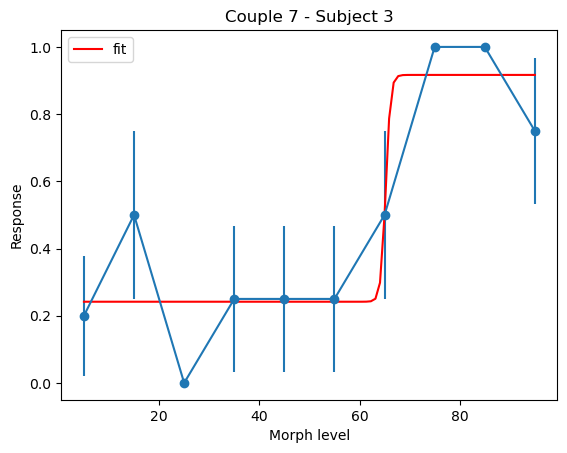

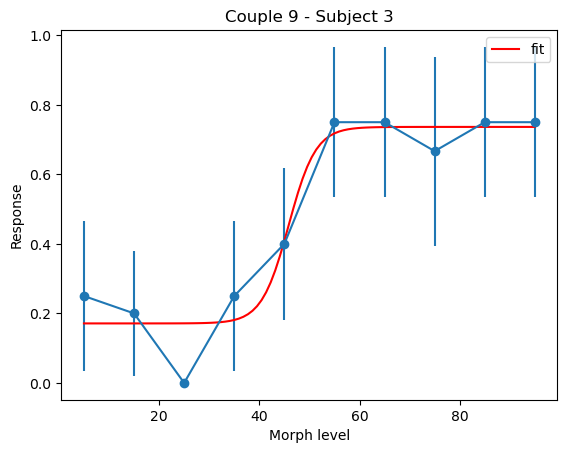

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


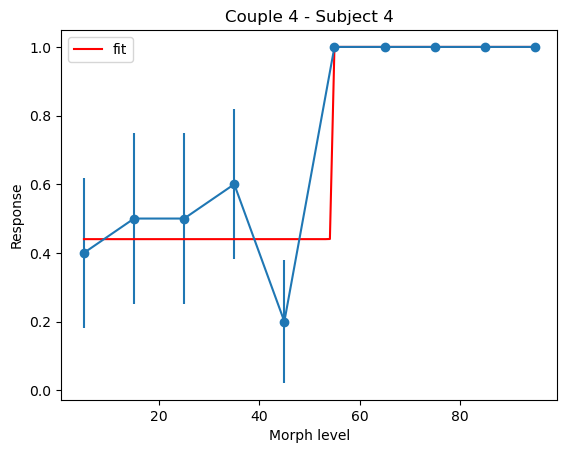

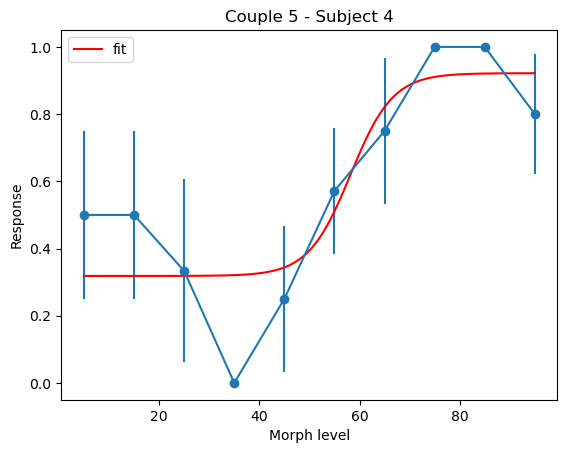

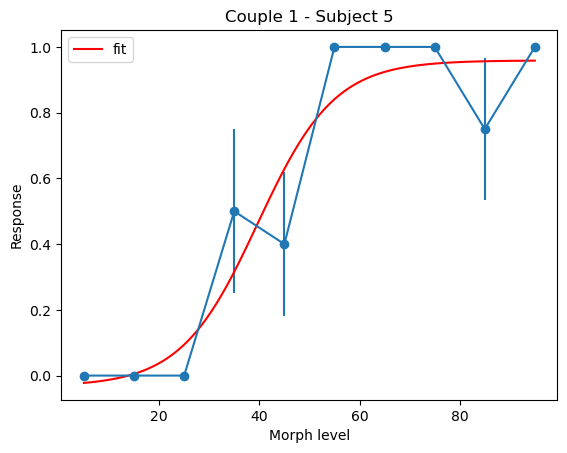

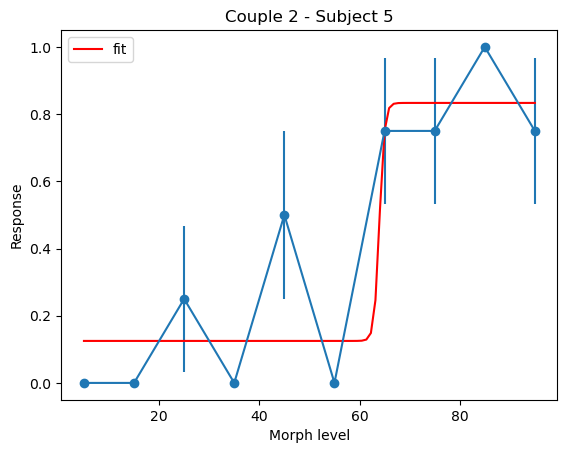

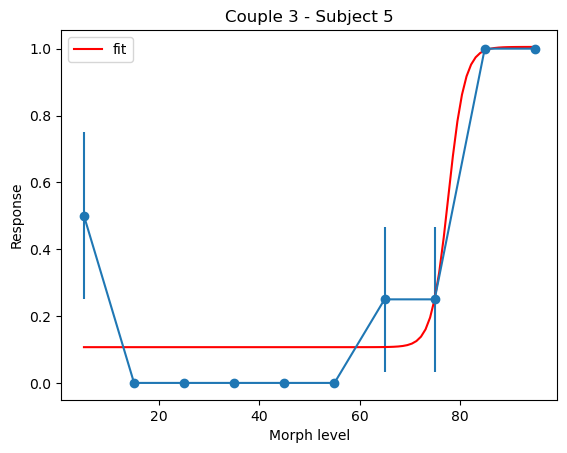

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


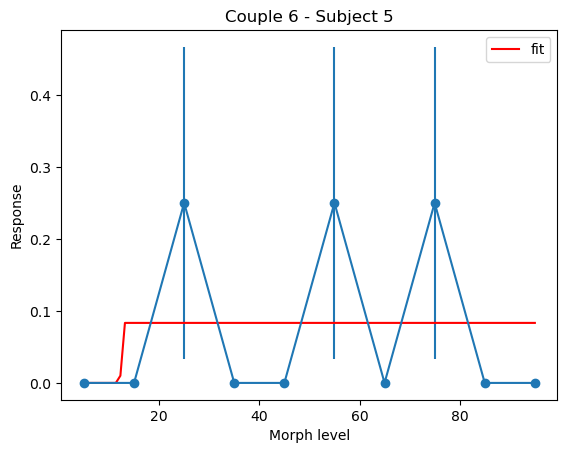

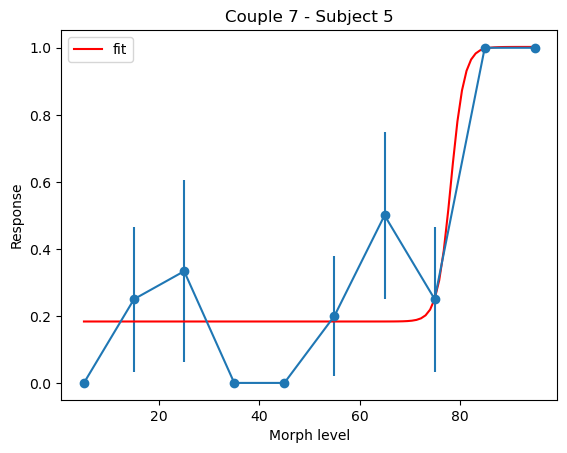

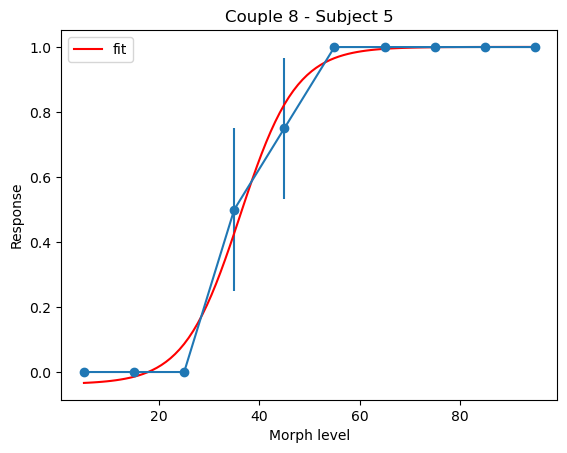

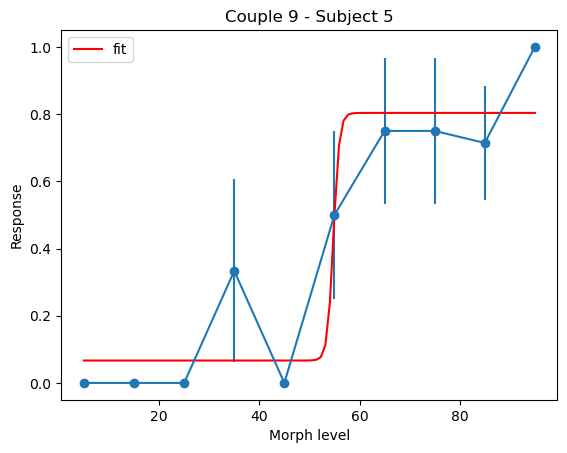

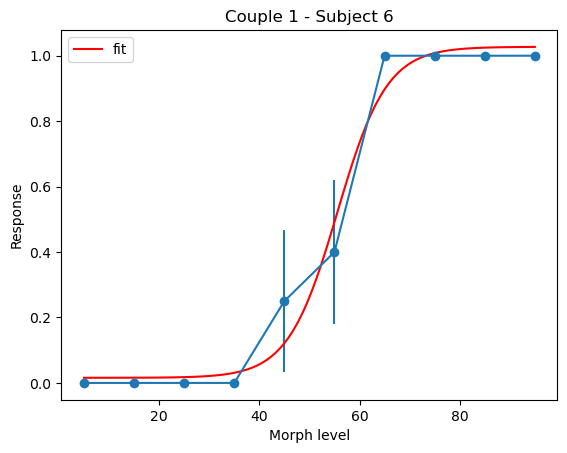

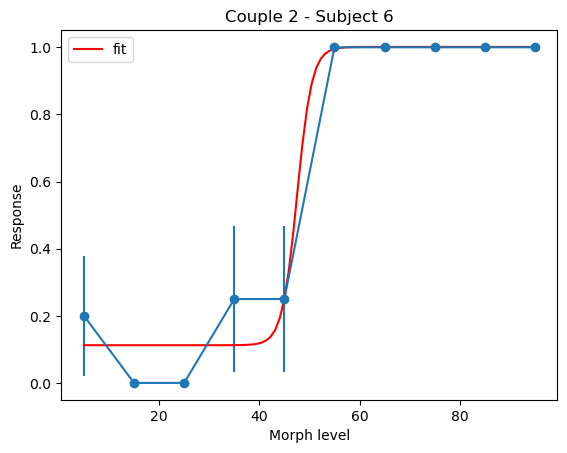

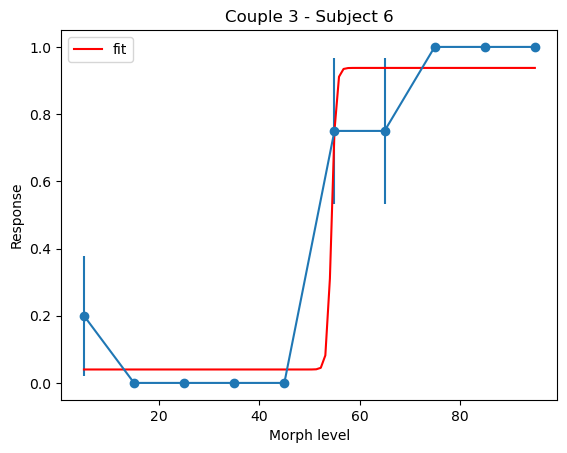

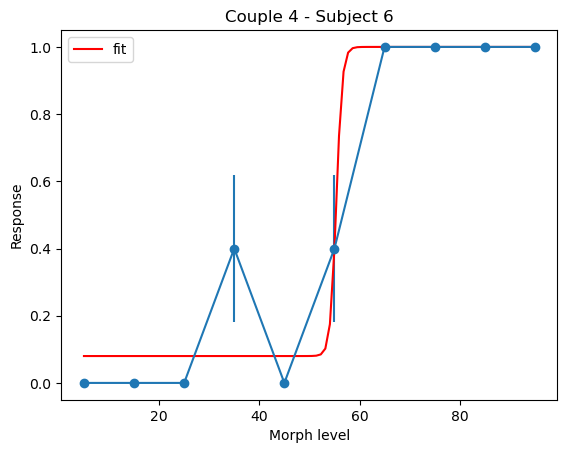

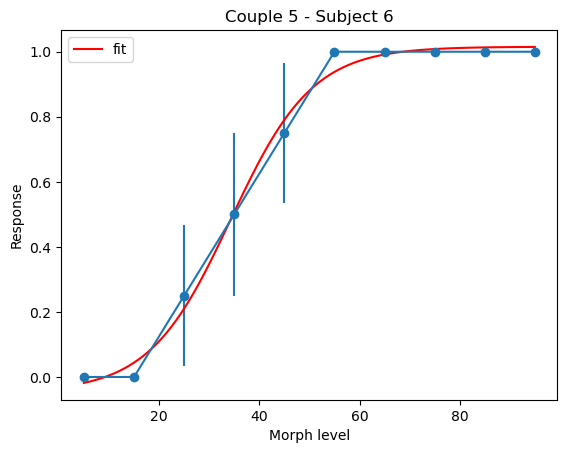

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


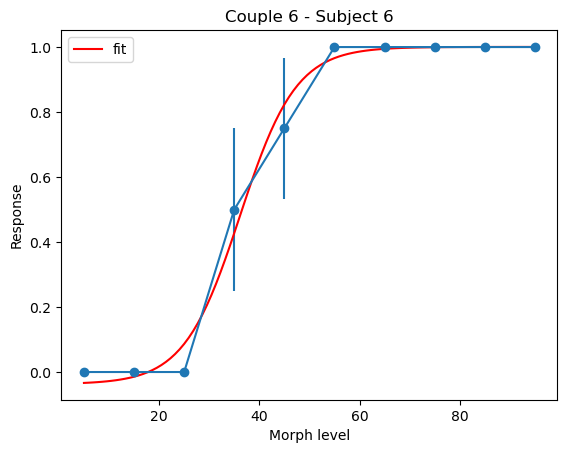

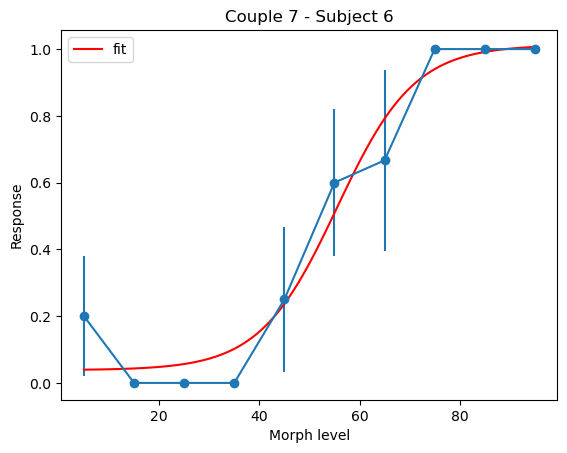

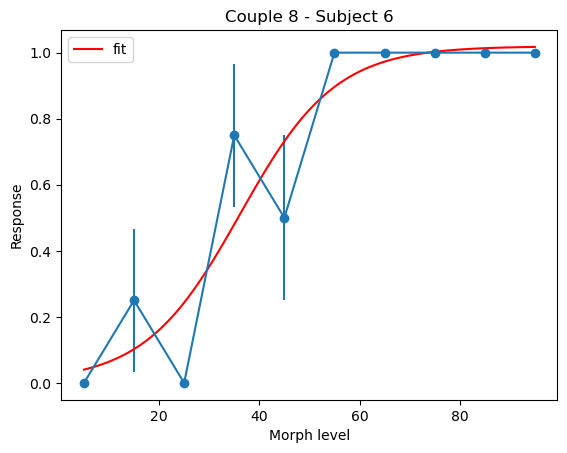

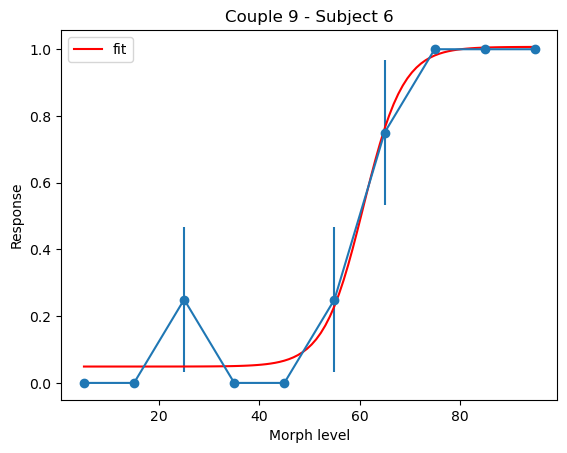

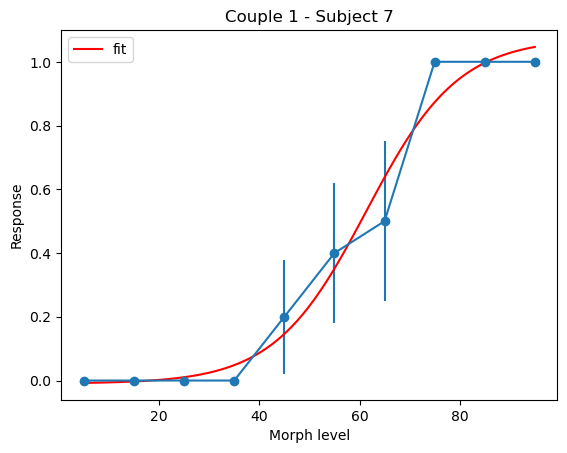

...

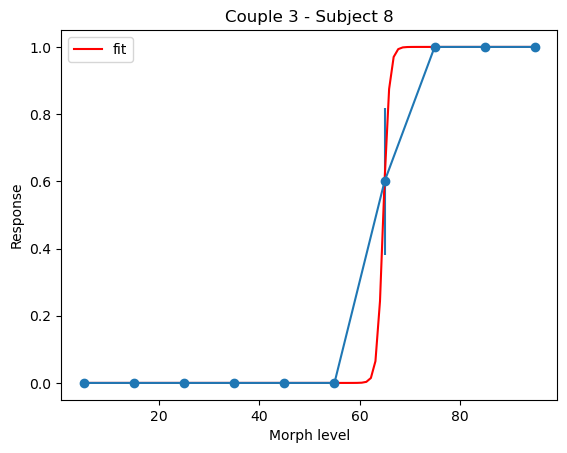

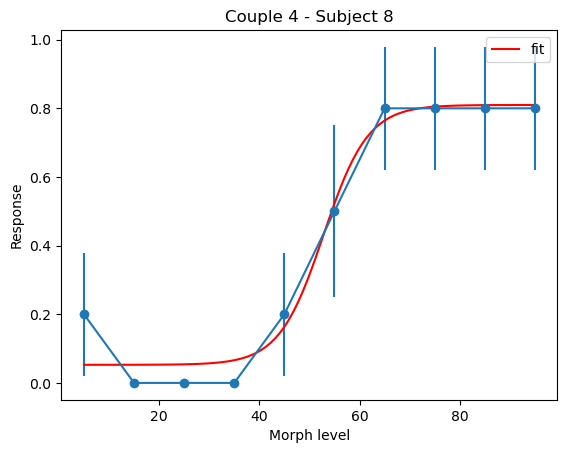

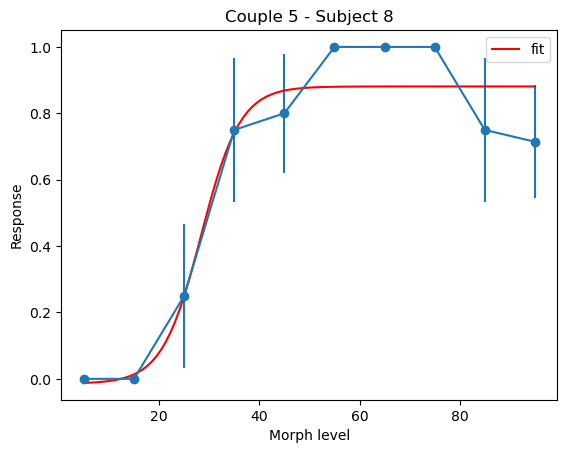

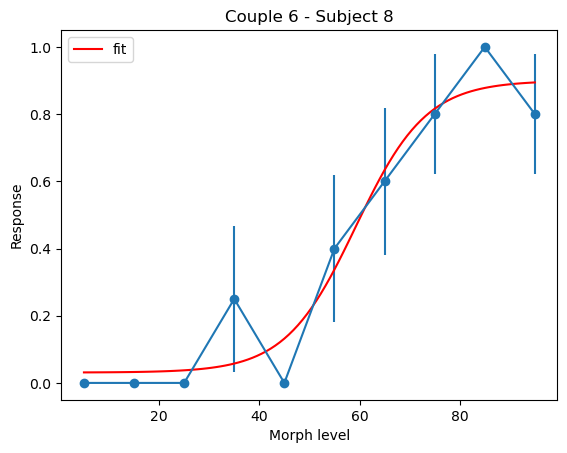

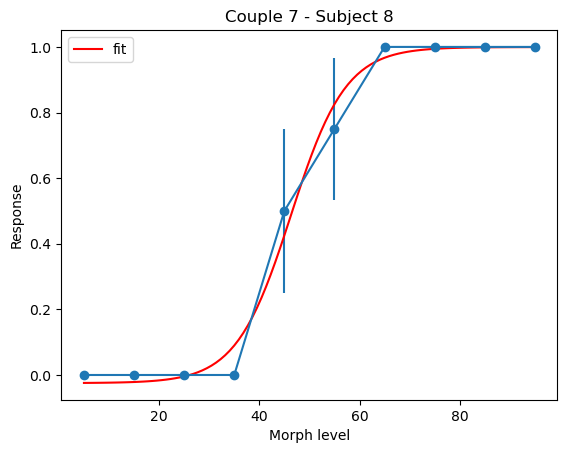

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


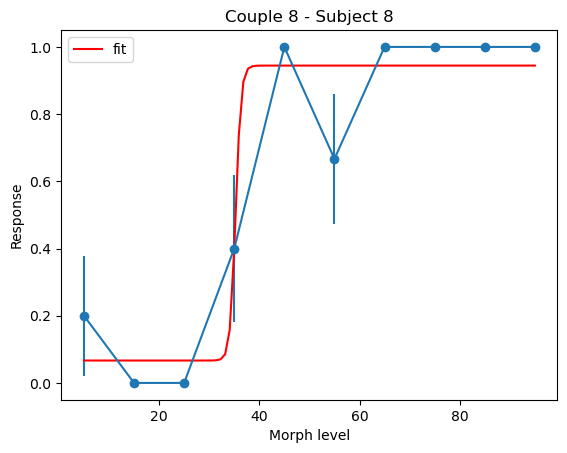

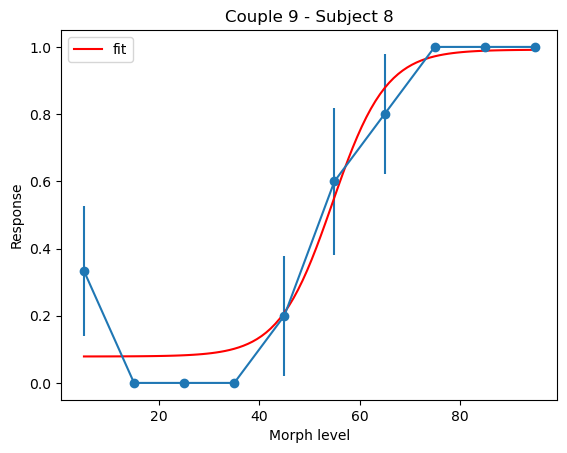

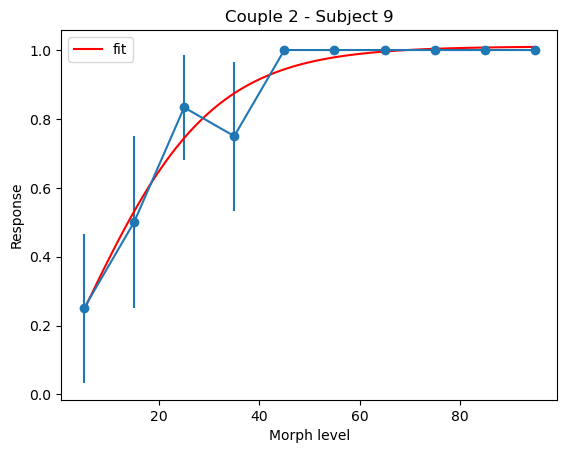

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


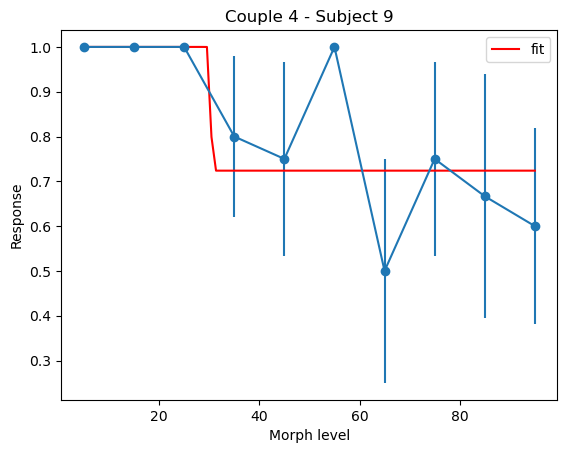

Fit failed for Couple 6 - Subject 9


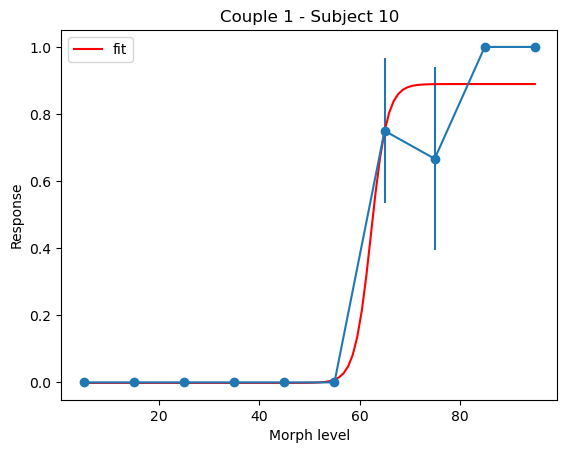

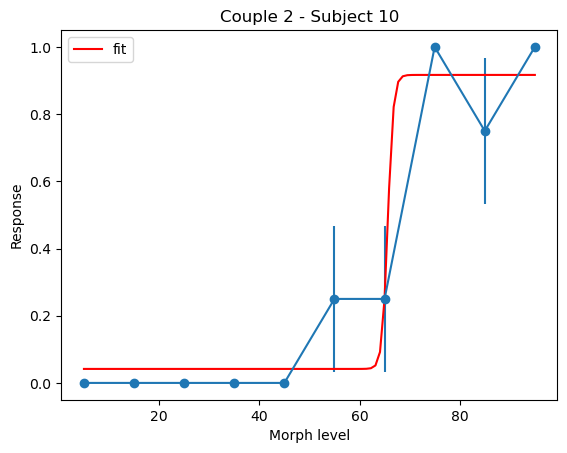

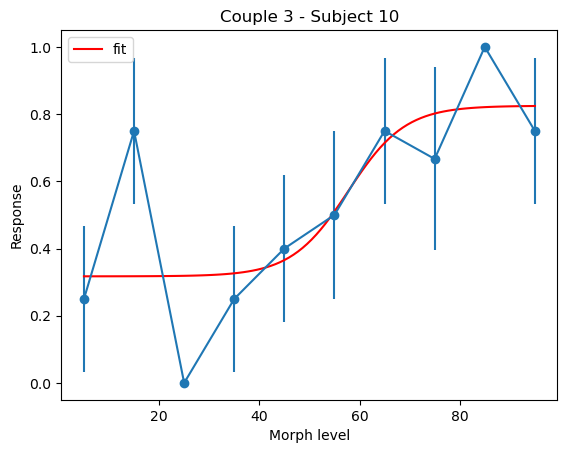

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


Fit failed for Couple 4 - Subject 10


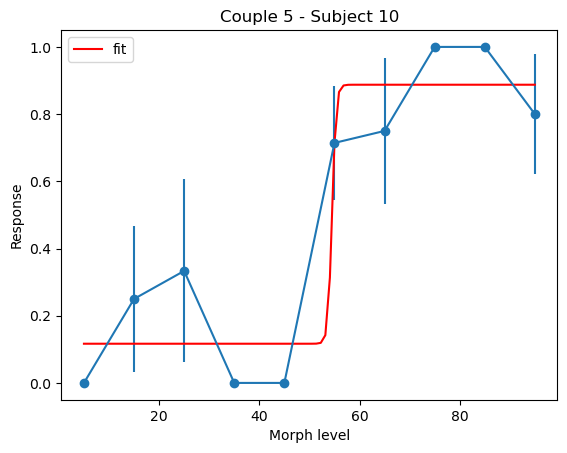

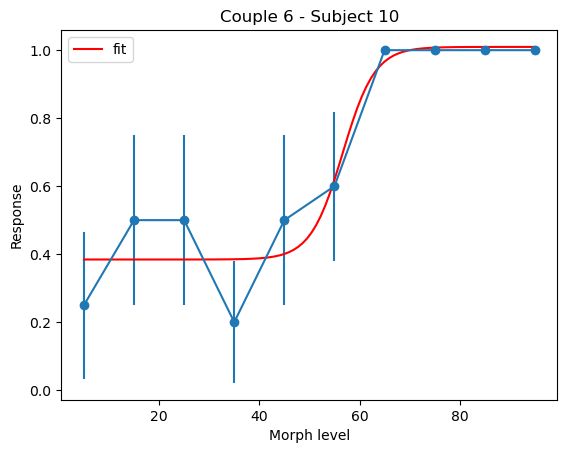

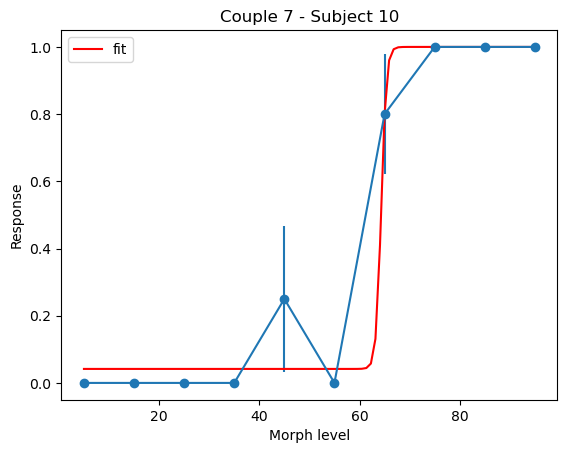

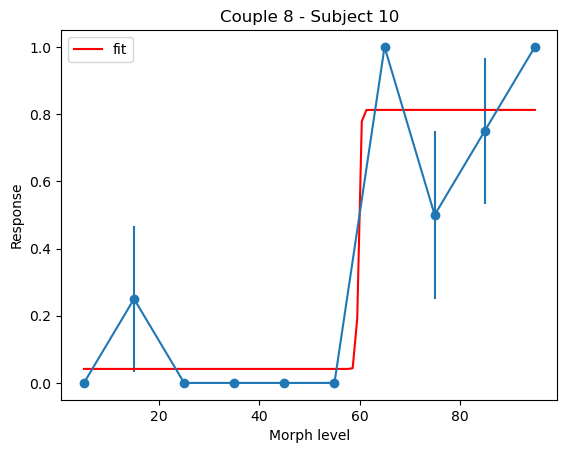

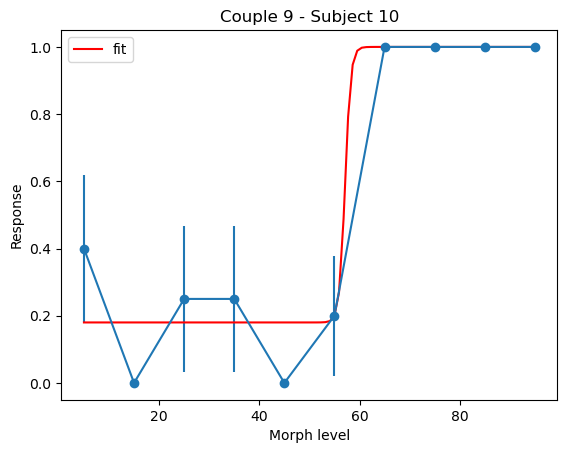

...

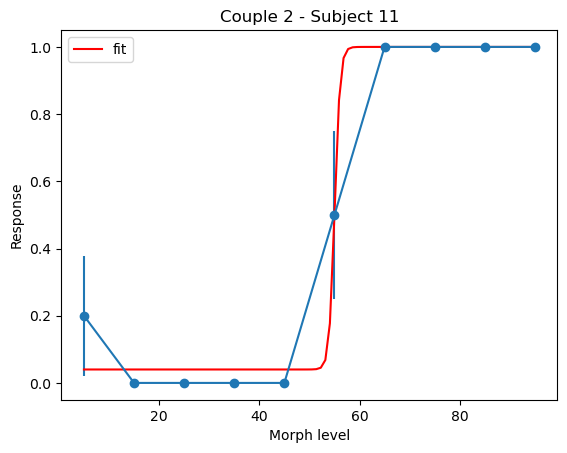

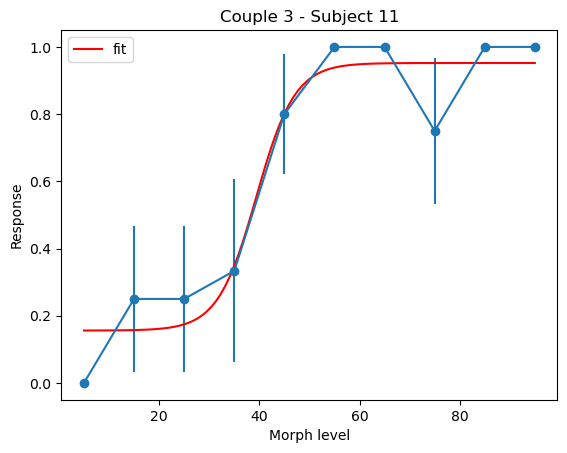

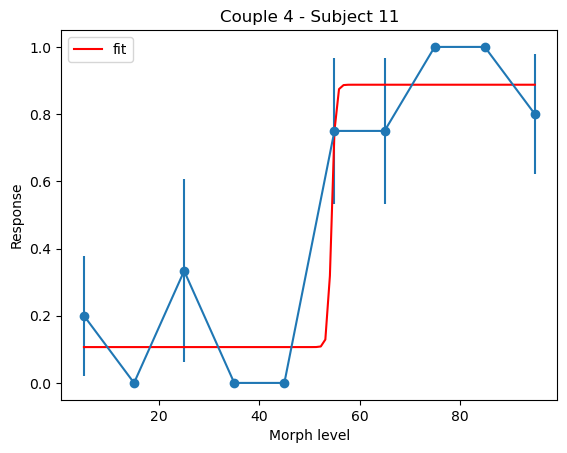

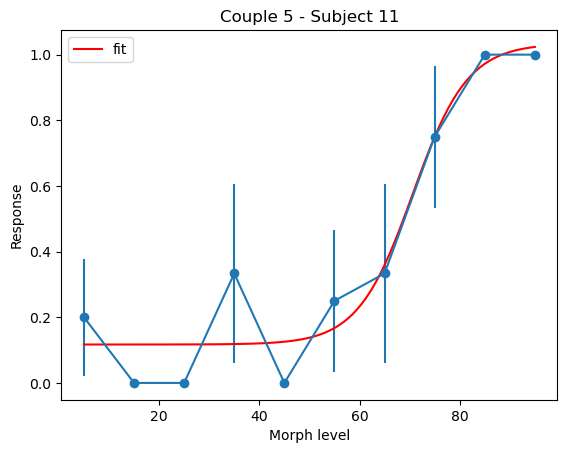

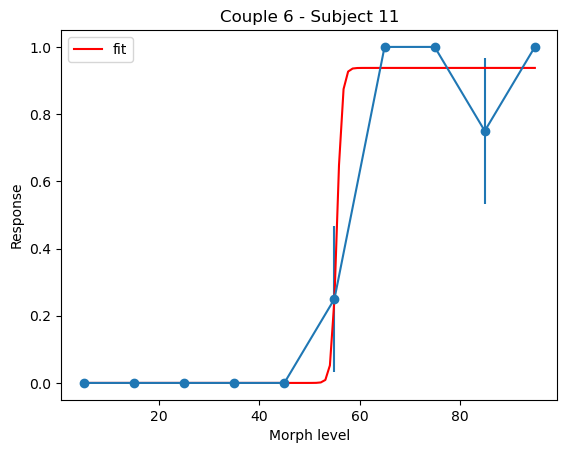

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


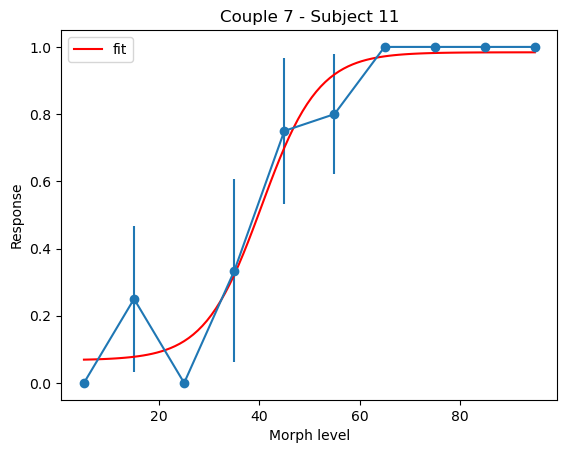

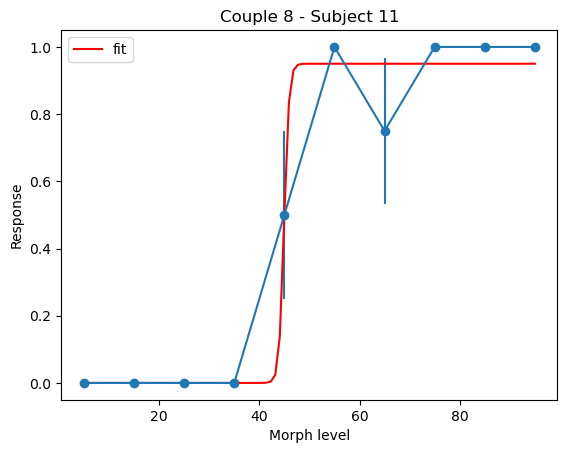

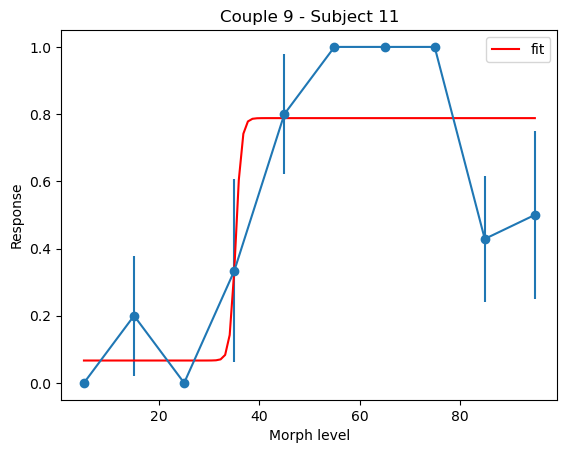

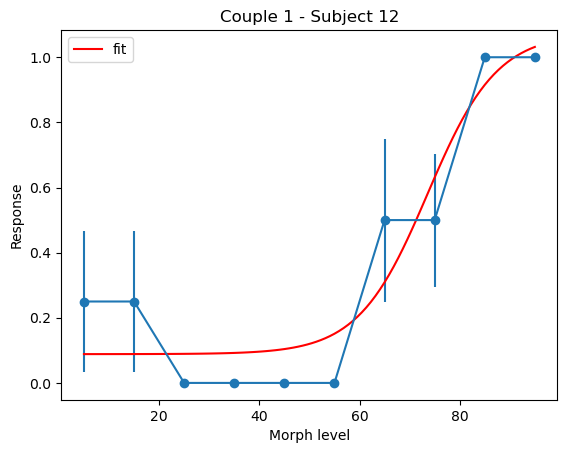

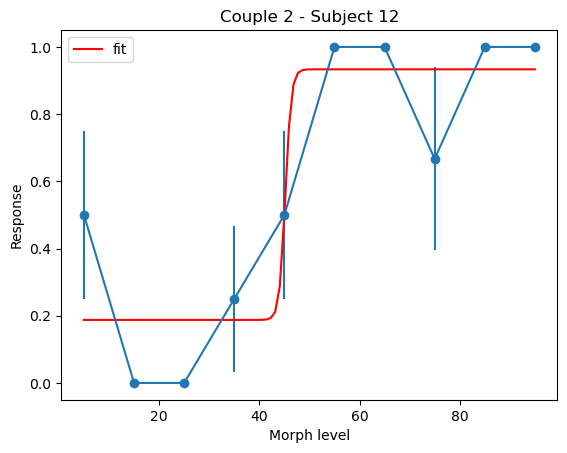

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


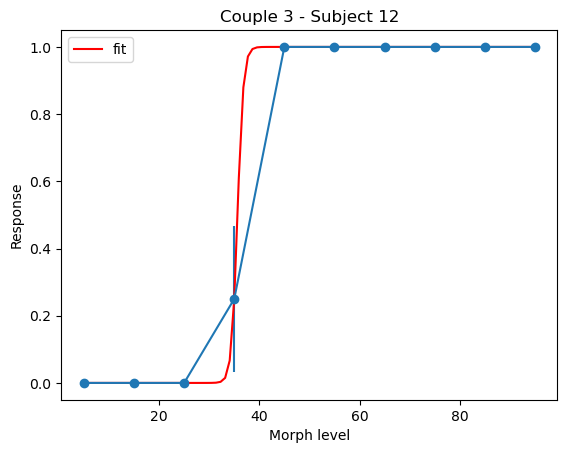

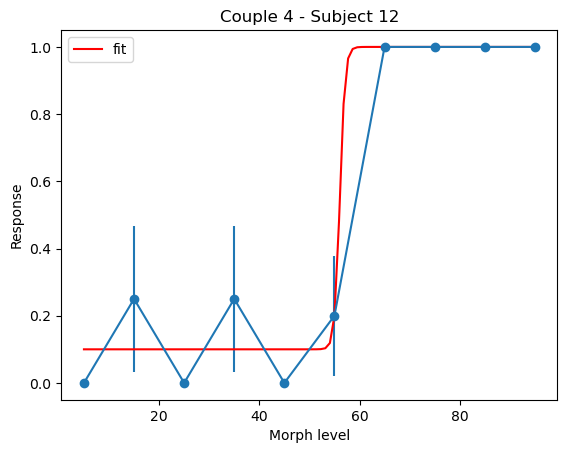

Fit failed for Couple 5 - Subject 12


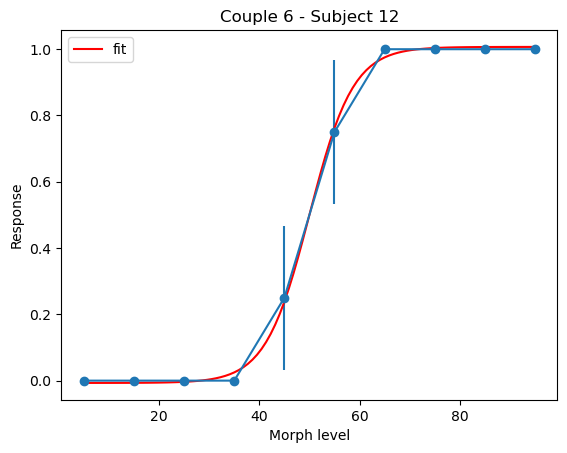

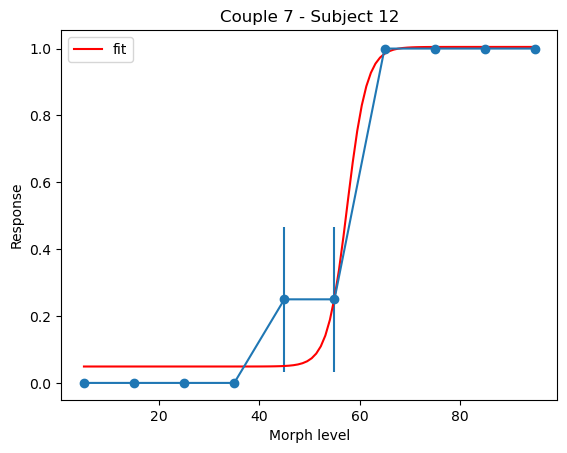

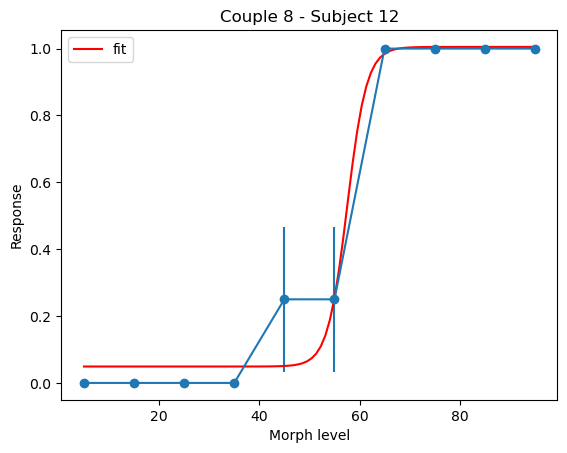

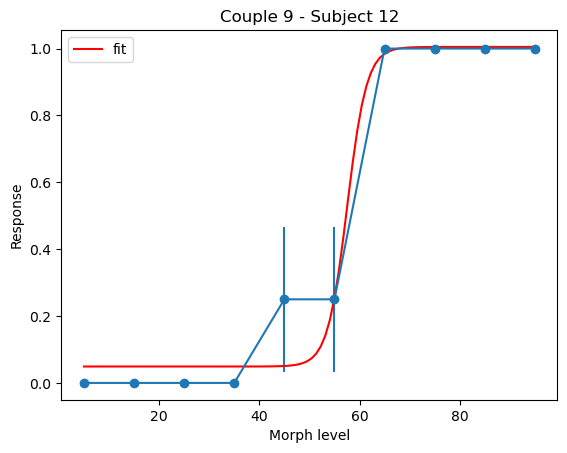

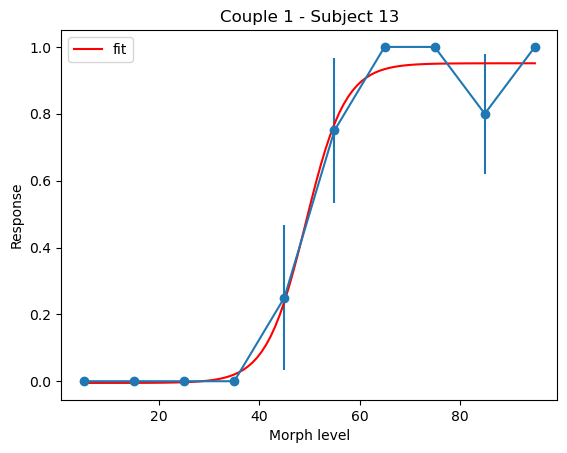

...

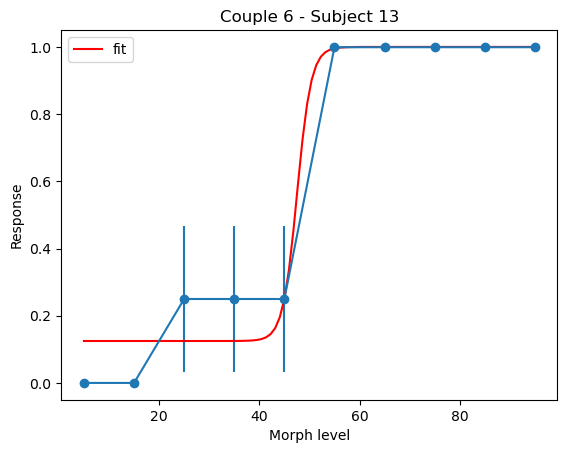

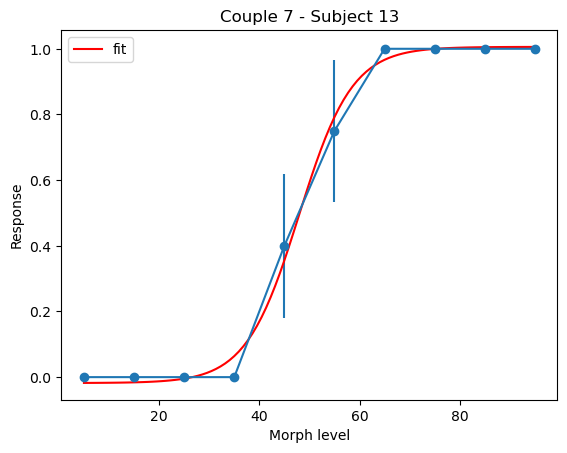

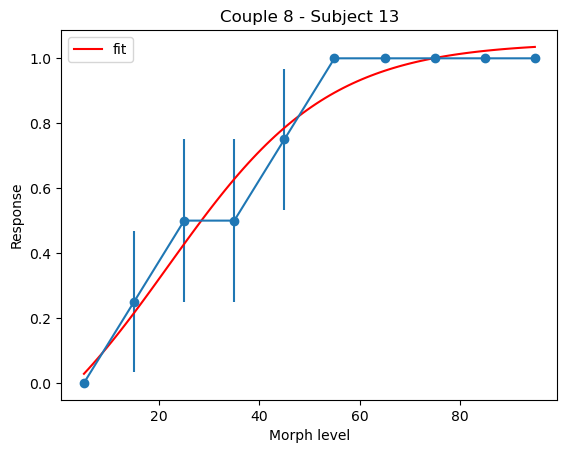

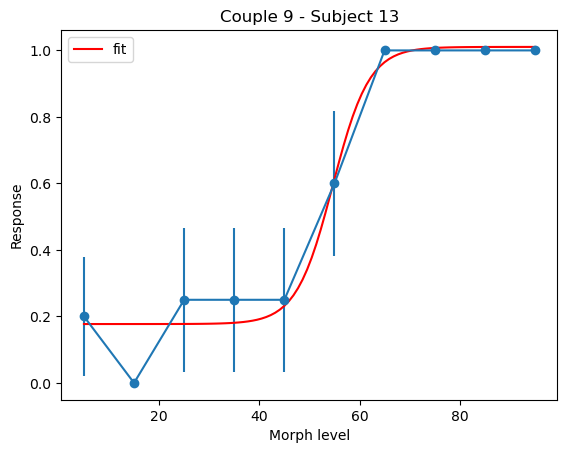

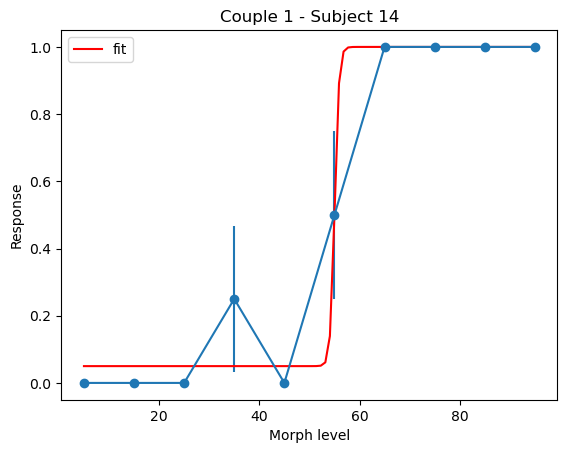

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


Fit failed for Couple 2 - Subject 14


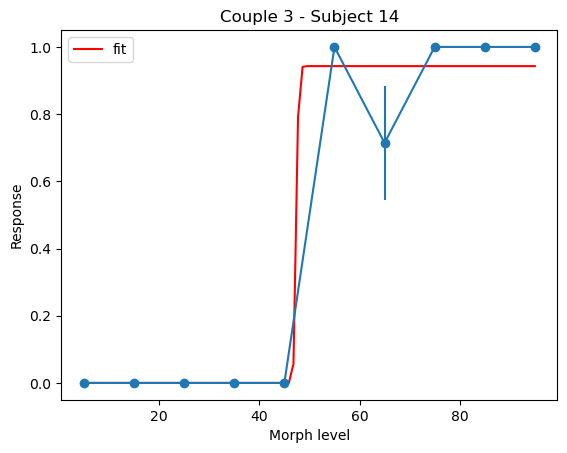

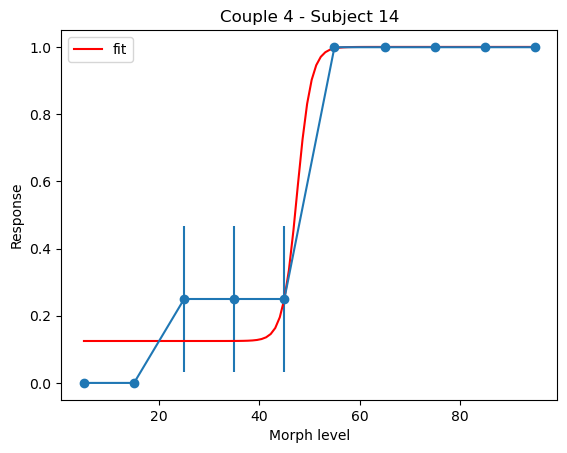

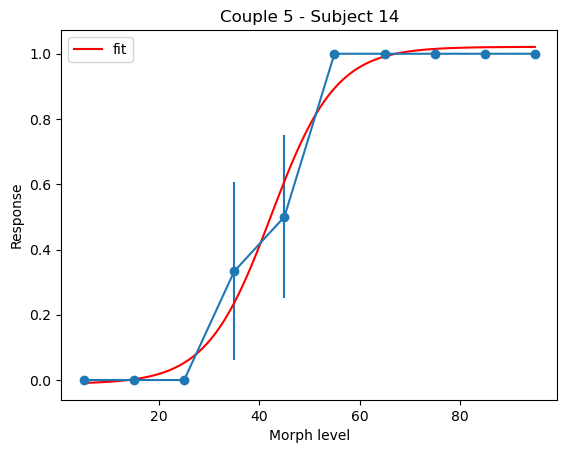

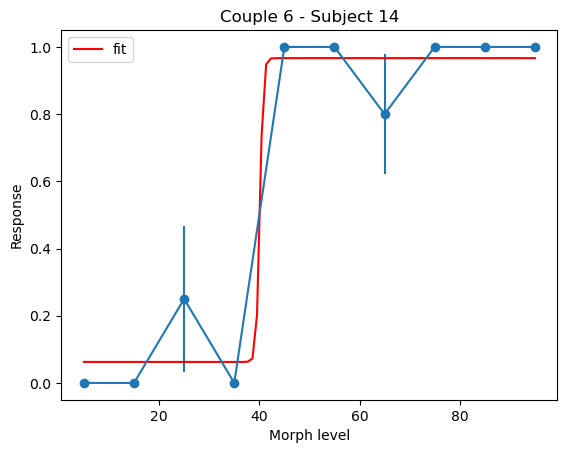

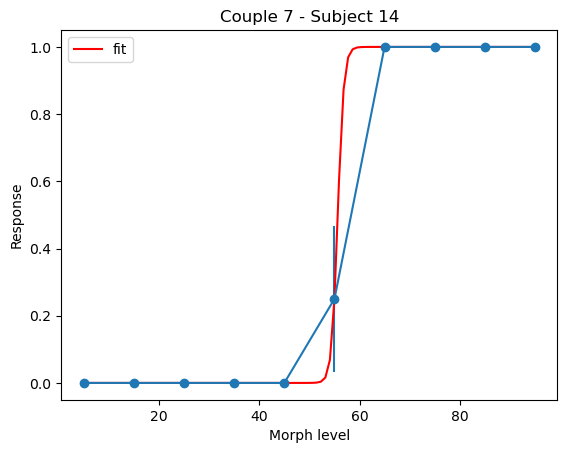

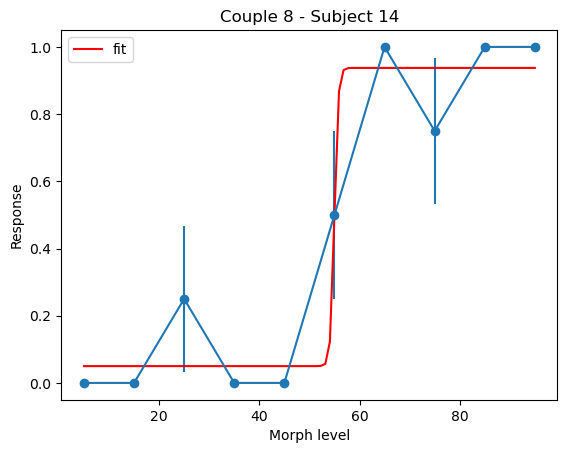

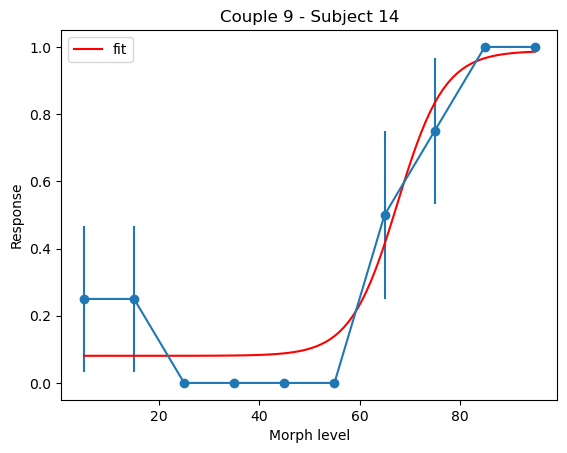

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


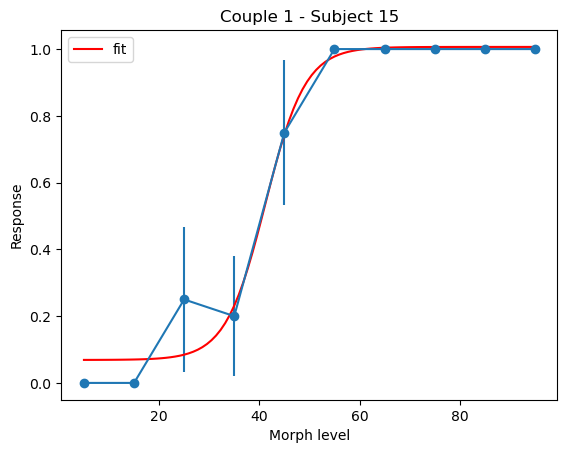

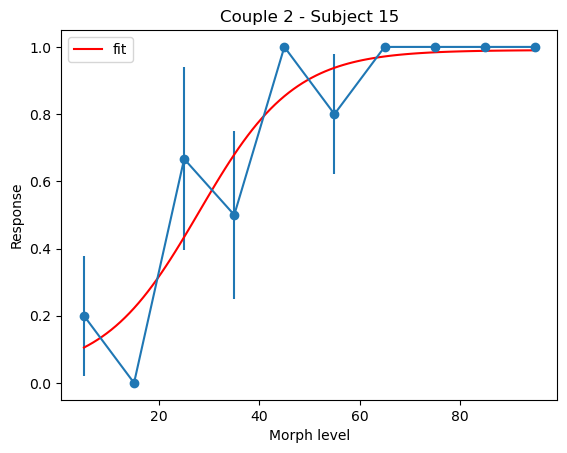

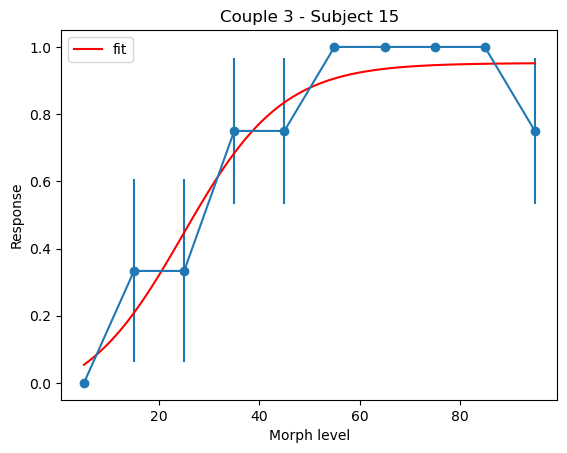

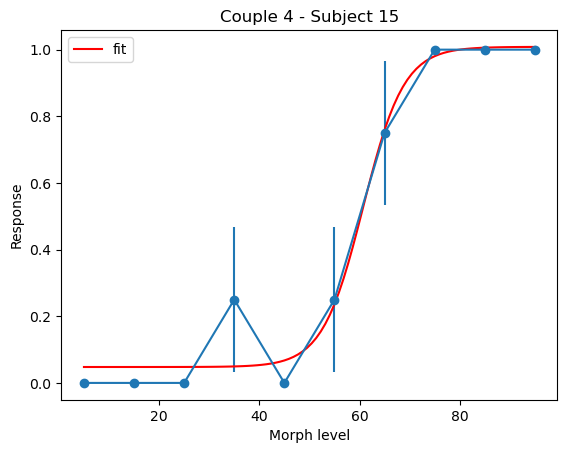

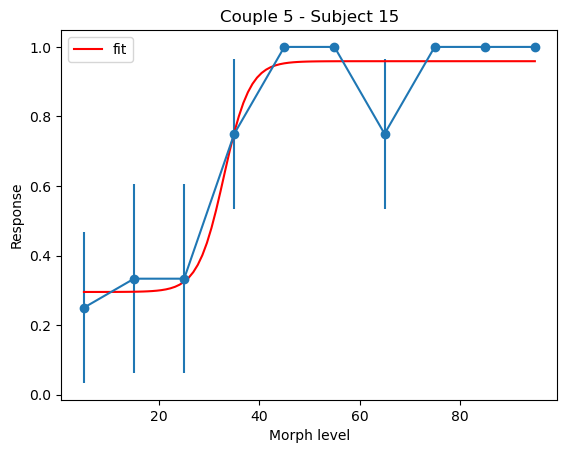

...

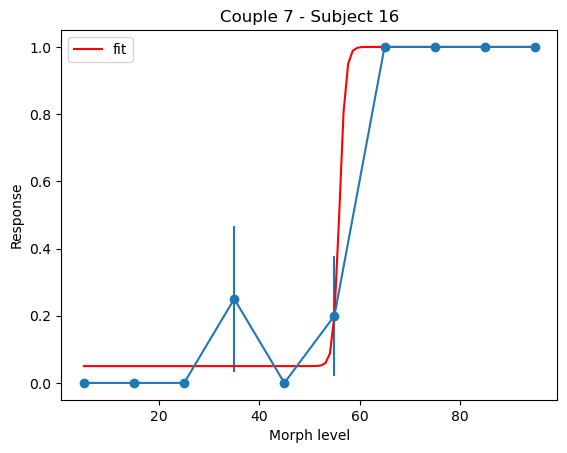

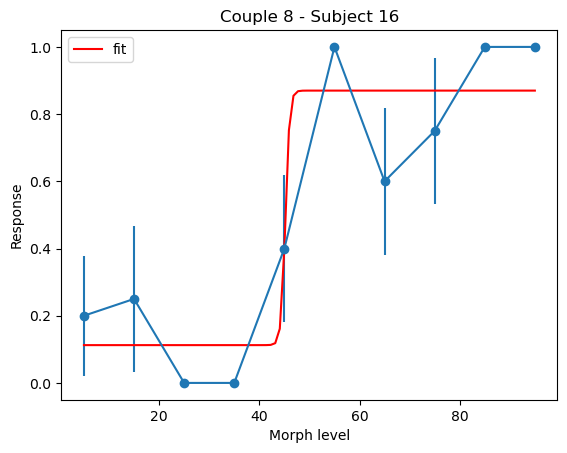

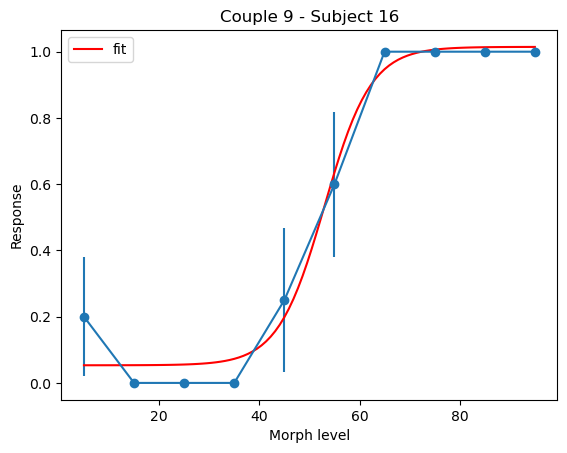

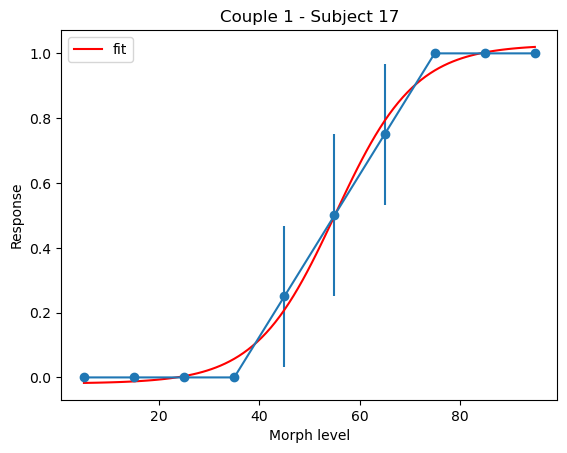

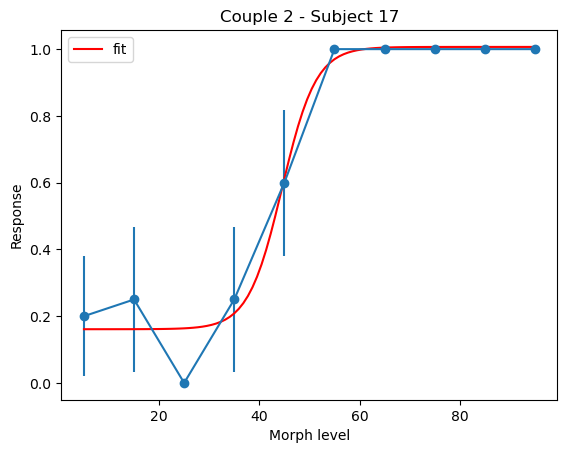

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


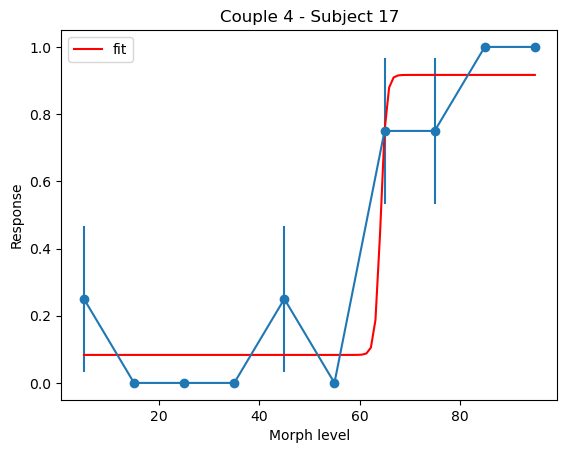

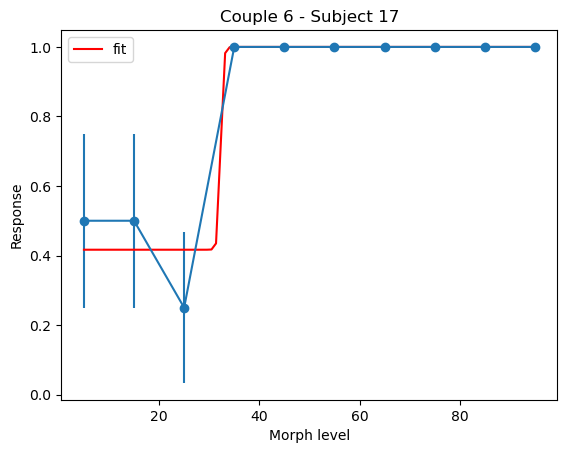

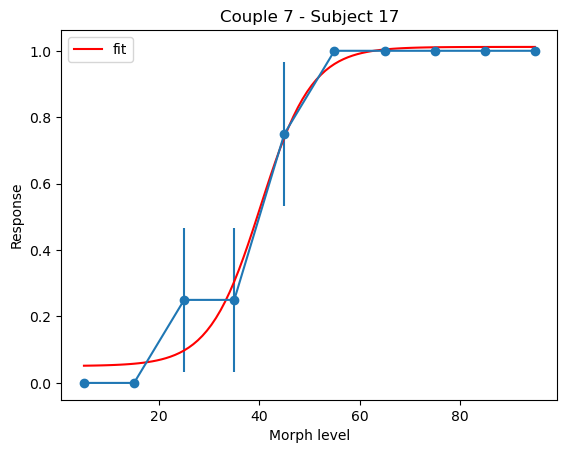

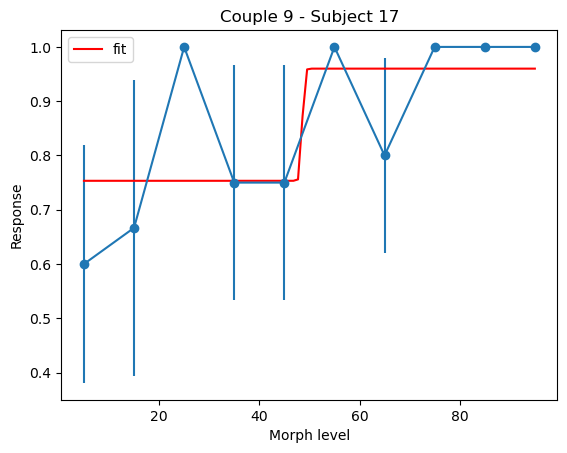

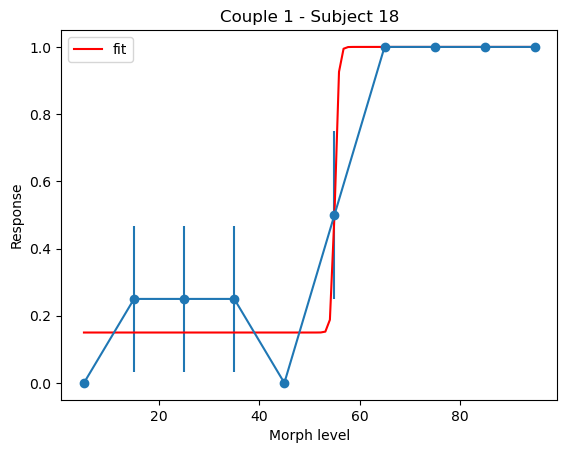

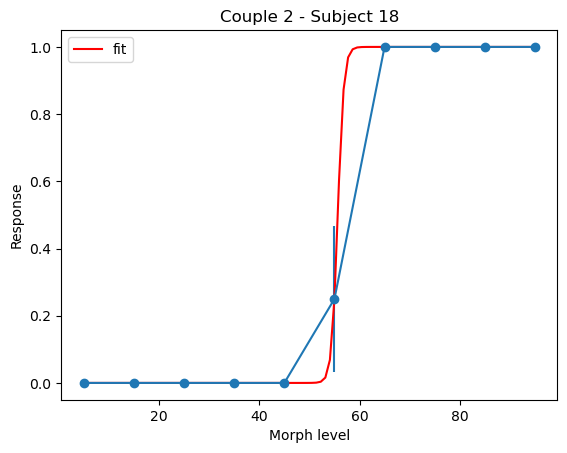

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


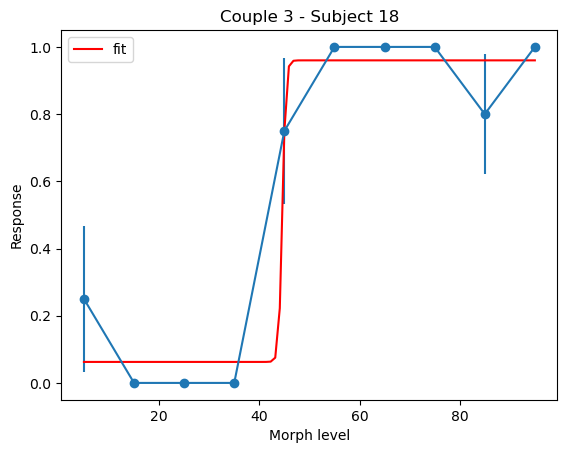

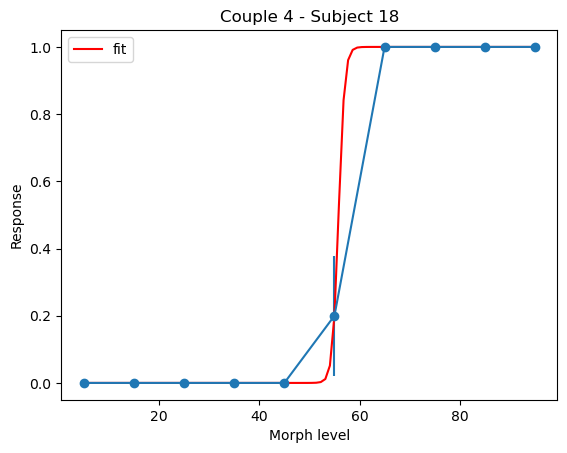

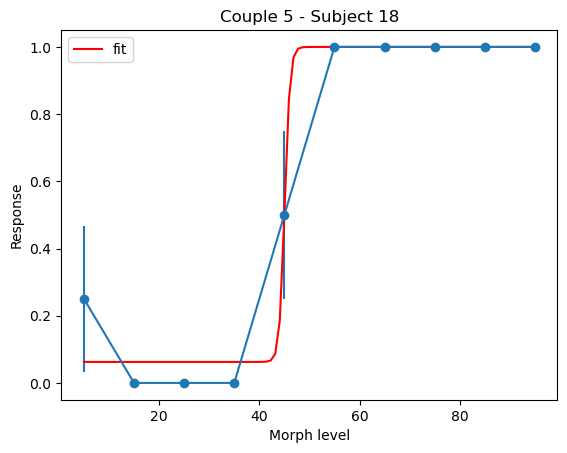

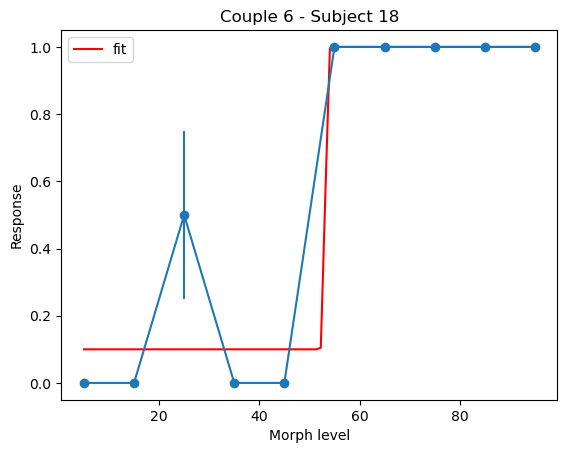

Fit failed for Couple 7 - Subject 18


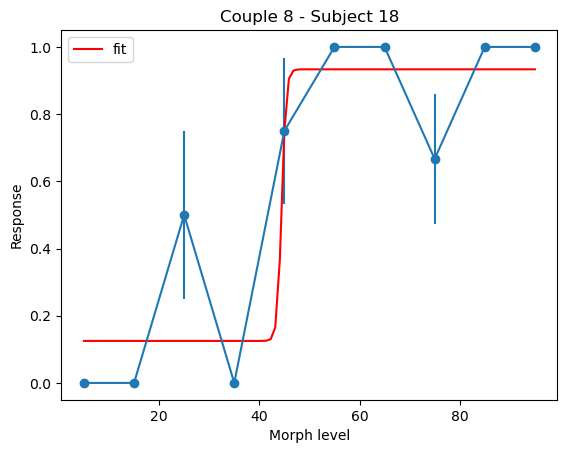

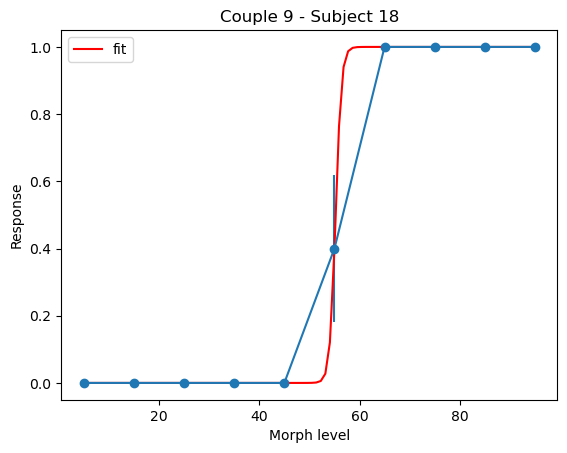

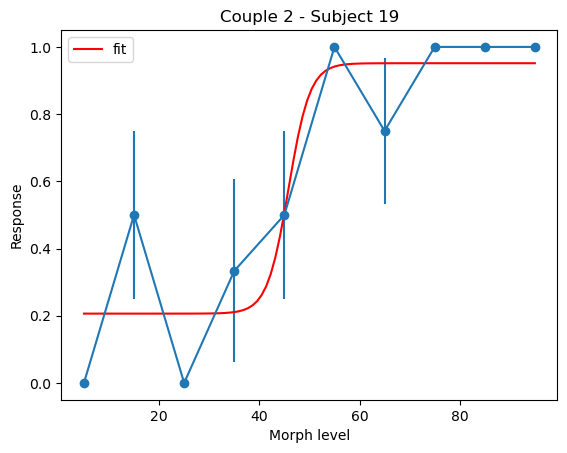

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


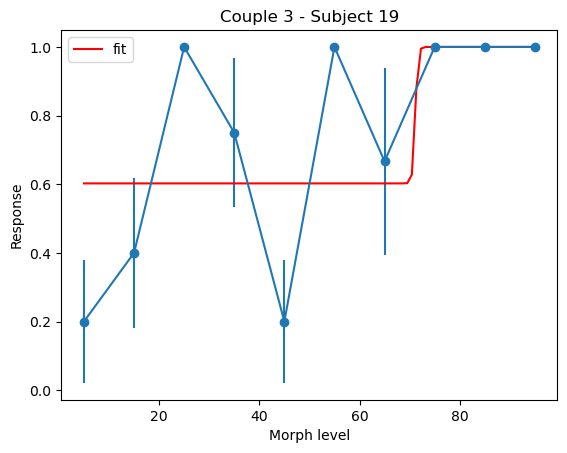

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


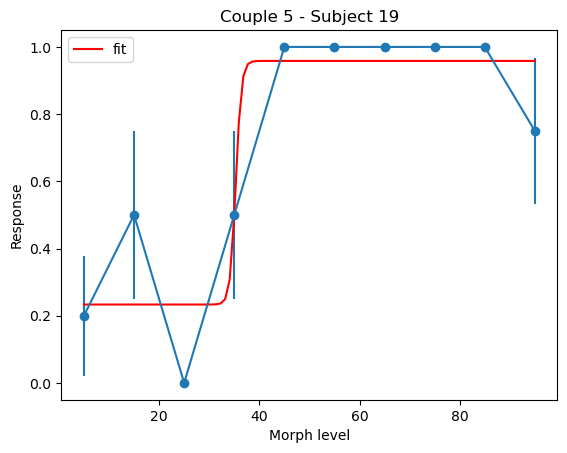

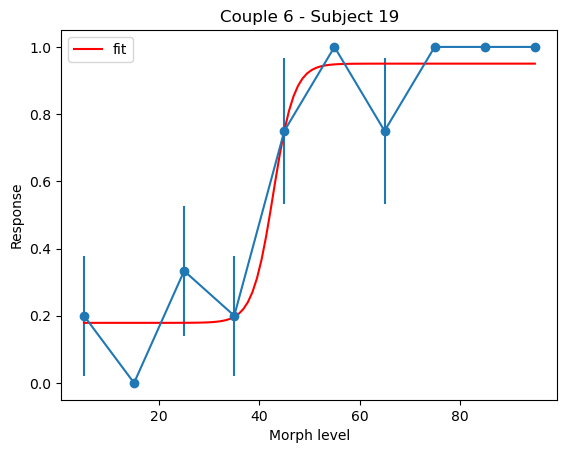

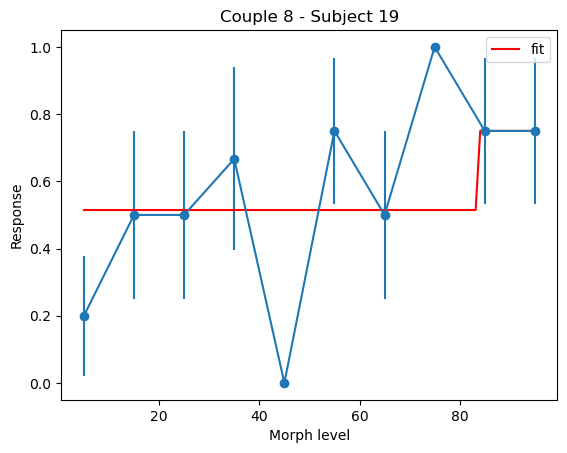

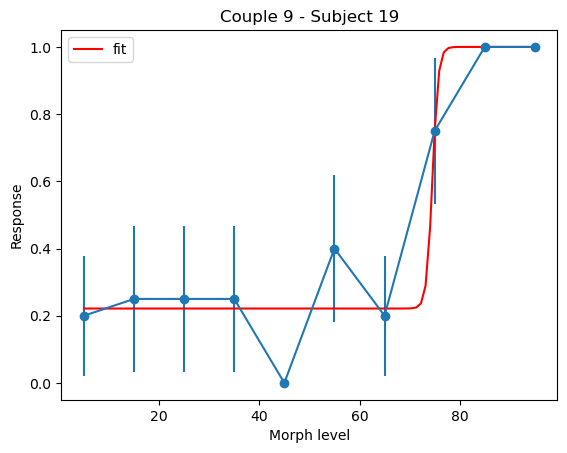

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


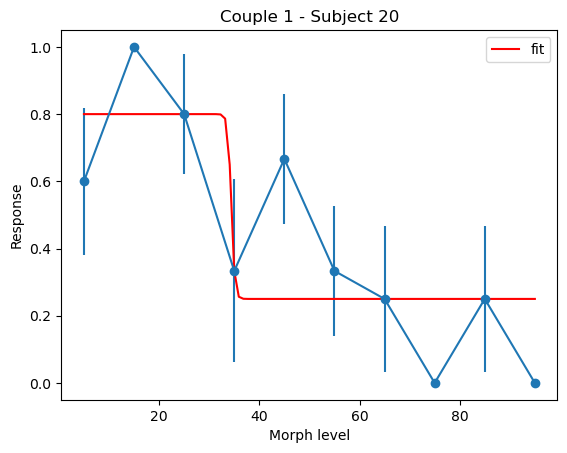

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


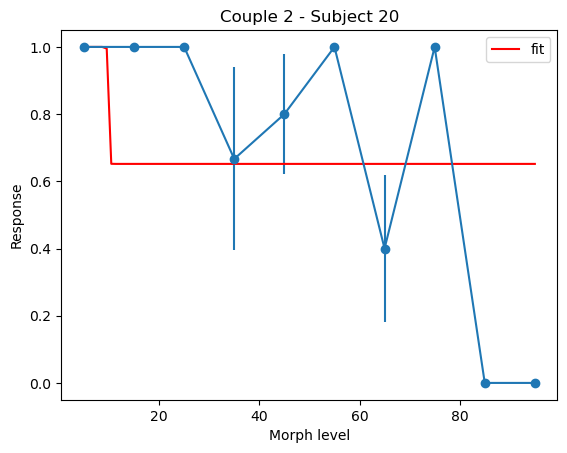

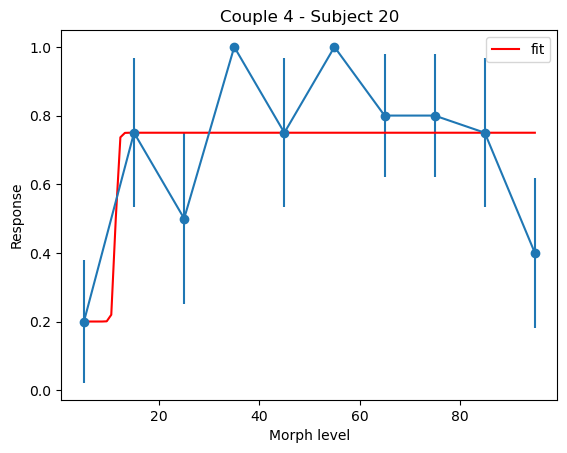

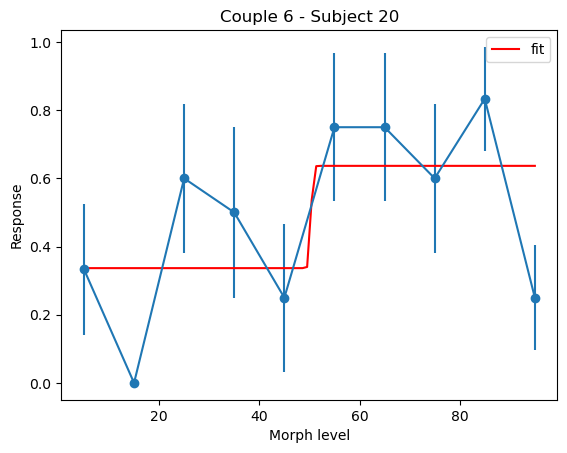

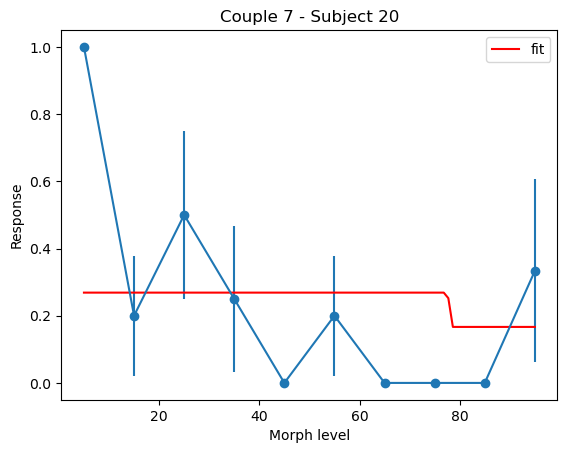

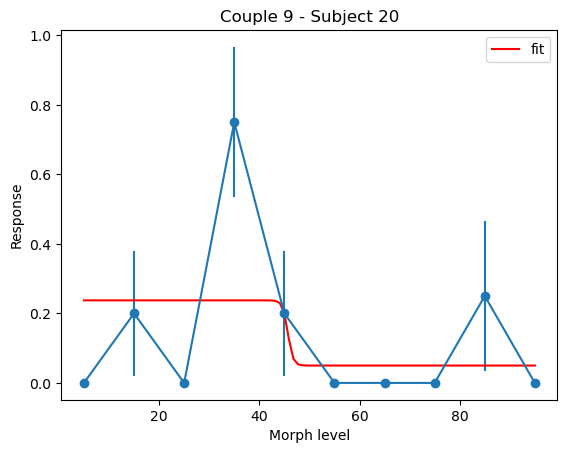

...

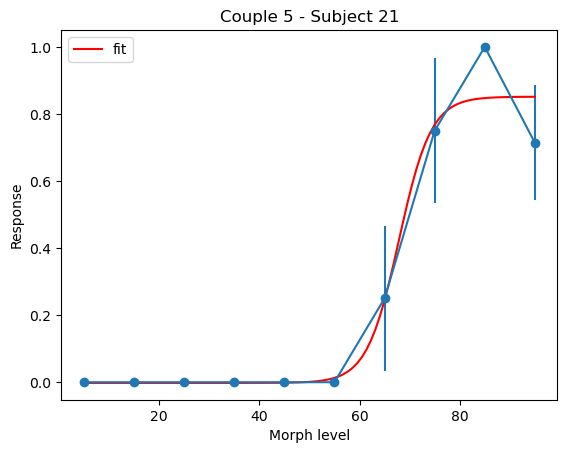

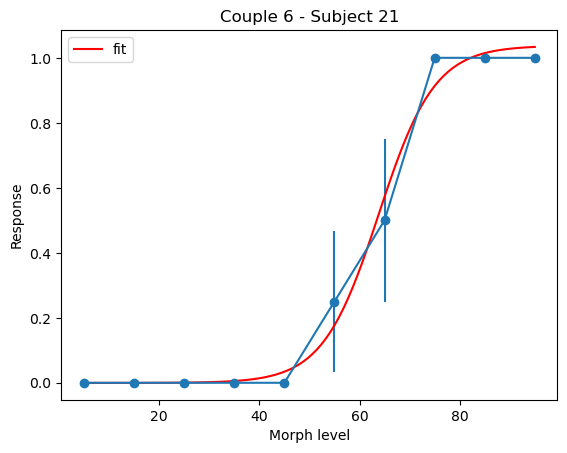

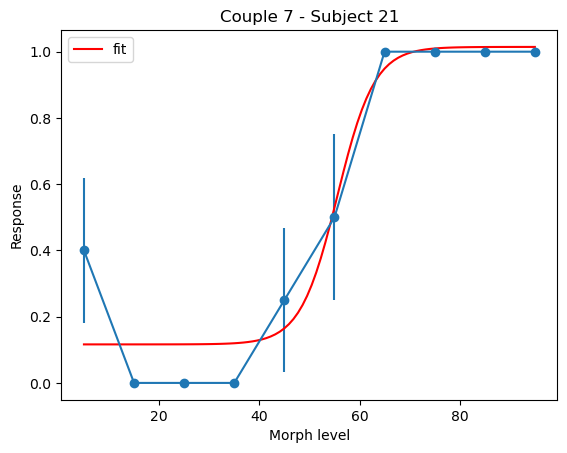

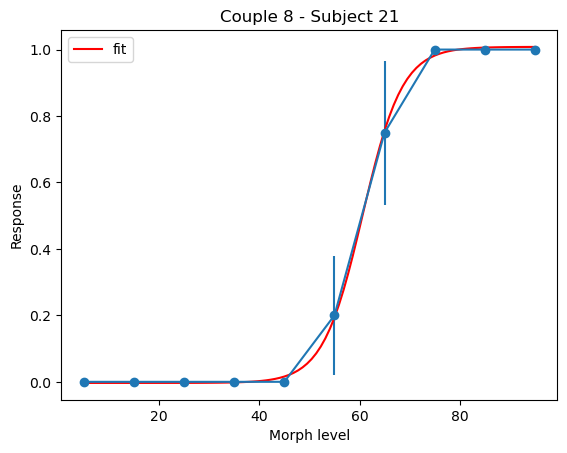

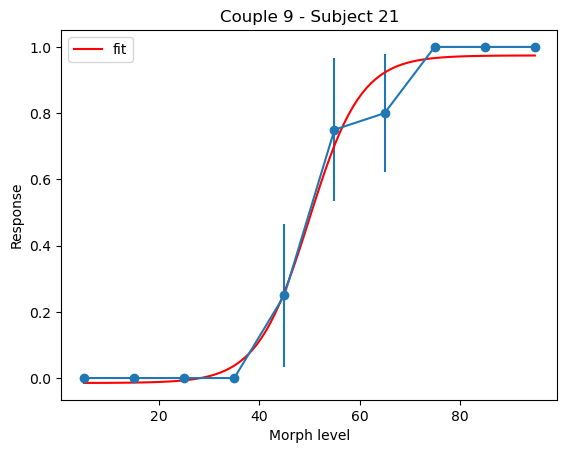

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


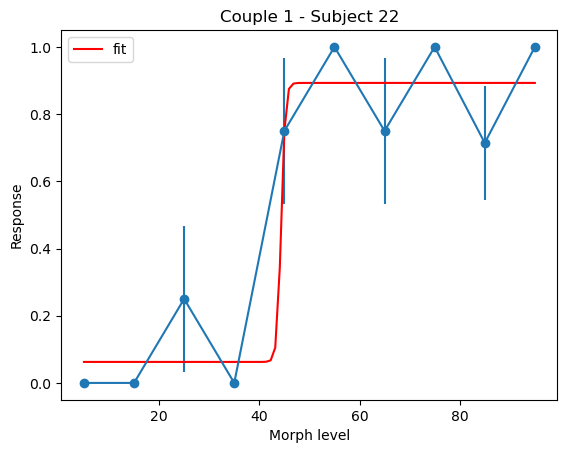

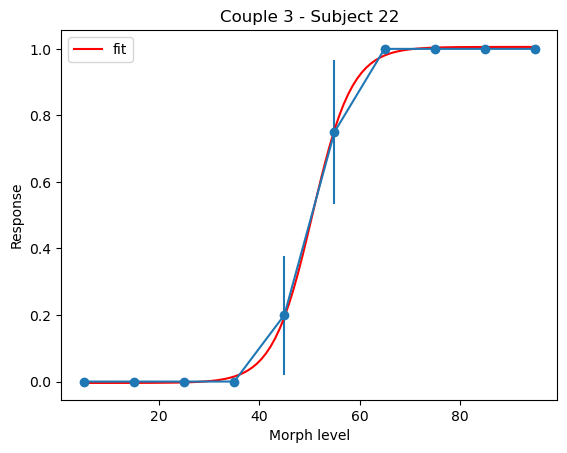

C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:49: RuntimeWarning: invalid value encountered in double_scalars
  diff_percentage = (max_value - min_value) / max_value * 100


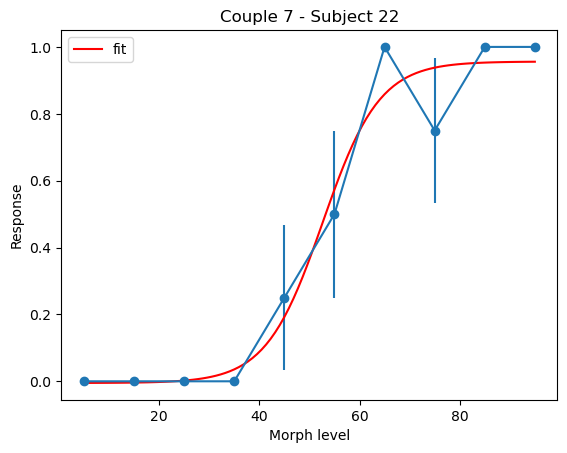

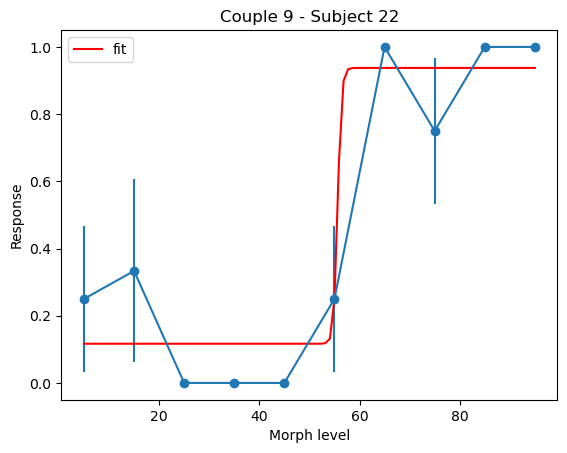

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:49: RuntimeWarning: invalid value encountered in double_scalars
  diff_percentage = (max_value - min_value) / max_value * 100


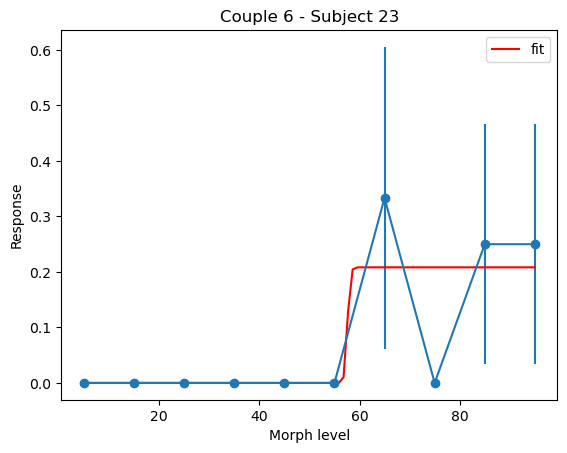

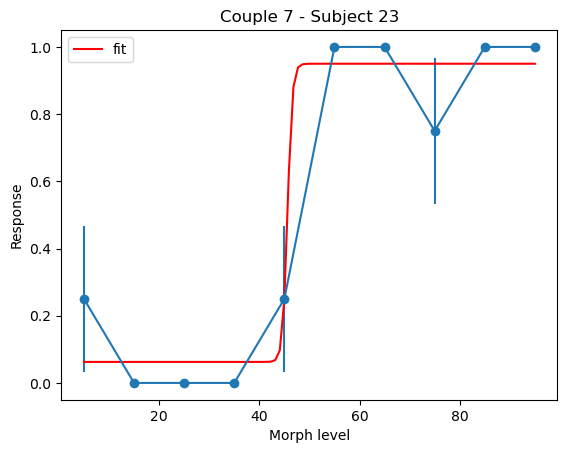

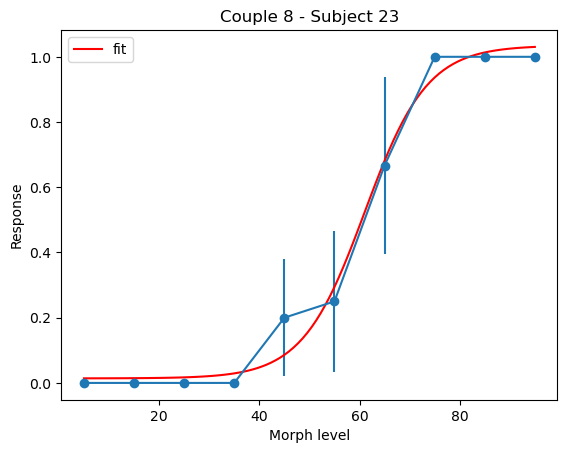

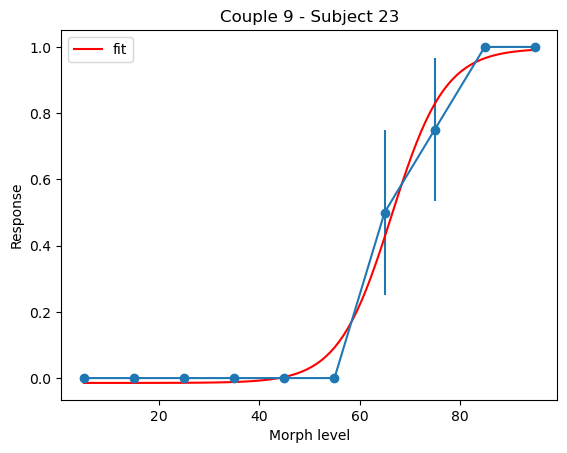

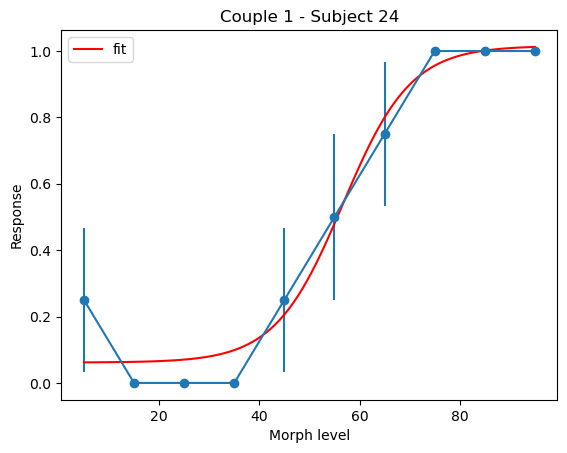

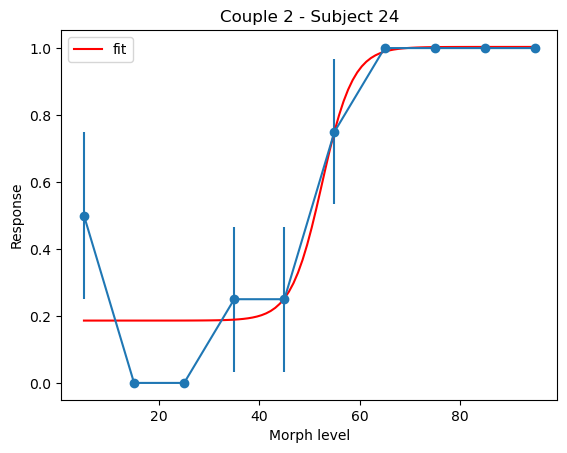

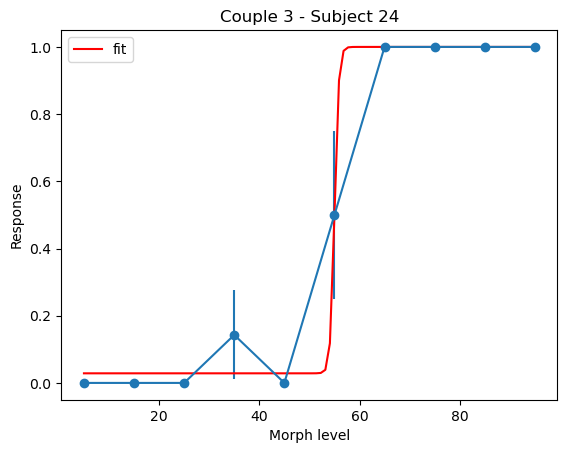

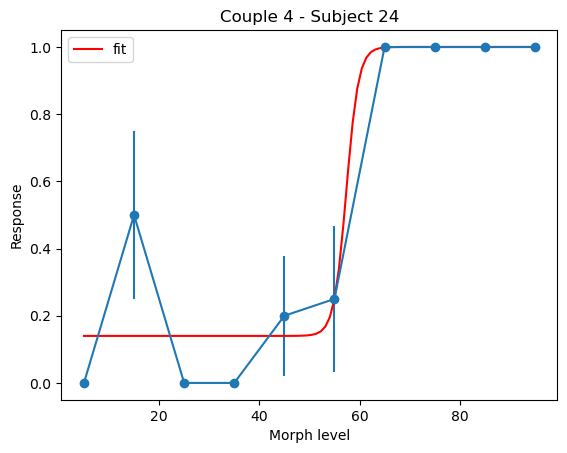

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b


Fit failed for Couple 5 - Subject 24


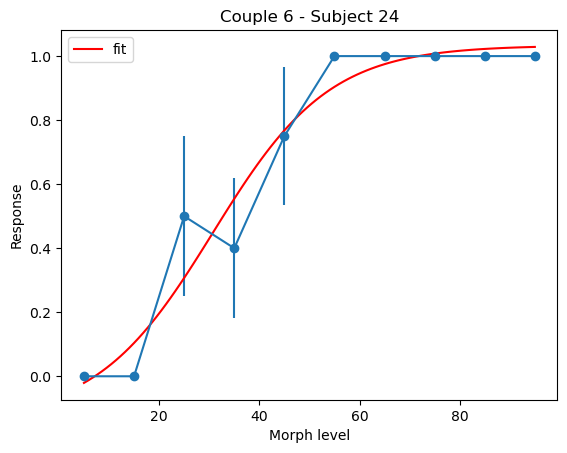

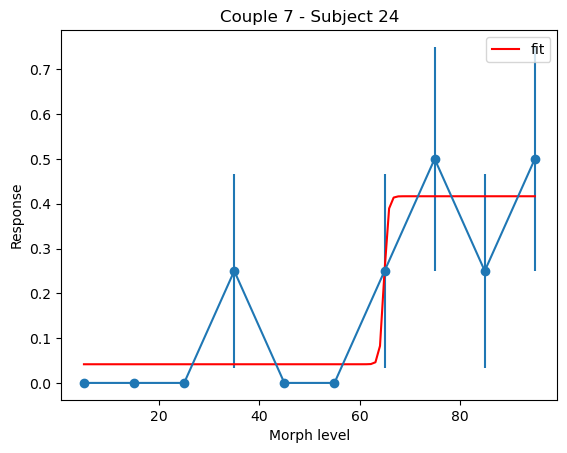

Fit failed for Couple 8 - Subject 24


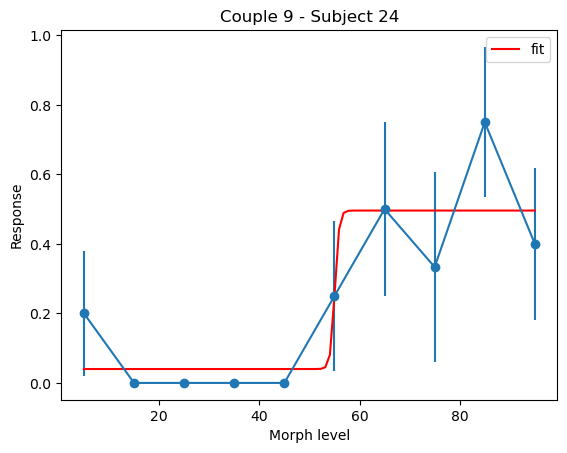

C:\Users\Sofiane\AppData\Local\Temp\ipykernel_80260\3482899831.py:7: RuntimeWarning: overflow encountered in exp
  y = L / (1 + np.exp(-k*(x-x0))) + b
C:\Users\Sofiane\anaconda3\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


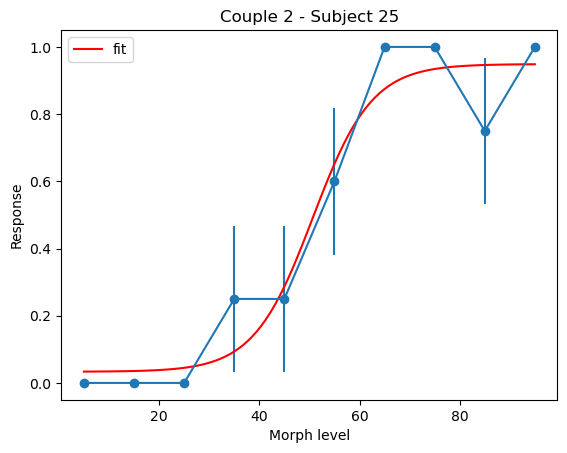

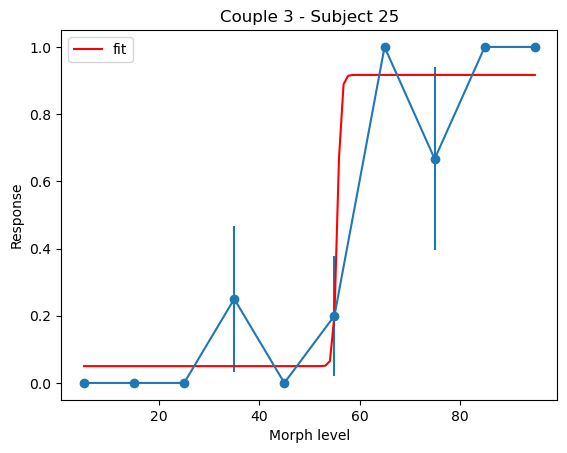

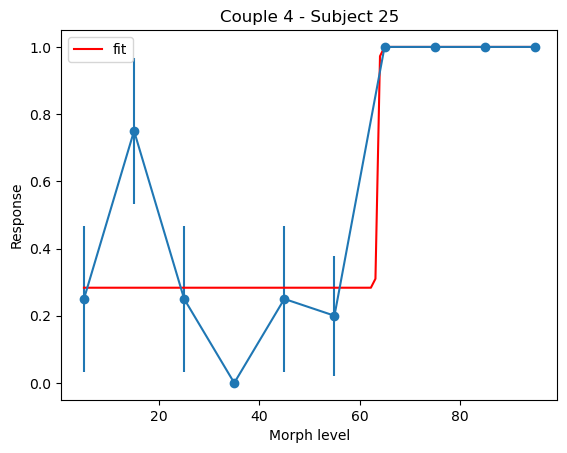

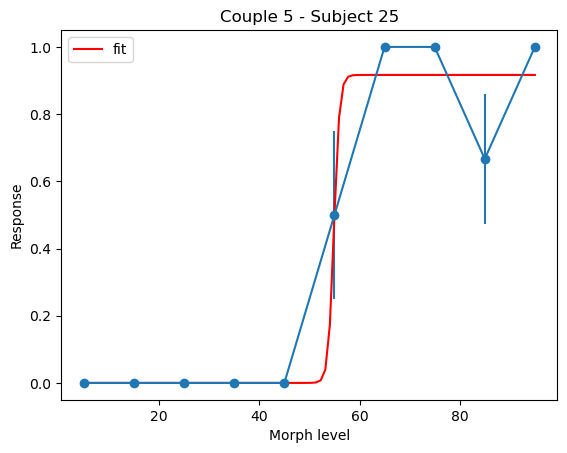

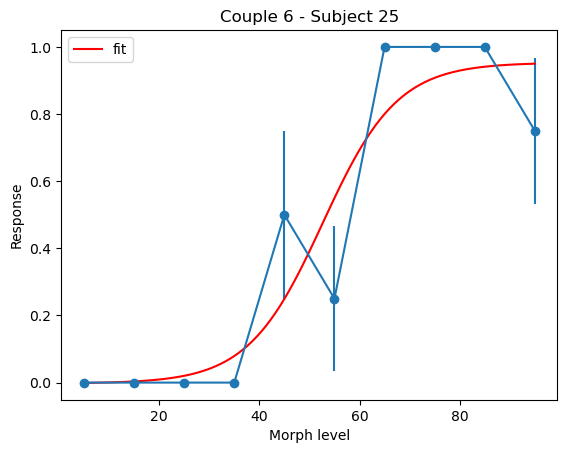

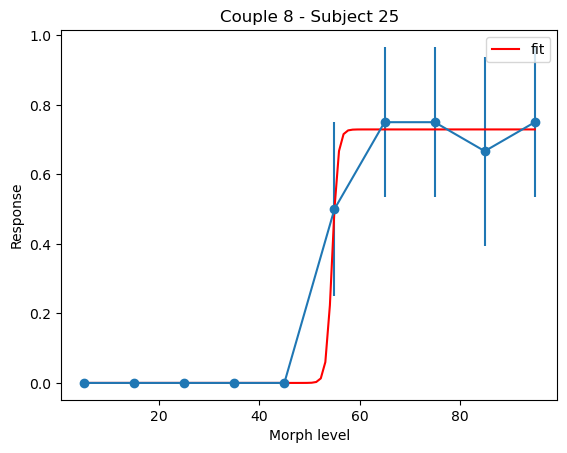

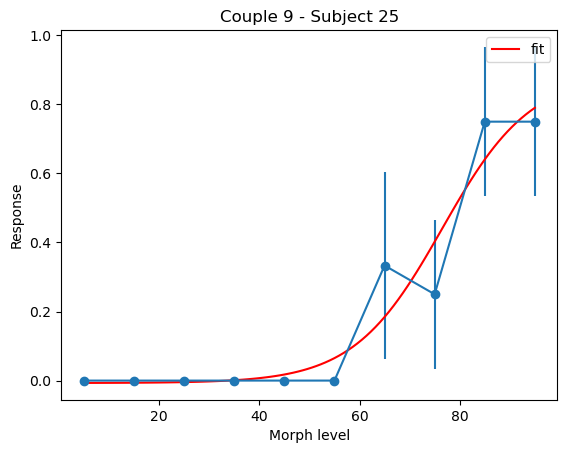

In [91]:
for subject in range(1, 26):
    view_results(subject=subject, run='all', return_data=False, do_plot=True)